# Github Repository Data Exploration  

In [11]:
from pathlib import Path 

read_in = 'dir/dir/dir/all_issues__riboviz_riboviz.xyz'

read_path = Path(read_in)

read_in_location = read_path.parent
read_in_filename = read_path.stem

print(read_in_location, read_in_filename)
#read_in.split("__")

#read_in.replace("_", "/")

dir/dir/dir all_issues__riboviz_riboviz


## Setup 

Ensure you are in the `coding-smart-github` conda environment and have the following packages in your environment:
```bash

```

### Github Authentication 

Create a classic access token via [Github Authentication Settings](https://docs.github.com/en/authentication/keeping-your-account-and-data-secure/creating-a-personal-access-token#creating-a-personal-access-token-classic) and create a file called `config.cfg` with the following content: 
```bash
[ACCESS]
token = <your-access-token>
```
Ensure you've pasted in your token, but leave `[ACCESS]` and `token = `.

### imports

In [1]:
import pandas as pd
from pandas import DatetimeIndex
pd.set_option('max_colwidth', 1000)

import numpy as np

import os
from os import path

import configparser

import requests

from github import Github

import datetime

from tqdm import tqdm

import matplotlib.pyplot as plt  
import seaborn as sns
import seaborn.objects as so

import json

import string

from pandas import DatetimeIndex

### github access

In [2]:
# set up github access token with github package: 

config = configparser.ConfigParser()
config.read('../config.cfg')
config.sections()

access_token = config['ACCESS']['token']
g = Github(access_token) 


In [3]:
import githubanalysis.processing.get_all_pages_issues as getallissues
import githubanalysis.processing.get_repo_connection as ghconn
import githubanalysis.processing.write_out_repo_data as writeout
import githubanalysis.analysis.calc_issue_close_time as calcclose
import githubanalysis.processing.get_repo_creation_date as createdate
import githubanalysis.analysis.calc_days_since_repo_creation as dayssince

import githubanalysis.processing.repo_name_clean as name_clean
#import githubanalysis.processing.write_out_repo_data as writeout
#import githubanalysis.processing.read_in_repo_data as readin

import githubanalysis.processing.get_issue_assignees as issuedevs
import githubanalysis.visualization.plot_repo_issues_data as plotissues
import githubanalysis.visualization.plot_repo_issues_counts_devs as plotissuedevs
import githubanalysis.processing.get_repo_creation_date as createdate
import githubanalysis.analysis.calc_days_since_repo_creation as dayssince
import githubanalysis.processing.get_release_dates as getreleases
import githubanalysis.processing.get_contributor_commits_stats as getcontributorstats
import githubanalysis.processing.get_all_pages_commits as getallcommits


#issuepages.get_all_pages_issues(repo_name='FlicAnderson/test-repo-no-issues', config_path='../config.cfg')

In [75]:
#repo_name='JuliaClimate/GeoRegions.jl'
repo_name="FlicAnderson/20230215-JournalClub-BestPractices"
#repo_name='riboviz/riboviz'
per_pg=100
config_path = '../../githubanalysis/config.cfg'

In [76]:
# create output dict to update with stats:
repo_stats = {}

# get repo_name gh connection:

repo_stats.update({"repo_name": repo_name})




repo_con = ghconn.get_repo_connection(repo_name, config_path, per_pg) 

languages = repo_con.get_languages().keys()

if 'Python' or 'C' or 'C++' or 'Shell' in languages:
    repo_stats.update({"repo_language": languages})
else:
    repo_stats.update({"repo_language": "other"})

    
    
    
from datetime import timezone 
import datetime 
    
# get age of repo
repo_age_days = dayssince.calc_days_since_repo_creation(
    datetime.datetime.now(timezone.utc).replace(tzinfo=timezone.utc),
    repo_name,
    since_date=None,
    return_in='whole_days',
     config_path=config_path
)
repo_stats.update({"repo_age_days": repo_age_days})

license_type = repo_con.get_license().license
repo_stats.update({"repo_license": license_type})




if hasattr(repo_con, 'has_issues') is True:

    closed_issues = getallissues.get_all_pages_issues(
        repo_name=repo_name,
        config_path=config_path, 
        per_pg=per_pg,
        issue_state='closed',
        verbose=True
    )  # get closed issues from all pages for given repo
    closed_issues = closed_issues.shape[0]
else:
    closed_issues = 0

repo_stats.update({"tickets": closed_issues})



import requests
from requests.adapters import HTTPAdapter, Retry

base_contributor_stats_url = f"https://api.github.com/repos/{repo_name}/stats/commit_activity"

s = requests.Session()
retries = Retry(total=5, backoff_factor=1, status_forcelist=[202, 502, 503, 504])
s.mount('https://', HTTPAdapter(max_retries=retries))

api_response = s.get(url=base_contributor_stats_url, timeout=10)
print(api_response)

total_commits_1_year = pd.DataFrame(api_response.json())['total'].sum()
repo_stats.update({"total_commits_1yr": total_commits_1_year})



base_commits_url = f"https://api.github.com/repos/{repo_name}/commits?per_page=1"
api_response = requests.get(base_commits_url)
if api_response.ok: 
    commit_links = api_response.links
    commit_links_last = commit_links['last']['url'].split("&page=")[1]
    total_commits = int(commit_links_last)

repo_stats.update({"total_commits": total_commits})


contribs_url = f"https://api.github.com/repos/{repo_name}/contributors?per_page=1"

api_response = requests.get(contribs_url)

if api_response.ok: 
    contrib_links = api_response.links
    contrib_links_last = contrib_links['last']['url'].split("&page=")[1]
    total_contributors = int(contrib_links_last)

repo_stats.update({"devs": total_contributors})

GH link opened
GH link opened
Total responses: 0
Shape of data: (0, 0)


AttributeError: 'DataFrame' object has no attribute 'state'

In [74]:
print(repo_stats)

{'repo_name': 'https://github.com/FlicAnderson/20230215-JournalClub-BestPractices'}


In [ ]:
    # return:
    # dict of repo_name stats:
    # repo_stats = {
    #     "repo_name": "repo_name",
    #     "devs": 0,
    #     "total_commits": 0,
    #     "total_commits_last_year": 0,
    #     "tickets": 0,
    #     "last_commit": "datetype",
    #     "repo_age_days": 0,
    #     "repo_license": "license",
    #     "repo_visibility": "visible",
    #     "repo_language": "python"
    # }

    all_stats
    
    # check ALL keys in repo_stats dict:
    try: 
        all x in repo_stats = TRUE
        print("yeah")
    except ValueError("not yeah")
    
    change default per_pg to 1 from 100; fix typo in PR related sort param; edit Retry() params to increase backoff factor and increase number of retries; actually fix repo_visibility logic; change name of 'tickets' to 'closed_tickets'; check all stats in stat_list with assertion. 

In [95]:
repo_name = "FlicAnderson/20230215-JournalClub-BestPractices"
per_pg=1
state='all'
sort='udpated'
direction='desc'
params_string = f"?per_pg={per_pg}&state={state}&sort={sort}&direction={direction}"

print(params_string)

PRs_url = f"https://api.github.com/repos/{repo_name}/pulls{params_string}"

api_response = requests.get(PRs_url)

if api_response.ok:
    print(api_response.ok)
    
    try: 
        assert len(api_response.json()) != 0, "No json"
        latest_PR_update = api_response.json()[0]['updated_at']  # 0th(1st) for latest update as sorted desc.
        print(latest_PR_update) 
            
    except:
        print("no json, therefore no PRs you see")

        
#     except: 
#         stop()
        
#     latest_PR_update = api_response.json()[0]['updated_at']  # 0th(1st) for latest update as sorted desc.
    
#     PR_links = api_response.links
#     #PR_links_last = PR_links['last']['url'].split("&page=")[1]
#     #total_PRs = int(PR_links_last)
    
#     print(api_response)
#     print(latest_PR_update)
    
#     date_format = '%Y-%m-%dT%H:%M:%S%z'
#     date_obj = datetime.strptime(latest_PR_update, date_format)
#     print(type(date_obj.tzinfo))    

?per_pg=1&state=all&sort=udpated&direction=desc
True
no json, therefore no PRs you see


In [38]:
per_pg=1
state='all'
params_string = f"?per_pg={per_pg}&state={state}"

print(params_string)

PRs_url = f"https://api.github.com/repos/{repo_name}/pulls{params_string}"

api_response = requests.get(PRs_url)

if api_response.ok:
    print(api_response.ok)
    
    PR_links = api_response.links
    #PR_links_last = PR_links['last']['url'].split("&page=")[1]
    #total_PRs = int(PR_links_last)
    
    print(api_response)
    #print(total_PRs)
    print(PR_links)
    
    #####
    """
    So it's giving 7 pages of 1 item per page, but the actual gbif/ipt shows 11 open and 163 PRs closed
    BUT the majority of these are tagged with 'bot', so perhaps don't show up in the API the same way?
    
    """
    

?per_pg=1&state=all
True
<Response [200]>
{}


In [61]:
update_date = api_response.json()[4]['updated_at']
print(update_date)
type(update_date)

2020-05-27T05:24:13Z


str

In [66]:
from datetime import datetime

date_str = update_date
date_format = '%Y-%m-%dT%H:%M:%S%z'

date_obj = datetime.strptime(date_str, date_format)
print(date_obj)

2020-05-27 05:24:13+00:00
UTC


In [40]:
dir(api_response)

['__attrs__',
 '__bool__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__enter__',
 '__eq__',
 '__exit__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__nonzero__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_content',
 '_content_consumed',
 '_next',
 'apparent_encoding',
 'close',
 'connection',
 'content',
 'cookies',
 'elapsed',
 'encoding',
 'headers',
 'history',
 'is_permanent_redirect',
 'is_redirect',
 'iter_content',
 'iter_lines',
 'json',
 'links',
 'next',
 'ok',
 'raise_for_status',
 'raw',
 'reason',
 'request',
 'status_code',
 'text',
 'url']

In [167]:
commits_url = f"https://github.com/repos/{repo_name}/commits"
api_response = s.get(url=commits, timeout=10)

In [7]:
dir(repo_con)

['CHECK_AFTER_INIT_FLAG',
 '_CompletableGithubObject__complete',
 '_CompletableGithubObject__completed',
 '_GithubObject__makeSimpleAttribute',
 '_GithubObject__makeSimpleListAttribute',
 '_GithubObject__makeTransformedAttribute',
 '_Repository__create_pull',
 '_Repository__create_pull_1',
 '_Repository__create_pull_2',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_allow_merge_commit',
 '_allow_rebase_merge',
 '_allow_squash_merge',
 '_archive_url',
 '_archived',
 '_assignees_url',
 '_blobs_url',
 '_branches_url',
 '_clone_url',
 '_collaborators_url',
 '_comments_url',
 '_commits_url',
 '_compare_url',
 '_completeIfNeeded',
 '_completeIfNotSet',
 '_contents_url',
 

In [47]:
repo_name = "riboviz/riboviz"

In [60]:
contribs_url = f"https://api.github.com/repos/{repo_name}/contributors?per_page=1"

api_response = requests.get(contribs_url)

print(api_response)
contrib_links = api_response.links
print(contrib_links)
contrib_links_last = contrib_links['last']['url'].split("&page=")[1]
total_contributors = int(contrib_links_last)
print(total_contributors)

<Response [200]>
{'next': {'url': 'https://api.github.com/repositories/184749972/contributors?per_page=1&page=2', 'rel': 'next'}, 'last': {'url': 'https://api.github.com/repositories/184749972/contributors?per_page=1&page=14', 'rel': 'last'}}
14


In [67]:
api_response.json()

[{'login': 'mikej888',
  'id': 2621549,
  'node_id': 'MDQ6VXNlcjI2MjE1NDk=',
  'avatar_url': 'https://avatars.githubusercontent.com/u/2621549?v=4',
  'gravatar_id': '',
  'url': 'https://api.github.com/users/mikej888',
  'html_url': 'https://github.com/mikej888',
  'followers_url': 'https://api.github.com/users/mikej888/followers',
  'following_url': 'https://api.github.com/users/mikej888/following{/other_user}',
  'gists_url': 'https://api.github.com/users/mikej888/gists{/gist_id}',
  'starred_url': 'https://api.github.com/users/mikej888/starred{/owner}{/repo}',
  'subscriptions_url': 'https://api.github.com/users/mikej888/subscriptions',
  'organizations_url': 'https://api.github.com/users/mikej888/orgs',
  'repos_url': 'https://api.github.com/users/mikej888/repos',
  'events_url': 'https://api.github.com/users/mikej888/events{/privacy}',
  'received_events_url': 'https://api.github.com/users/mikej888/received_events',
  'type': 'User',
  'site_admin': False,
  'contributions': 1927}

In [117]:
test = repo_con.get_stats_commit_activity()
len(test)

52

In [148]:
             
import logging
import requests
from requests.adapters import HTTPAdapter, Retry

base_contributor_stats_url = f"https://api.github.com/repos/{repo_name}/stats/commit_activity"
    #api_response = requests.get(url=base_contributor_stats_url, timeout=10)

logging.basicConfig(level=logging.DEBUG)

s = requests.Session()
retries = Retry(total=5, backoff_factor=1, status_forcelist=[202, 502, 503, 504])
s.mount('https://', HTTPAdapter(max_retries=retries))

api_response = s.get(url=base_contributor_stats_url, timeout=10)
print(api_response)

pd.DataFrame(api_response.json())['total'].sum()

DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): api.github.com:443
DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repos/gbif/ipt/stats/commit_activity HTTP/1.1" 202 2
DEBUG:urllib3.util.retry:Incremented Retry for (url='/repos/gbif/ipt/stats/commit_activity'): Retry(total=4, connect=None, read=None, redirect=None, status=None)
DEBUG:urllib3.connectionpool:Retry: /repos/gbif/ipt/stats/commit_activity
DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repos/gbif/ipt/stats/commit_activity HTTP/1.1" 202 2
DEBUG:urllib3.util.retry:Incremented Retry for (url='/repos/gbif/ipt/stats/commit_activity'): Retry(total=3, connect=None, read=None, redirect=None, status=None)
DEBUG:urllib3.connectionpool:Retry: /repos/gbif/ipt/stats/commit_activity
DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repos/gbif/ipt/stats/commit_activity HTTP/1.1" 200 683


<Response [200]>


In [149]:
type(api_response)

requests.models.Response

In [152]:
api_response.json()

[{'days': [0, 0, 0, 0, 2, 14, 1], 'total': 17, 'week': 1667088000},
 {'days': [0, 0, 0, 0, 2, 2, 0], 'total': 4, 'week': 1667692800},
 {'days': [0, 1, 3, 0, 9, 4, 3], 'total': 20, 'week': 1668297600},
 {'days': [3, 5, 6, 1, 4, 8, 4], 'total': 31, 'week': 1668902400},
 {'days': [1, 9, 1, 1, 1, 6, 0], 'total': 19, 'week': 1669507200},
 {'days': [0, 5, 0, 1, 2, 1, 0], 'total': 9, 'week': 1670112000},
 {'days': [0, 2, 3, 2, 5, 1, 0], 'total': 13, 'week': 1670716800},
 {'days': [0, 0, 4, 3, 1, 0, 0], 'total': 8, 'week': 1671321600},
 {'days': [0, 0, 3, 2, 2, 1, 0], 'total': 8, 'week': 1671926400},
 {'days': [0, 2, 0, 0, 1, 6, 0], 'total': 9, 'week': 1672531200},
 {'days': [0, 3, 1, 10, 1, 0, 0], 'total': 15, 'week': 1673136000},
 {'days': [0, 0, 0, 0, 0, 0, 0], 'total': 0, 'week': 1673740800},
 {'days': [0, 0, 0, 1, 10, 5, 0], 'total': 16, 'week': 1674345600},
 {'days': [0, 12, 13, 0, 9, 0, 0], 'total': 34, 'week': 1674950400},
 {'days': [0, 6, 1, 0, 0, 1, 1], 'total': 9, 'week': 1675555200

In [158]:
pd.DataFrame(api_response.json())['total'].sum()

467

In [130]:
type(test[0])

github.StatsCommitActivity.StatsCommitActivity

In [98]:
type(repo_con.last_modified)

str

In [105]:
repo_con.updated_at

datetime.datetime(2023, 9, 12, 13, 8, 12)

In [17]:
repo_con.get_languages()

{'Python': 477058,
 'R': 233637,
 'Nextflow': 55440,
 'Shell': 12596,
 'Makefile': 1138,
 'Batchfile': 795}

In [28]:
'Python' in repo_con.get_languages().keys()

True

In [32]:
lingos = repo_con.get_languages().keys()
lingos

dict_keys

In [51]:
dir(repo_con.get_license())

['CHECK_AFTER_INIT_FLAG',
 '_CompletableGithubObject__complete',
 '_CompletableGithubObject__completed',
 '_GithubObject__makeSimpleAttribute',
 '_GithubObject__makeSimpleListAttribute',
 '_GithubObject__makeTransformedAttribute',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_completeIfNeeded',
 '_completeIfNotSet',
 '_content',
 '_download_url',
 '_encoding',
 '_git_url',
 '_headers',
 '_html_url',
 '_initAttributes',
 '_license',
 '_makeBoolAttribute',
 '_makeClassAttribute',
 '_makeDatetimeAttribute',
 '_makeDictAttribute',
 '_makeDictOfStringsToClassesAttribute',
 '_makeFloatAttribute',
 '_makeIntAttribute',
 '_makeListOfClassesAttribute',
 '_makeListOfDictsAtt

In [60]:
dir(repo_con.get_license().license)

['CHECK_AFTER_INIT_FLAG',
 '_CompletableGithubObject__complete',
 '_CompletableGithubObject__completed',
 '_GithubObject__makeSimpleAttribute',
 '_GithubObject__makeSimpleListAttribute',
 '_GithubObject__makeTransformedAttribute',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_body',
 '_completeIfNeeded',
 '_completeIfNotSet',
 '_conditions',
 '_description',
 '_headers',
 '_html_url',
 '_implementation',
 '_initAttributes',
 '_key',
 '_limitations',
 '_makeBoolAttribute',
 '_makeClassAttribute',
 '_makeDatetimeAttribute',
 '_makeDictAttribute',
 '_makeDictOfStringsToClassesAttribute',
 '_makeFloatAttribute',
 '_makeIntAttribute',
 '_makeListOfClassesAttribute',
 '_

In [63]:
repo_con.get_license().license.permissions

['commercial-use',
 'modifications',
 'distribution',
 'patent-use',
 'private-use']

In [5]:
all_commits = getallcommits.get_all_pages_commits(repo_name, config_path='../../githubanalysis/config.cfg', per_pg=100, verbose=True)

GH link opened
Total responses: 2730
Shape of data: (2730, 9)
Commit columns: Index(['sha', 'node_id', 'commit', 'url', 'html_url', 'comments_url', 'author',
       'committer', 'parents'],
      dtype='object')
                                        sha  \
0  a2ebaa7dac383e6ce0972626bf57fdba105d1780   
1  7084666e25e3562a04fe9d93203582b63cb8cb3c   
2  6a527bba752e6505bd752ecdb3a6b1884c0e5ecc   
3  dca505a7fa9040d7ef5ee62d28634dda6419c74f   
4  ea3c5f11d4819118cd610fc72edbb4e9a3626fe9   

                                                                 node_id  \
0  C_kwDOCwMPlNoAKGEyZWJhYTdkYWMzODNlNmNlMDk3MjYyNmJmNTdmZGJhMTA1ZDE3ODA   
1  C_kwDOCwMPlNoAKDcwODQ2NjZlMjVlMzU2MmEwNGZlOWQ5MzIwMzU4MmI2M2NiOGNiM2M   
2  C_kwDOCwMPlNoAKDZhNTI3YmJhNzUyZTY1MDViZDc1MmVjZGIzYTZiMTg4NGMwZTVlY2M   
3  C_kwDOCwMPlNoAKGRjYTUwNWE3ZmE5MDQwZDdlZjVlZTYyZDI4NjM0ZGRhNjQxOWM3NGY   
4  C_kwDOCwMPlNoAKGVhM2M1ZjExZDQ4MTkxMThjZDYxMGZjNzJlZGJiNGU5YTM2MjZmZTk   

                                                

In [6]:
all_commits.columns

Index(['sha', 'node_id', 'commit', 'url', 'html_url', 'comments_url', 'author',
       'committer', 'parents', 'repo_name'],
      dtype='object')

In [24]:
all_commits.commit[0].get('message')


'Merge pull request #452 from riboviz/develop\n\nDevelop'

In [22]:
all_commits.commit.()

AttributeError: 'Series' object has no attribute 'author'

In [28]:
dir(commits)

['T',
 '_AXIS_LEN',
 '_AXIS_ORDERS',
 '_AXIS_TO_AXIS_NUMBER',
 '_HANDLED_TYPES',
 '__abs__',
 '__add__',
 '__and__',
 '__annotations__',
 '__array__',
 '__array_priority__',
 '__array_ufunc__',
 '__array_wrap__',
 '__bool__',
 '__class__',
 '__contains__',
 '__copy__',
 '__dataframe__',
 '__deepcopy__',
 '__delattr__',
 '__delitem__',
 '__dict__',
 '__dir__',
 '__divmod__',
 '__doc__',
 '__eq__',
 '__finalize__',
 '__floordiv__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getitem__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__iadd__',
 '__iand__',
 '__ifloordiv__',
 '__imod__',
 '__imul__',
 '__init__',
 '__init_subclass__',
 '__invert__',
 '__ior__',
 '__ipow__',
 '__isub__',
 '__iter__',
 '__itruediv__',
 '__ixor__',
 '__le__',
 '__len__',
 '__lt__',
 '__matmul__',
 '__mod__',
 '__module__',
 '__mul__',
 '__ne__',
 '__neg__',
 '__new__',
 '__nonzero__',
 '__or__',
 '__pos__',
 '__pow__',
 '__radd__',
 '__rand__',
 '__rdivmod__',
 '__reduce__',
 '__reduce_ex_

In [34]:
commits.author

0                   {'login': 'mikej888', 'id': 2621549, 'node_id': 'MDQ6VXNlcjI2MjE1NDk=', 'avatar_url': 'https://avatars.githubusercontent.com/u/2621549?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/mikej888', 'html_url': 'https://github.com/mikej888', 'followers_url': 'https://api.github.com/users/mikej888/followers', 'following_url': 'https://api.github.com/users/mikej888/following{/other_user}', 'gists_url': 'https://api.github.com/users/mikej888/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/mikej888/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/mikej888/subscriptions', 'organizations_url': 'https://api.github.com/users/mikej888/orgs', 'repos_url': 'https://api.github.com/users/mikej888/repos', 'events_url': 'https://api.github.com/users/mikej888/events{/privacy}', 'received_events_url': 'https://api.github.com/users/mikej888/received_events', 'type': 'User', 'site_admin': False}
1                   {'login': 'mikej888

In [14]:
commits['commit_date'] = commits[['commit']].apply(lambda x: [x.get('author') for x in x]).apply(lambda x: [x.get('date') for x in x])
#commits['commit_date'] = commits[['commit_date']].apply(lambda x: [x.get('date') for x in x])

In [20]:
type(commits['commit_date'][0])

str

In [8]:
commits.head()


,sha,node_id,commit,url,html_url,comments_url,author,committer,parents,commit_date,commit_message,repo_name
0,a2ebaa7dac383e6ce0972626bf57fdba105d1780,C_kwDOCwMPlNoAKGEyZWJhYTdkYWMzODNlNmNlMDk3MjYyNmJmNTdmZGJhMTA1ZDE3ODA,"{'author': {'name': 'Michael Jackson', 'email': 'michaelj@epcc.ed.ac.uk', 'date': '2021-12-17T12:36:35Z'}, 'committer': {'name': 'GitHub', 'email': 'noreply@github.com', 'date': '2021-12-17T12:36:35Z'}, 'message': 'Merge pull request #452 from riboviz/develop Develop', 'tree': {'sha': '1738b90bd767990019a9145ff16e4e5c5a39f83f', 'url': 'https://api.github.com/repos/riboviz/riboviz/git/trees/1738b90bd767990019a9145ff16e4e5c5a39f83f'}, 'url': 'https://api.github.com/repos/riboviz/riboviz/git/commits/a2ebaa7dac383e6ce0972626bf57fdba105d1780', 'comment_count': 0, 'verification': {'verified': True, 'reason': 'valid', 'signature': '-----BEGIN PGP SIGNATURE----- wsBcBAABCAAQBQJhvIRTCRBK7hj4Ov3rIwAAaAsIAHcpq8rvFy9dCXrbIxDM6k/2 l1b50Mo0+enuIsT9zyOVbpWD8Zm1OpON234X0mXast1LD3MSjgwoi1CpgFEvpXgB +NdM39Luhdt3NrJHQcz51EYZOTScHOC9UnRGjgg77ET8MsvNmj9p4Wab1Mf1H1my Bs0UqPsKKAwT/9LU3XEXw2VHunuXKmqDXWYQaZ3qvLuFBWmvyUf0/OUFZwJo8MQS loCihgZs8HuvxxzrGepFVzneAy1WTCMONVBKVu6m0aSRiKXtxSaWcj8U4Exo699P cwSxLP...",https://api.github.com/repos/riboviz/riboviz/commits/a2ebaa7dac383e6ce0972626bf57fdba105d1780,https://github.com/riboviz/riboviz/commit/a2ebaa7dac383e6ce0972626bf57fdba105d1780,https://api.github.com/repos/riboviz/riboviz/commits/a2ebaa7dac383e6ce0972626bf57fdba105d1780/comments,"{'login': 'mikej888', 'id': 2621549, 'node_id': 'MDQ6VXNlcjI2MjE1NDk=', 'avatar_url': 'https://avatars.githubusercontent.com/u/2621549?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/mikej888', 'html_url': 'https://github.com/mikej888', 'followers_url': 'https://api.github.com/users/mikej888/followers', 'following_url': 'https://api.github.com/users/mikej888/following{/other_user}', 'gists_url': 'https://api.github.com/users/mikej888/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/mikej888/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/mikej888/subscriptions', 'organizations_url': 'https://api.github.com/users/mikej888/orgs', 'repos_url': 'https://api.github.com/users/mikej888/repos', 'events_url': 'https://api.github.com/users/mikej888/events{/privacy}', 'received_events_url': 'https://api.github.com/users/mikej888/received_events', 'type': 'User', 'site_admin': False}","{'login': 'web-flow', 'id': 19864447, 'node_id': 'MDQ6VXNlcjE5ODY0NDQ3', 'avatar_url': 'https://avatars.githubusercontent.com/u/19864447?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/web-flow', 'html_url': 'https://github.com/web-flow', 'followers_url': 'https://api.github.com/users/web-flow/followers', 'following_url': 'https://api.github.com/users/web-flow/following{/other_user}', 'gists_url': 'https://api.github.com/users/web-flow/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/web-flow/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/web-flow/subscriptions', 'organizations_url': 'https://api.github.com/users/web-flow/orgs', 'repos_url': 'https://api.github.com/users/web-flow/repos', 'events_url': 'https://api.github.com/users/web-flow/events{/privacy}', 'received_events_url': 'https://api.github.com/users/web-flow/received_events', 'type': 'User', 'site_admin': False}","[{'sha': '50825af920db93994a2b2185201f10a1f78487b5', 'url': 'https://api.github.com/repos/riboviz/riboviz/commits/50825af920db93994a2b2185201f10a1f78487b5', 'html_url': 'https://github.com/riboviz/riboviz/commit/50825af920db93994a2b2185201f10a1f78487b5'}, {'sha': '7084666e25e3562a04fe9d93203582b63cb8cb3c', 'url': 'https://api.github.com/repos/riboviz/riboviz/commits/7084666e25e3562a04fe9d93203582b63cb8cb3c', 'html_url': 'https://github.com/riboviz/riboviz/commit/7084666e25e3562a04fe9d93203582b63cb8cb3c'}]",None,Merge pull request #452 from riboviz/develop\n\nDevelop,riboviz/riboviz
1,7084666e25e3562a04f

In [46]:
import githubanalysis.processing.get_repo_connection as ghconnect

repo_con = ghconnect.get_repo_connection(repo_name, config_path='../../githubanalysis/config.cfg', per_pg=per_pg)  # create gh repo object to given repo
    # contains:  #ghlink = ghauth.setup_github_auth() with config path default to '../config' & per_page=100

    # create empty list for commit data:
store_pgs = []

    # loop through pages of commit data, append to list
for page in repo_con.get_commits():
    store_pgs.append(page._rawData)

#if verbose:
print("Total responses:", len(store_pgs))


DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): api.github.com:443


GH link opened


DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repos/gbif/ipt HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repos/gbif/ipt {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:37 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"40ba224b36bc9a440aa6a2dfae770e14018f1ada54f0b3f9499a78231cf34d74"', 'last-modified': 'Tue, 18 Jul 2023 19:16:27 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': 'repo', 'github-authentication-token-expiration': '2023-09-10 14:06:52 UTC', 'x-github-media-type': 'github.v3; format=json', 'x-git

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=2 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=2 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:38 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"8bbdfd769e48cf28370467c402588c9f65db601fff77df9d70d9627fb41d1c4a"', 'last-modified': 'Tue, 14 Mar 2023 10:09:40 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14:0

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=3 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=3 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:38 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"6f5ab08e1e184664ed328368114dd902cac12c332cbc2ddf6a2e8a8bf396a413"', 'last-modified': 'Mon, 30 Jan 2023 08:48:02 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14:0

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=4 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=4 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:39 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"46f16977a61c94f4ef07cf5a0b4d431c1bd27e381f3d8a96e85037a960c4c1aa"', 'last-modified': 'Mon, 28 Nov 2022 08:27:33 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14:0

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=5 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=5 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:39 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"3c186f003f598f97202336cd7822d159a4e21e979e9aff3d6f511fd689e93dfb"', 'last-modified': 'Mon, 17 Oct 2022 13:59:51 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14:0

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=6 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=6 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:39 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"97a0b77fbbb2c0b024904aceb1089833ab86133bdaff077b8e28438cefa712e2"', 'last-modified': 'Wed, 03 Aug 2022 21:37:47 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14:0

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=7 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=7 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:40 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"6f8ceeadfa81fbc08726555af0e5886a93a7e38140a7c2c903a479ca787dd256"', 'last-modified': 'Fri, 24 Jun 2022 08:48:37 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14:0

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=8 HTTP/1.1" 200 None
IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=9 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=9 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:41 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Acce

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=10 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=10 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:41 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"4ea5aab7584f88ad669ad071f1f7bedbc70eaadb9bc61bef56ed8dc2e800a0a1"', 'last-modified': 'Thu, 27 Jan 2022 11:09:43 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=11 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=11 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:41 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"daf67b606af11b990b2ee48f91eaab6a4637730252392cff5a5cef8ca6becefe"', 'last-modified': 'Fri, 26 Nov 2021 21:33:08 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=12 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=12 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:42 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"4579648863b3b0c85ae41014076662df3fb40ea976d3582c04951b36a10817d9"', 'last-modified': 'Sun, 17 Oct 2021 22:18:45 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=13 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=13 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:42 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"ac937a50d19ab64d0e1405c14d0397a7a0dfefd4f6cffa14638ee9183cfb62c1"', 'last-modified': 'Tue, 31 Aug 2021 07:42:39 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=14 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=14 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:43 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"ebec30fb66b7d317a61f6e63fe825db2b6ecd704f49dc8a20842295a0c023553"', 'last-modified': 'Thu, 15 Jul 2021 10:35:37 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=15 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=15 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:43 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"5f5f3d8a2df6b8af6e5efcfe496f2f37241c48cd0ca016dab22b209e80859430"', 'last-modified': 'Mon, 28 Jun 2021 11:11:50 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=16 HTTP/1.1" 200 None
IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=17 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=17 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:44 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'A

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=18 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=18 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:44 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"bf332f5ffd400f358de8c07260259cfb3505be35fc42149c51b1495e96aff16f"', 'last-modified': 'Fri, 04 Jun 2021 21:56:11 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=19 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=19 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:45 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"6e688d1c1c987db4d6cc01b6e58499e1eb16c1709cb4bae7fe8b5cf54a7cdd92"', 'last-modified': 'Mon, 26 Apr 2021 20:53:37 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=20 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=20 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:46 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"d1a019fed68706d684b4014b6703219f4a22db4b46fa5c8a545b97d42d77c9b8"', 'last-modified': 'Wed, 07 Apr 2021 20:17:05 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=21 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=21 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:46 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"a4f27afb53de43433a0542038df7c4136caba4d357d95c8384293b6c4e323e3e"', 'last-modified': 'Thu, 11 Mar 2021 21:05:38 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=22 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=22 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:47 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"4057ab01012e83ac445d42e948648437de84d06e18fbe2998b13e44f64d6f546"', 'last-modified': 'Tue, 08 Sep 2020 11:26:32 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=23 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=23 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:47 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"0c1eec26c85f4195bbfc3fa17d392a4a842d7e22e7afb3b818ecda32619e953b"', 'last-modified': 'Fri, 19 Jul 2019 14:21:17 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=24 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=24 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:47 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"cebed671fe20c046fc80df712f32c0e58292882fb27eeb98a90ee8ae8f5941e4"', 'last-modified': 'Thu, 12 Jul 2018 14:30:25 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=25 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=25 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:48 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"6ce339d1723ccce04411309a8f7f058d6206025f7965af5dbdf9f4bcac828e5d"', 'last-modified': 'Fri, 13 Apr 2018 12:13:27 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=26 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=26 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:48 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"ea67e82c869fbc663f76a087ac4935f97a47738b068da38533baa2ec9976c52d"', 'last-modified': 'Mon, 13 Nov 2017 12:44:52 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=27 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=27 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:49 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"fde0a3d1ccf57cbc2eb22e413e895168802a35458d7700fa1ba481665832ecb5"', 'last-modified': 'Wed, 04 Oct 2017 14:37:11 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=28 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=28 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:49 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"74ca0131691968ce0b846601852698bcc1b39b11e4018aa55eb21a836b88c167"', 'last-modified': 'Tue, 20 Jun 2017 13:39:29 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=29 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=29 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:50 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"2c7f9f9425a32dc5446b1b8f157edd38699ed90b814400e86a2560f02ba1262d"', 'last-modified': 'Tue, 09 May 2017 17:14:01 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=30 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=30 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:50 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"a747d32d77d936ecea6327fa6c0923f78fa516aa345c45844d99da5df76c0f76"', 'last-modified': 'Tue, 14 Mar 2017 12:14:32 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=31 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=31 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:50 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"a38606e406d52598a6ae70db635fbcfcab1734bfcf052f78a7a815f23bb1b4a6"', 'last-modified': 'Tue, 03 Jan 2017 09:38:20 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=32 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=32 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:51 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"1a3514dcf65a07867ce692100da31b4d34e8e98a86ff0b0edaa602eeb9110b55"', 'last-modified': 'Wed, 23 Nov 2016 14:59:52 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=33 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=33 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:51 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"48aba555d3868f8ab4c25912bfcafbeda266528faddafc245f7705d4270f0213"', 'last-modified': 'Tue, 04 Oct 2016 10:07:52 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=34 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=34 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:52 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"2605fbb8209458af90b8ee5dab8c57619e73525e3825377ffee9b2b5e60f7b9b"', 'last-modified': 'Tue, 13 Sep 2016 07:17:49 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=35 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=35 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:52 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"8cf1c26dd6c48875b4cd55191de81f96a85278c5558497b0d66ddea00a2e60c4"', 'last-modified': 'Tue, 26 Jul 2016 08:06:26 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=36 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=36 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:52 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"98bb7739bdb526da663d9727fe80fdb535a2a8b17c6bb961a64769f41576369e"', 'last-modified': 'Tue, 16 Feb 2016 14:25:59 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=37 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=37 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:53 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"e3764b78eb5405483f164ec563a0e235465b4cc75d40ded0bdd43217a2e9acca"', 'last-modified': 'Wed, 10 Feb 2016 09:31:02 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=38 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=38 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:53 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"143df93a56e173ae12715dc34393e241ab84eb0b8ebd4492d4ac2c7cae068aef"', 'last-modified': 'Tue, 26 Jan 2016 18:49:29 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=39 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=39 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:53 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"192de063480d18661fde3f92d2224f47ac8b60c241539307f77d51a03d0a02db"', 'last-modified': 'Thu, 10 Sep 2015 09:41:52 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=40 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=40 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:54 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"5430f1fc0015351dd2504b828df17cc06c61fde849a858bd530eb9f63d18d3b9"', 'last-modified': 'Fri, 17 Jul 2015 09:48:47 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=41 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=41 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:54 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"2f0cc0ddb242225d436536aa0f94391d05e8fd8352709e34a6b0ad9ea2b92618"', 'last-modified': 'Wed, 08 Jul 2015 12:27:20 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=42 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=42 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:54 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"9306a8a2599ced82e888372ac311a2d3746ca4b196fadd649cae0c542cb76653"', 'last-modified': 'Thu, 02 Jul 2015 16:11:22 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=43 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=43 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:55 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"50dcf447bf9dc289094a6efe76f4f8b0b597b39e5b459a2f30db54537c60d026"', 'last-modified': 'Wed, 25 Mar 2015 18:39:11 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=44 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=44 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:55 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"bbc50f665f58290dd2f66edf6379768eb7ba5506fbc2fed4c6605908c2bcde5a"', 'last-modified': 'Mon, 23 Feb 2015 21:33:00 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=45 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=45 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:56 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"a8d5c52b5fbbdfa0fc4e05d38a3f93c40170bee695913b27a76379f20d8a65b1"', 'last-modified': 'Thu, 06 Nov 2014 12:37:59 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=46 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=46 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:56 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"1584b2cd5604bdebb0d87c7b0ff12d7d9a2a90103eb5854a33a0b9915ee714a8"', 'last-modified': 'Mon, 17 Mar 2014 14:26:26 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=47 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=47 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:57 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"a7599c5613da221dcfaea9bc754090718153592bec8b28795521ba76c5efdffa"', 'last-modified': 'Tue, 14 May 2013 10:33:32 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=48 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=48 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:57 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"ba559d49e1ae7b07980cc554c8f36fc198b1b6c039a906cdb1892c82c88688f3"', 'last-modified': 'Wed, 10 Oct 2012 15:32:05 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=49 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=49 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:57 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"4acf2b2d38df149811139ec46fdd22bebdc2ebc44b8d687edeab57d10d428ffb"', 'last-modified': 'Mon, 17 Sep 2012 15:15:50 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=50 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=50 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:58 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"322db397b7d32f97a4c43e0c67c978b4d2634045c618ff32595ef09182299d9a"', 'last-modified': 'Mon, 20 Aug 2012 12:00:09 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=51 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=51 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:58 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"f3eabb68041d9204bb9c1aea5bd8a1392d16b71693885f61d4c6943119eb8902"', 'last-modified': 'Wed, 26 Oct 2011 19:47:49 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=52 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=52 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:59 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"206f26db0826da5cea370fb6d3ae141544ba494413dea3beb1e3eb84b115baf5"', 'last-modified': 'Mon, 12 Sep 2011 23:23:04 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=53 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=53 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:31:59 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"0b3995c352b598404573b9fb55dce4869209283fe8741852c9cf49a4edbe0d31"', 'last-modified': 'Thu, 07 Jul 2011 21:25:25 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=54 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=54 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:00 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"d483d7ce9f489397d8d78f22f1b20303a7dd86f83b12ba8fb31df61ac1e0b7ed"', 'last-modified': 'Wed, 18 May 2011 15:44:27 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=55 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=55 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:00 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"80f7ba935df4cb30313eb2c817e8b103a187bd1ea4fbc8b099bb410c4cb8a16b"', 'last-modified': 'Fri, 04 Mar 2011 21:01:16 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=56 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=56 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:00 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"528bdf493b6cdb2608a86d925909fccda44117ccc9ed99376ebb3d45fe33984f"', 'last-modified': 'Tue, 01 Feb 2011 13:08:14 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=57 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=57 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:01 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"ba14cc02981c07769b42b7798f084ff021638397333c53b5af38c8a7b32b7c56"', 'last-modified': 'Wed, 12 Jan 2011 02:30:12 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=58 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=58 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:02 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"f47a47f3a8521f9d8076b691807932de36ed15bea3330fc5398fba1d4551f428"', 'last-modified': 'Tue, 14 Dec 2010 00:40:00 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=59 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=59 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:03 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"47df43360b5434bb3103feebef9341766019bebec1615179e232b229b0fd3543"', 'last-modified': 'Mon, 22 Nov 2010 14:53:02 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=60 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=60 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:03 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"7c42b3725579b5f802a5491e3410cdc63998641d84b4256ef6a0b60fe159d254"', 'last-modified': 'Tue, 19 Oct 2010 21:06:47 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=61 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=61 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:04 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"556b9f98b4035daeea8cfdb40f2e771f1d2fda59cfdb7f690abd7445663e9da2"', 'last-modified': 'Thu, 23 Sep 2010 19:46:23 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=62 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=62 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:05 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"5252050600d1f5d3c1cc62778476b8bd6ef8763b06b197af2182ef096a4ff34a"', 'last-modified': 'Wed, 25 Aug 2010 09:58:55 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=63 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=63 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:06 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"e4e557879d4198676836cd0678706aa1421c0f82bef6a0a3f9e3e5cdb98151d2"', 'last-modified': 'Fri, 06 Aug 2010 16:43:52 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=64 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=64 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:06 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"768f46a45542484fd93030550e55e790c45a911988181ad68bea24f1bfa60ba0"', 'last-modified': 'Fri, 16 Jul 2010 02:41:13 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=65 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=65 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:07 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"6b976d02c37309fc7e8f995c9723a142e42c453aec657c4d3f30da3c3866a60d"', 'last-modified': 'Fri, 07 May 2010 11:08:56 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=66 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=66 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:07 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"ae5f917fcd7a02735e29ffb6b63288fdfddc42f272e249ccb0d01ea7c11a8612"', 'last-modified': 'Sun, 04 Apr 2010 16:35:52 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=67 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=67 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:08 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"4e90df438c83777cab7262a4214a1214efc51c83330bf952c9f7350c4ed4e258"', 'last-modified': 'Wed, 16 Sep 2009 03:17:07 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=68 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=68 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:08 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"800f4d05ed0444c323fbaea021bdbc547a9e7ca39f44cac3f0621e3d00e630a1"', 'last-modified': 'Thu, 02 Apr 2009 20:45:27 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=69 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=69 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:08 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"31d6d908e9bf009cc159c19c8cf8cee1ceffeea8e32e15b58631bae68e785052"', 'last-modified': 'Mon, 23 Mar 2009 13:22:45 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=70 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=70 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:09 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"caae90273b53eff312eb17affab73fd2209968adaa12d0a67e385ebd16961d26"', 'last-modified': 'Mon, 02 Mar 2009 16:58:14 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=71 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=71 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:09 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"325fc1334cded314b587c4b422b05fe58d06fcf294aeac85c979a55af0d9dffb"', 'last-modified': 'Fri, 13 Feb 2009 15:13:53 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=72 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=72 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:10 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"e724099c2f906be02181662d5b0d6d26dc4afa102e0ff8a269d6d1b16bebae7b"', 'last-modified': 'Wed, 28 Jan 2009 15:54:11 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=73 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=73 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:10 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"bab3706efbe3bf48a08a177d13ad471f61714c933ab695f006bd8647d7c5eeeb"', 'last-modified': 'Thu, 08 Jan 2009 23:18:00 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=74 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=74 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:11 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"3def05c90bb44ced26060dfd9b593a60f5daffe0aa67852b4067a4d49d995d94"', 'last-modified': 'Wed, 26 Nov 2008 16:57:54 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=75 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=75 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:12 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"6a9a7f624a4b044133b807c98178407314f193a8efd775c18ae05789506d6205"', 'last-modified': 'Thu, 18 Sep 2008 06:32:43 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=76 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=76 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:12 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"3667bc2c013186c665b275deabaf563ce0d3c4e784610c39478803bba9dca53d"', 'last-modified': 'Fri, 01 Aug 2008 17:59:37 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repositories/35240026/commits?per_page=100&page=77 HTTP/1.1" 200 None
DEBUG:github.Requester:GET https://api.github.com/repositories/35240026/commits?per_page=100&page=77 {'Authorization': 'token (oauth token removed)', 'User-Agent': 'PyGithub/Python'} None ==> 200 {'server': 'GitHub.com', 'date': 'Fri, 04 Aug 2023 18:32:12 GMT', 'content-type': 'application/json; charset=utf-8', 'transfer-encoding': 'chunked', 'cache-control': 'private, max-age=60, s-maxage=60', 'vary': 'Accept, Authorization, Cookie, X-GitHub-OTP, Accept-Encoding, Accept, X-Requested-With', 'etag': 'W/"e625d4c807deeef317677f811f39bfaee4b0a639bf83427f92bd3ea235efbef0"', 'last-modified': 'Fri, 04 Jul 2008 12:25:01 GMT', 'x-oauth-scopes': 'audit_log, project, read:discussion, read:org, read:packages, read:public_key, read:repo_hook, read:user, repo, user:follow, workflow', 'x-accepted-oauth-scopes': '', 'github-authentication-token-expiration': '2023-09-10 14

NameError: name 'verbose' is not defined

In [47]:
print("Total responses:", len(store_pgs))

Total responses: 7672


In [50]:
# convert list to dataframe
all_commits = pd.DataFrame(store_pgs)

#if verbose:
print("Shape of data:", all_commits.shape)
print("Commit columns:", all_commits.columns)
print(all_commits.head())

# useful columns: 
  # `sha` (trackable, checkable); maybe `url` would be more useful from within `commit` + may inc branch info, but sha is shorter?
  # `commit` (contains nested data, but key parts probably: 
    # `date` (in ISO format); 
    # `message` (commit message, useful for searching out # for issue number linkage later? ))
  # `author` - contains the usual bunch of info; can pull out the dev username to cf issue data / contributor stats  
  # `parents` - not sure how useful this will be, but could be handy if I want to check for chains of merges for some reason? 

Shape of data: (7672, 9)
Commit columns: Index(['sha', 'node_id', 'commit', 'url', 'html_url', 'comments_url', 'author',
       'committer', 'parents'],
      dtype='object')
                                        sha  \
0  4170ff6d2a7ee7e8d1d8691bba16d1da8dbf3596   
1  f89fca17b68b4b43f5c77abfe79a81bfc51bfdc1   
2  458be43b17f8301fc99c1e166de1bca6224187bd   
3  a33d2998a7e13c9345654ba439b522d7a853517d   
4  2624bddf37f3402a5f8eb7519675b045c06e9956   

                                                                 node_id  \
0  C_kwDOAhm4WtoAKDQxNzBmZjZkMmE3ZWU3ZThkMWQ4NjkxYmJhMTZkMWRhOGRiZjM1OTY   
1  C_kwDOAhm4WtoAKGY4OWZjYTE3YjY4YjRiNDNmNWM3N2FiZmU3OWE4MWJmYzUxYmZkYzE   
2  C_kwDOAhm4WtoAKDQ1OGJlNDNiMTdmODMwMWZjOTljMWUxNjZkZTFiY2E2MjI0MTg3YmQ   
3  C_kwDOAhm4WtoAKGEzM2QyOTk4YTdlMTNjOTM0NTY1NGJhNDM5YjUyMmQ3YTg1MzUxN2Q   
4  C_kwDOAhm4WtoAKDI2MjRiZGRmMzdmMzQwMmE1ZjhlYjc1MTk2NzViMDQ1YzA2ZTk5NTY   

                                                                                     

In [51]:
print(all_commits['commit'].head())

0        {'author': {'name': 'Mikhail Podolskiy', 'email': 'mike.podolskiy90@gmail.com', 'date': '2023-08-04T16:10:16Z'}, 'committer': {'name': 'Mikhail Podolskiy', 'email': 'mike.podolskiy90@gmail.com', 'date': '2023-08-04T16:10:16Z'}, 'message': '#2068 Do not display organization twice', 'tree': {'sha': '0b728b954bcbe7c10805ea3defe0a6f24ed2a33b', 'url': 'https://api.github.com/repos/gbif/ipt/git/trees/0b728b954bcbe7c10805ea3defe0a6f24ed2a33b'}, 'url': 'https://api.github.com/repos/gbif/ipt/git/commits/4170ff6d2a7ee7e8d1d8691bba16d1da8dbf3596', 'comment_count': 0, 'verification': {'verified': False, 'reason': 'unsigned', 'signature': None, 'payload': None}}
1                    {'author': {'name': 'Mikhail Podolskiy', 'email': 'mike.podolskiy90@gmail.com', 'date': '2023-08-04T16:09:45Z'}, 'committer': {'name': 'Mikhail Podolskiy', 'email': 'mike.podolskiy90@gmail.com', 'date': '2023-08-04T16:09:45Z'}, 'message': '#2068 Fix contact filtering', 'tree': {'sha': '6165e4ecaf98c430c6a90e1e7

In [5]:
base_contributor_stats_url = f"https://api.github.com/repos/{repo_name}/stats/contributors"
api_response = requests.get(url=base_contributor_stats_url)
print(api_response)

<Response [202]>


In [6]:
# get contributor stats for repo:
contributor_commits_stats = getcontributorstats.get_contributor_commits_stats(repo_name, verbose=True)
if contributor_commits_stats is not None:
    print(contributor_commits_stats.head())
    print(type(contributor_commits_stats))

DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): api.github.com:443
DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repos/gbif/ipt/stats/contributors HTTP/1.1" 202 2
DEBUG:urllib3.util.retry:Incremented Retry for (url='/repos/gbif/ipt/stats/contributors'): Retry(total=4, connect=None, read=None, redirect=None, status=None)
DEBUG:urllib3.connectionpool:Retry: /repos/gbif/ipt/stats/contributors
DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repos/gbif/ipt/stats/contributors HTTP/1.1" 202 2
DEBUG:urllib3.util.retry:Incremented Retry for (url='/repos/gbif/ipt/stats/contributors'): Retry(total=3, connect=None, read=None, redirect=None, status=None)
DEBUG:urllib3.connectionpool:Retry: /repos/gbif/ipt/stats/contributors
DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repos/gbif/ipt/stats/contributors HTTP/1.1" 200 None


API response status "OK": <Response [200]>
(52, 3)
   total  \
0      1   
1      1   
2      1   
3      1   
4      1   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                            

In [24]:
contributor_commits_stats.columns

contributor_commits_stats = contributor_commits_stats.drop(columns=['weeks', 'author']).sort_values(by='total', axis=0, ascending=False)

In [ ]:
import logging



logging.basicConfig(level=logging.WARNING) 


In [41]:
all_commits = contributor_commits_stats['total'].sum()

contrib25pc = all_commits * 0.25

print(all_commits, contrib25pc)


3608 902.0


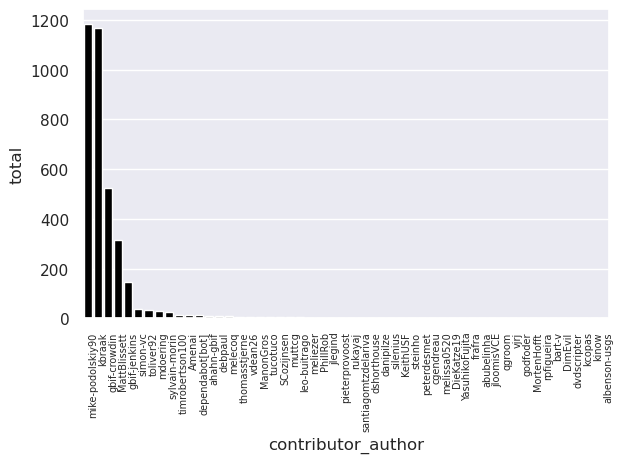

In [38]:
#contributor_commits_stats

logging.basicConfig(level=logging.WARNING)

sns.set_theme()
sns.set_palette('colorblind')

ax = sns.barplot(
    data=contributor_commits_stats, 
    x='contributor_author', 
    y='total', 
    color='black'
)
 
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="left",  fontsize=7)
plt.tight_layout()
plt.show()

In [34]:
contributor_stats_info = api_response.json()
contributor_stats = pd.DataFrame.from_dict(contributor_stats_info)
print(contributor_stats.columns)

Index(['total', 'weeks', 'author'], dtype='object')


In [11]:
type(contributor_stats)

pandas.core.frame.DataFrame

In [35]:
print(contributor_stats.shape)

(2, 3)


In [44]:
print(contributor_stats.head())

AttributeError: 'NoneType' object has no attribute 'head'

In [37]:
# Returns the total number of commits authored by the contributor
contributor_stats.total

0      3
1    236
Name: total, dtype: int64

In [38]:
contributor_stats.author

0    {'login': 'pre-commit-ci[bot]', 'id': 66853113, 'node_id': 'MDM6Qm90NjY4NTMxMTM=', 'avatar_url': 'https://avatars.githubusercontent.com/in/68672?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/pre-commit-ci%5Bbot%5D', 'html_url': 'https://github.com/apps/pre-commit-ci', 'followers_url': 'https://api.github.com/users/pre-commit-ci%5Bbot%5D/followers', 'following_url': 'https://api.github.com/users/pre-commit-ci%5Bbot%5D/following{/other_user}', 'gists_url': 'https://api.github.com/users/pre-commit-ci%5Bbot%5D/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/pre-commit-ci%5Bbot%5D/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/pre-commit-ci%5Bbot%5D/subscriptions', 'organizations_url': 'https://api.github.com/users/pre-commit-ci%5Bbot%5D/orgs', 'repos_url': 'https://api.github.com/users/pre-commit-ci%5Bbot%5D/repos', 'events_url': 'https://api.github.com/users/pre-commit-ci%5Bbot%5D/events{/privacy}', 'received_events_url': 'h

In [39]:
contributor_stats['contributor_author'] = contributor_stats[['author']].apply(lambda x: [x.get('login') for x in x])

In [40]:
contributor_stats.contributor_author

0    pre-commit-ci[bot]
1             joelnitta
Name: contributor_author, dtype: object

In [41]:
contributor_stats = getcontributorstats.get_contributor_commits_stats(repo_name, verbose=True)

print(contributor_stats.shape)
print(type(contributor_stats))

DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): api.github.com:443
DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repos/ropensci/dwctaxon/stats/contributors HTTP/1.1" 202 2


API response status "Accepted": <Response [202]>. Data not yet been cached, will retry request shortly.


AttributeError: 'NoneType' object has no attribute 'shape'

In [31]:
repo_name = 'ropensci/dwctaxon'

In [32]:
import logging
import requests
from requests.adapters import HTTPAdapter, Retry

base_contributor_stats_url = f"https://api.github.com/repos/{repo_name}/stats/contributors"
    #api_response = requests.get(url=base_contributor_stats_url, timeout=10)

logging.basicConfig(level=logging.DEBUG)

s = requests.Session()
retries = Retry(total=5, backoff_factor=1, status_forcelist=[202, 502, 503, 504])
s.mount('https://', HTTPAdapter(max_retries=retries))

api_response = s.get(url=base_contributor_stats_url, timeout=10)
print(api_response)

DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): api.github.com:443
DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repos/ropensci/dwctaxon/stats/contributors HTTP/1.1" 202 2
DEBUG:urllib3.util.retry:Incremented Retry for (url='/repos/ropensci/dwctaxon/stats/contributors'): Retry(total=4, connect=None, read=None, redirect=None, status=None)
DEBUG:urllib3.connectionpool:Retry: /repos/ropensci/dwctaxon/stats/contributors
DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repos/ropensci/dwctaxon/stats/contributors HTTP/1.1" 202 2
DEBUG:urllib3.util.retry:Incremented Retry for (url='/repos/ropensci/dwctaxon/stats/contributors'): Retry(total=3, connect=None, read=None, redirect=None, status=None)
DEBUG:urllib3.connectionpool:Retry: /repos/ropensci/dwctaxon/stats/contributors
DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repos/ropensci/dwctaxon/stats/contributors HTTP/1.1" 202 2
DEBUG:urllib3.util.retry:Incremented Retry for (url='/repo

<Response [200]>


In [5]:
base_releases_url = f"https://api.github.com/repos/{repo_name}/releases"
print(base_releases_url)

https://api.github.com/repos/gbif/ipt/releases


In [6]:
api_response = requests.get(url=base_releases_url, params={'per_page':per_pg})
print(api_response)

<Response [200]>


In [7]:
dir(api_response)

['__attrs__',
 '__bool__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__enter__',
 '__eq__',
 '__exit__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__nonzero__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_content',
 '_content_consumed',
 '_next',
 'apparent_encoding',
 'close',
 'connection',
 'content',
 'cookies',
 'elapsed',
 'encoding',
 'headers',
 'history',
 'is_permanent_redirect',
 'is_redirect',
 'iter_content',
 'iter_lines',
 'json',
 'links',
 'next',
 'ok',
 'raise_for_status',
 'raw',
 'reason',
 'request',
 'status_code',
 'text',
 'url']

In [10]:
type(api_response.status_code)

int

In [42]:
api_response.json()[0]

{'total': 3,
 'weeks': [{'w': 1638057600, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1638662400, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1639267200, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1639872000, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1640476800, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1641081600, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1641686400, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1642291200, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1642896000, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1643500800, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1644105600, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1644710400, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1645315200, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1645920000, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1646524800, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1647129600, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1647734400, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1648339200, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1648944000, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1649548800, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1650153600, 'a': 0, 'd': 0, 'c': 0},
  {'w': 1650758400, 'a': 0, 'd': 

In [8]:
api_response.json()[0].get('tag_name')

'ipt-2.7.3'

In [73]:
api_response.json()[0].get('name')

'Version 2.7.3'

In [8]:
api_response.json()[0].get('body')

'We are pleased to announce the release of version 2.7.4 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.'

In [9]:
api_response.json()[0].get('created_at')

'2023-07-27T08:37:52Z'

In [10]:
api_response.json()[0].get('published_at')

'2023-07-27T18:05:03Z'

In [12]:
type(api_response.json()[0].get('published_at'))

str

In [13]:
api_response.json()[0].get('author').get('login')  # get release author username

'mike-podolskiy90'

In [14]:
df = pd.DataFrame.from_dict(api_response.json())
df.shape

(20, 19)

In [15]:
df.head()

,url,assets_url,upload_url,html_url,id,author,node_id,tag_name,target_commitish,name,draft,prerelease,created_at,published_at,assets,tarball_url,zipball_url,body,reactions
0,https://api.github.com/repos/gbif/ipt/releases/113875425,https://api.github.com/repos/gbif/ipt/releases/113875425/assets,"https://uploads.github.com/repos/gbif/ipt/releases/113875425/assets{?name,label}",https://github.com/gbif/ipt/releases/tag/ipt-2.7.4,113875425,"{'login': 'mike-podolskiy90', 'id': 24795387, 'node_id': 'MDQ6VXNlcjI0Nzk1Mzg3', 'avatar_url': 'https://avatars.githubusercontent.com/u/24795387?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/mike-podolskiy90', 'html_url': 'https://github.com/mike-podolskiy90', 'followers_url': 'https://api.github.com/users/mike-podolskiy90/followers', 'following_url': 'https://api.github.com/users/mike-podolskiy90/following{/other_user}', 'gists_url': 'https://api.github.com/users/mike-podolskiy90/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/mike-podolskiy90/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/mike-podolskiy90/subscriptions', 'organizations_url': 'https://api.github.com/users/mike-podolskiy90/orgs', 'repos_url': 'https://api.github.com/users/mike-podolskiy90/repos', 'events_url': 'https://api.github.com/users/mike-podolskiy90/events{/privacy}', 'received_events_url': 'https://api.github.com/users/mike-podolskiy90/received_eve...",RE_kwDOAhm4Ws4GyZnh,ipt-2.7.4,master,Version 2.7.4,False,False,2023-07-27T08:37:52Z,2023-07-27T18:05:03Z,[],https://api.github.com/repos/gbif/ipt/tarball/ipt-2.7.4,https://api.github.com/repos/gbif/ipt/zipball/ipt-2.7.4,We are pleased to announce the release of version 2.7.4 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.,NaN
1,https://api.github.com/repos/gbif/ipt/releases/94080918,https://api.github.com/repos/gbif/ipt/releases/94080918/assets,"https://uploads.github.com/repos/gbif/ipt/releases/94080918/assets{?name,label}",https://github.com/gbif/ipt/releases/tag/ipt-2.7.3,94080918,"{'login': 'mike-podolskiy90', 'id': 24795387, 'node_id': 'MDQ6VXNlcjI0Nzk1Mzg3', 'avatar_url': 'https://avatars.githubusercontent.com/u/24795387?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/mike-podolskiy90', 'html_url': 'https://github.com/mike-podolskiy90', 'followers_url': 'https://api.github.com/users/mike-podolskiy90/followers', 'following_url': 'https://api.github.com/users/mike-podolskiy90/following{/other_user}', 'gists_url': 'https://api.github.com/users/mike-podolskiy90/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/mike-podolskiy90/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/mike-podolskiy90/subscriptions', 'organizations_url': 'https://api.github.com/users/mike-podolskiy90/orgs', 'repos_url': 'https://api.github.com/users/mike-podolskiy90/repos', 'events_url': 'https://api.github.com/users/mike-podolskiy90/events{/privacy}', 'received_events_url': 'https://api.github.com/users/mike-podolskiy90/received_eve...",RE_kwDOAhm4Ws4Fm4-W,ipt-2.7.3,master,Version 2.7.3,False,False,2023-03-01T12:51:24Z,2023-03-01T13:00:05Z,[],https://api.github.com/repos/gbif/ipt/tarball/ipt-2.7.3,https://api.github.com/repos/gbif/ipt/zipball/ipt-2.7.3,We are pleased to announce the release of version 2.7.3 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.,NaN
2,https://api.github.com/repos/gbif/ipt/releases/91123037,https://api.github.com/repos/gbif/ipt/releases/91123037/assets,"https://uploads.github.com/repos/gbif/ipt/releases/91123037/assets{?name,label}",https://github.com/gbif/ipt/releases/tag/ipt-2.7.2,91123037,"{'login': 'mike-podolskiy90', 'id': 24795387, 'node_id': 'MDQ6VXNlcjI0Nzk1Mzg3', 'avatar_url': 'https://avatars.githubusercontent.com/u/24795387?v=4', 'gravatar_id': '', 

In [16]:
df.columns

Index(['url', 'assets_url', 'upload_url', 'html_url', 'id', 'author',
       'node_id', 'tag_name', 'target_commitish', 'name', 'draft',
       'prerelease', 'created_at', 'published_at', 'assets', 'tarball_url',
       'zipball_url', 'body', 'reactions'],
      dtype='object')

In [17]:
release_info = api_response.json()

repo_releases = pd.DataFrame.from_dict(release_info)

repo_releases['release_author'] = repo_releases[['author']].apply(lambda x: [x.get('login') for x in x])

repo_releases = repo_releases.drop(columns=['url', 'assets_url', 'upload_url', 'html_url', 'author', 'target_commitish', 'prerelease', 'assets', 'tarball_url', 'zipball_url'])

repo_releases.head()

,id,node_id,tag_name,name,draft,created_at,published_at,body,reactions,release_author
0,113875425,RE_kwDOAhm4Ws4GyZnh,ipt-2.7.4,Version 2.7.4,False,2023-07-27T08:37:52Z,2023-07-27T18:05:03Z,We are pleased to announce the release of version 2.7.4 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.,NaN,mike-podolskiy90
1,94080918,RE_kwDOAhm4Ws4Fm4-W,ipt-2.7.3,Version 2.7.3,False,2023-03-01T12:51:24Z,2023-03-01T13:00:05Z,We are pleased to announce the release of version 2.7.3 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.,NaN,mike-podolskiy90
2,91123037,RE_kwDOAhm4Ws4Fbm1d,ipt-2.7.2,Version 2.7.2,False,2023-02-02T12:55:57Z,2023-02-02T13:10:31Z,We are pleased to announce the release of version 2.7.2 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.,NaN,mike-podolskiy90
3,90812851,RE_kwDOAhm4Ws4FabGz,ipt-2.7.1,Version 2.7.1,False,2023-01-31T11:05:28Z,2023-01-31T11:26:32Z,We are pleased to announce the release of version 2.7.1 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.,"{'url': 'https://api.github.com/repos/gbif/ipt/releases/90812851/reactions', 'total_count': 1, '+1': 1, '-1': 0, 'laugh': 0, 'hooray': 0, 'confused': 0, 'heart': 0, 'rocket': 0, 'eyes': 0}",mike-podolskiy90
4,90690104,RE_kwDOAhm4Ws4FZ9I4,ipt-2.7.0,Version 2.7.0,False,2023-01-30T13:50:53Z,2023-01-30T14:01:04Z,We are pleased to announce the release of version 2.7.0 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.,NaN,mike-podolskiy90


In [24]:
type(repo_releases.published_at)

pandas.core.series.Series

In [31]:
repo_releases.dtypes

id                 int64
node_id           object
tag_name          object
name              object
draft               bool
created_at        object
published_at      object
body              object
reactions         object
release_author    object
dtype: object

In [25]:
pd.to_datetime(repo_releases.created_at)

0    2023-07-27 08:37:52+00:00
1    2023-03-01 12:51:24+00:00
2    2023-02-02 12:55:57+00:00
3    2023-01-31 11:05:28+00:00
4    2023-01-30 13:50:53+00:00
5    2023-01-26 13:04:46+00:00
6    2022-10-28 10:59:40+00:00
7    2022-10-06 10:40:24+00:00
8    2022-09-30 07:38:44+00:00
9    2022-09-28 11:00:38+00:00
10   2022-05-18 09:44:41+00:00
11   2022-02-28 10:05:35+00:00
12   2022-02-12 20:25:21+00:00
13   2021-12-20 09:31:24+00:00
14   2021-12-10 11:27:35+00:00
15   2021-12-06 18:26:05+00:00
16   2021-11-30 14:41:08+00:00
17   2021-09-06 09:03:59+00:00
18   2021-08-23 15:47:08+00:00
19   2021-06-24 15:25:21+00:00
Name: created_at, dtype: datetime64[ns, UTC]

In [42]:
repo_releases['created_at'] = pd.to_datetime(repo_releases['created_at'], utc=True)

In [43]:
repo_releases.head()

,id,node_id,tag_name,name,draft,created_at,published_at,body,reactions,release_author,created_at_2
0,113875425,RE_kwDOAhm4Ws4GyZnh,ipt-2.7.4,Version 2.7.4,False,2023-07-27 08:37:52+00:00,2023-07-27T18:05:03Z,We are pleased to announce the release of version 2.7.4 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.,NaN,mike-podolskiy90,2023-07-27 08:37:52+00:00
1,94080918,RE_kwDOAhm4Ws4Fm4-W,ipt-2.7.3,Version 2.7.3,False,2023-03-01 12:51:24+00:00,2023-03-01T13:00:05Z,We are pleased to announce the release of version 2.7.3 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.,NaN,mike-podolskiy90,2023-03-01 12:51:24+00:00
2,91123037,RE_kwDOAhm4Ws4Fbm1d,ipt-2.7.2,Version 2.7.2,False,2023-02-02 12:55:57+00:00,2023-02-02T13:10:31Z,We are pleased to announce the release of version 2.7.2 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.,NaN,mike-podolskiy90,2023-02-02 12:55:57+00:00
3,90812851,RE_kwDOAhm4Ws4FabGz,ipt-2.7.1,Version 2.7.1,False,2023-01-31 11:05:28+00:00,2023-01-31T11:26:32Z,We are pleased to announce the release of version 2.7.1 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.,"{'url': 'https://api.github.com/repos/gbif/ipt/releases/90812851/reactions', 'total_count': 1, '+1': 1, '-1': 0, 'laugh': 0, 'hooray': 0, 'confused': 0, 'heart': 0, 'rocket': 0, 'eyes': 0}",mike-podolskiy90,2023-01-31 11:05:28+00:00
4,90690104,RE_kwDOAhm4Ws4FZ9I4,ipt-2.7.0,Version 2.7.0,False,2023-01-30 13:50:53+00:00,2023-01-30T14:01:04Z,We are pleased to announce the release of version 2.7.0 of the IPT.\r\n\r\nPlease see the [releases page of the manual](https://ipt.gbif.org/manual/en/ipt/latest/releases) for download/upgrade information.,NaN,mike-podolskiy90,2023-01-30 13:50:53+00:00


In [44]:
type(repo_releases['created_at'][0])

pandas._libs.tslibs.timestamps.Timestamp

In [46]:
repo_releases.columns

Index(['id', 'node_id', 'tag_name', 'name', 'draft', 'created_at',
       'published_at', 'body', 'release_author'],
      dtype='object')

In [47]:
len(repo_releases)

7

In [67]:
repo_releases['repo_name'] = repo_name 
repo_releases.columns

Index(['id', 'node_id', 'tag_name', 'name', 'draft', 'created_at',
       'published_at', 'body', 'release_author', 'repo_name'],
      dtype='object')

In [58]:
last_release_date = repo_releases.sort_values(by=['published_at'], ascending=False).published_at[0]
print(last_release_date)
print(pd.to_datetime(last_release_date).date())

2021-12-17T12:50:24Z
2021-12-17


In [66]:
last_release = repo_releases.sort_values(by=['published_at'], ascending=False)
print(last_release)

last_release_date = pd.to_datetime(last_release['published_at'][0])
print(last_release_date.date())

last_release_name = last_release['name'][0]
print(last_release_name)

         id                   node_id tag_name   name  draft  \
0  55541074       RE_kwDOCwMPlM4DT31S      2.2    2.2  False   
6  46961921  MDc6UmVsZWFzZTQ2OTYxOTIx    0.8.0  0.8.0  False   
5  46961906  MDc6UmVsZWFzZTQ2OTYxOTA2    0.9.0  0.9.0  False   
4  46961883  MDc6UmVsZWFzZTQ2OTYxODgz    1.0.0  1.0.0  False   
1  46958628  MDc6UmVsZWFzZTQ2OTU4NjI4      2.1    2.1  False   
2  28366147  MDc6UmVsZWFzZTI4MzY2MTQ3      2.0    2.0  False   
3  17748147  MDc6UmVsZWFzZTE3NzQ4MTQ3    1.1.0  1.1.0  False   

             created_at          published_at  \
0  2021-12-17T12:36:35Z  2021-12-17T12:50:24Z   
6  2017-01-18T21:22:24Z  2021-07-29T09:23:53Z   
5  2017-07-10T14:56:31Z  2021-07-29T09:23:40Z   
4  2017-10-09T21:22:24Z  2021-07-29T09:23:21Z   
1  2021-07-28T17:27:41Z  2021-07-29T08:31:33Z   
2  2020-07-08T15:42:55Z  2020-07-08T16:12:23Z   
3  2019-01-31T17:29:27Z  2019-06-03T16:12:36Z   

                                  body release_author  
0     riboviz release 2.2 (17/12/2021)

In [14]:
getreleases.get_release_dates(repo_name, verbose=True)

#print(repo_releases)


In [45]:
repo_creation_date = createdate.get_repo_creation_date(repo_name, config_path='../../githubanalysis/config.cfg', verbose=True)



GH link opened
Creation date of repo gbif/ipt is 2015 5 7.


In [50]:
    repo_name='riboviz/riboviz'

    closed_issues = getallissues.get_all_pages_issues(
        repo_name='riboviz/riboviz',
        config_path='../../githubanalysis/config.cfg',
        per_pg=100,
        issue_state='closed',
        verbose=True
    )  # get closed issues from all pages for given repo
    
        # calculate close_time for each closed issue
    closed_issues['close_time'] = closed_issues.apply(lambda x: calcclose.calc_issue_close_time(x.created_at, x.closed_at, return_in='decimal_days'), axis=1)

    # Get average close time in DF of repo issues to 3 decimal places.
    repo_issue_close_mean = round(closed_issues['close_time'].mean(), 3)

    print(f"For repo {repo_name}, average issue closure time was {repo_issue_close_mean} days")
    # 73.047... days to close (average) 314 closed issue tickets @ riboviz/riboviz

    # parse out assignee data from issues df as new column:
    closed_issues = issuedevs.get_issue_assignees(closed_issues)

    # get creation date of repo:
    repo_creation_date = createdate.get_repo_creation_date(repo_name, config_path='../../githubanalysis/config.cfg', verbose=True)

    # calculate days_since_start for each closed issue
    closed_issues['days_since_start'] = closed_issues.apply(lambda x: dayssince.calc_days_since_repo_creation(x.closed_at, x.repo_name, since_date=repo_creation_date, return_in='whole_days', config_path='../../githubanalysis/config.cfg'), axis=1)

    # scatterplot of time to close issue tickets, X AXIS: DAYS SINCE REPO CREATION, with mean closure time xline
    #plotissues.plot_repo_issues_data(closed_issues, repo_name, xaxis='project_time', add_events=False, save_out=True, save_name='issues_data_plot', save_type='png', save_out_location='images/')

    # separate Pull Requests (PRs) from data
    # where closed_issues['pull_request'] IS *NOT* NaN (ie it IS a pull request) => PRs.

    closed_pull_requests = closed_issues.loc[closed_issues['pull_request'].notna()]

    closed_issues_only = closed_issues.loc[closed_issues['pull_request'].isna()]
    
    # add column with boolean for PR status
    closed_issues['pr'] = closed_issues['pull_request'].notna()
    


GH link opened
Total responses: 314
Shape of data: (314, 30)
Issue state counts: closed    314
Name: state, dtype: int64
For repo riboviz/riboviz, average issue closure time was 73.474 days
Dataframe has original dimensions: (314, 32).
Dataframe has been updated with 'assigned_devs' info and now has dimensions: (314, 33).
GH link opened
Creation date of repo riboviz/riboviz is 2019 5 3.


In [5]:
closed_issues.head(3)

,url,repository_url,labels_url,comments_url,events_url,html_url,id,node_id,number,title,...,body,reactions,timeline_url,performed_via_github_app,state_reason,repo_name,close_time,assigned_devs,days_since_start,pr
0,https://api.github.com/repos/riboviz/riboviz/issues/480,https://api.github.com/repos/riboviz/riboviz,https://api.github.com/repos/riboviz/riboviz/issues/480/labels{/name},https://api.github.com/repos/riboviz/riboviz/issues/480/comments,https://api.github.com/repos/riboviz/riboviz/issues/480/events,https://github.com/riboviz/riboviz/pull/480,1589292020,PR_kwDOCwMPlM5KNw4v,480,bam-to-h5-error-479,...,"Used a third : in rhdf5::h5writeAttribute.integer as described in #477, this allowed the vignette to complete. Edits to gene_length calculation were made.","{'url': 'https://api.github.com/repos/riboviz/riboviz/issues/480/reactions', 'total_count': 0, '+1': 0, '-1': 0, 'laugh': 0, 'hooray': 0, 'confused': 0, 'heart': 0, 'rocket': 0, 'eyes': 0}",https://api.github.com/repos/riboviz/riboviz/issues/480/timeline,None,None,riboviz/riboviz,20.086875,"[ewallace, swinterbourne]",1406,True
1,https://api.github.com/repos/riboviz/riboviz/issues/479,https://api.github.com/repos/riboviz/riboviz,https://api.github.com/repos/riboviz/riboviz/issues/479/labels{/name},https://api.github.com/repos/riboviz/riboviz/issues/479/comments,https://api.github.com/repos/riboviz/riboviz/issues/479/events,https://github.com/riboviz/riboviz/issues/479,1586301544,I_kwDOCwMPlM5ejQpo,479,Fix errors in bam_to_h5.R,...,"@swinterbourne noticed errors arising in bam_to_h5.R:\r\n\r\n-`ReadsToCountMatrix` had some errors putting data in the matrix. We tracked this to a bug/error in calculation of `gene_length` from `bam_file` instead of from `gene_location`. Pull request needed.\r\n\r\n- `BamToH5` throws an error writing. It's probably a change in the functions to write data in rhdf5.\r\n```\r\nError: 'h5writeAttribute.integer' is not an exported object from 'namespace:rhdf5'\r\n```\r\nTo do: read the manual for `h5write` and see what we should change. https://rdrr.io/bioc/rhdf5/man/h5write.html\r\n\r\nHypothesis: replacing `h5writeAttribute.integer` (not exported) by `h5writeAttribute` (exported) will fix the problem.\r\n\r\n- After fixing the error, I (@ewallace) should run the integration tests to check the vignette run pretty much the same way.","{'url': 'https://api.github.com/repos/riboviz/riboviz/issues/479/reactions', 'total_count': 0, '+1': 0, '-1': 0, 'laugh': 0, 'hooray': 0, 'confused': 0, 'heart': 0, 'rocket': 0, 'eyes': 0}",https://api.github.com/repos/riboviz/riboviz/issues/479/timeline,None,completed,riboviz/riboviz,27.983484,"[ewallace, swinterbourne]",1412,False
2,https://api.github.com/repos/riboviz/riboviz/issues/477,https://api.github.com/repos/riboviz/riboviz,https://api.github.com/repos/riboviz/riboviz/issues/477/labels{/name},https://api.github.com/repos/riboviz/riboviz/issues/477/comments,https://api.github.com/repos/riboviz/riboviz/issues/477/events,https://github.com/riboviz/riboviz/issues/477,1435154161,I_kwDOCwMPlM5Virbx,477,Issue with `rhdf5::h5writeAttribute.integer` in `bam_to_h5_functions.R`,...,"In previous versions of `rhdf`, `h5writeAttribute.integer` could be accessed via `rhdf5::h5writeAttribute.integer`. As of version `rhdf5 v2.40.0`, we must now use `rhdf5:::h5writeAttribute.integer` (note the third `:`). I assume we chose `h5writeAttribute.integer` to help with efficiency. Is this how we want to proceed going forward, or do we want to switch to `h5writeAttribute`? @ewallace, do you have thoughts?","{'url': 'https://api.github.com/repos/riboviz/riboviz/issues/477/reactions', 'total_count': 0, '+1': 0, '-1': 0, 'laugh': 0, 'hooray': 0, 'confused': 0, 'heart': 0, 'rocket': 0, 'eyes': 0}",https://api.github.com/repos/riboviz/riboviz/issues/477/timeline,None,completed,riboviz/riboviz,131.926644,[acope3],1412,False


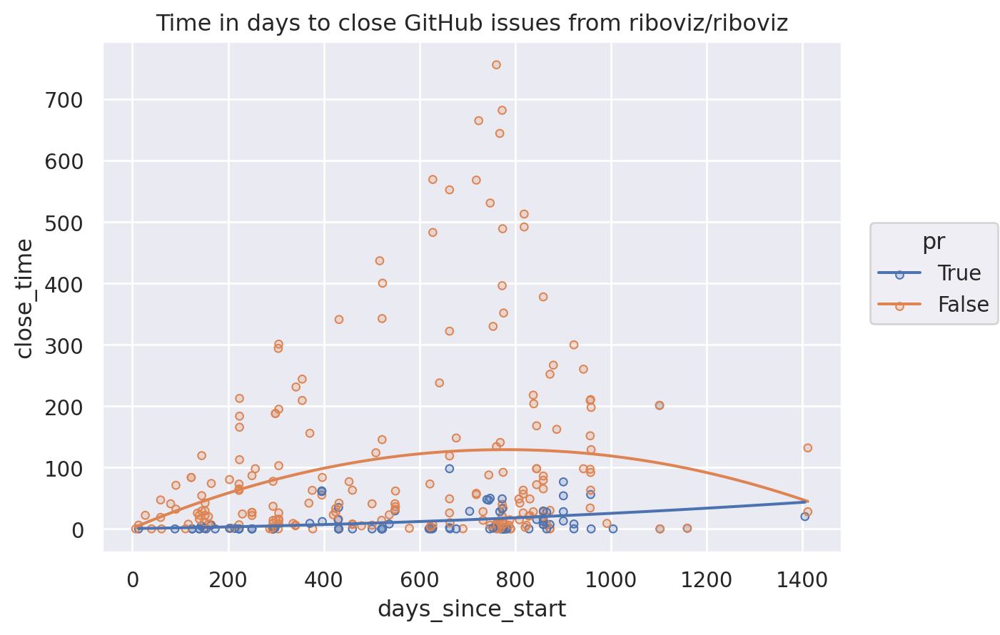

In [6]:
p = (
    so.Plot(
        closed_issues, 
        x='days_since_start', 
        y='close_time', 
        color='pr', 
    )  # colour based on pull request status
    .add(so.Dots(pointsize=4))
    .add(so.Line(), so.PolyFit())
    # not sure how I feel about the PolyFit lines... :s But different ones per PR status so that's cool. 
)
p.label(x="Time Since Repo Creation (days)", y="Time to Close Issue (days)")
p.label(title=f"Time in days to close GitHub issues from {repo_name}")

<Axes: xlabel='days_since_start', ylabel='close_time'>

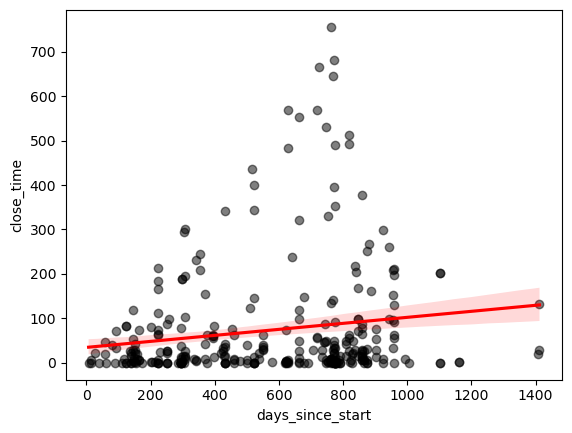

In [7]:
# scatter plot with regression line using regplot()
sns.regplot(x='days_since_start', y='close_time', data=closed_issues,
           scatter_kws = {'color':'black', 'alpha':0.5}, 
           line_kws = {"color": "red"}, 
           ci=95 # confidence interval of 95%, which is default. 'None' removes this.
           )

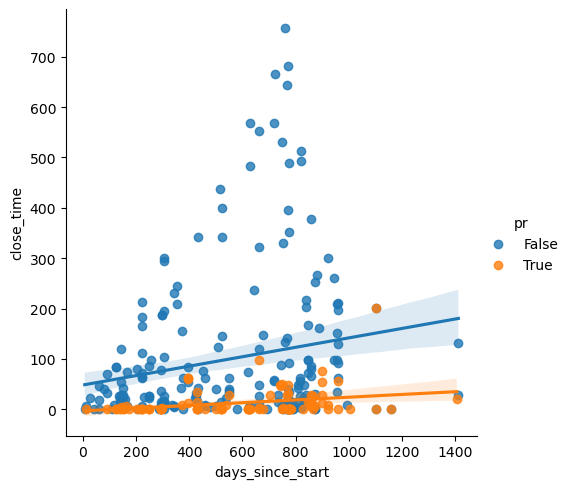

In [8]:
# regression lines with lmplot() - regression lines based on categorical variable. 
# SAME PLOT
sns.lmplot(x='days_since_start', y='close_time', data=closed_issues,
           hue = "pr", 
           #markers =["o", "x"], 
           #palette = "Set2"
           )

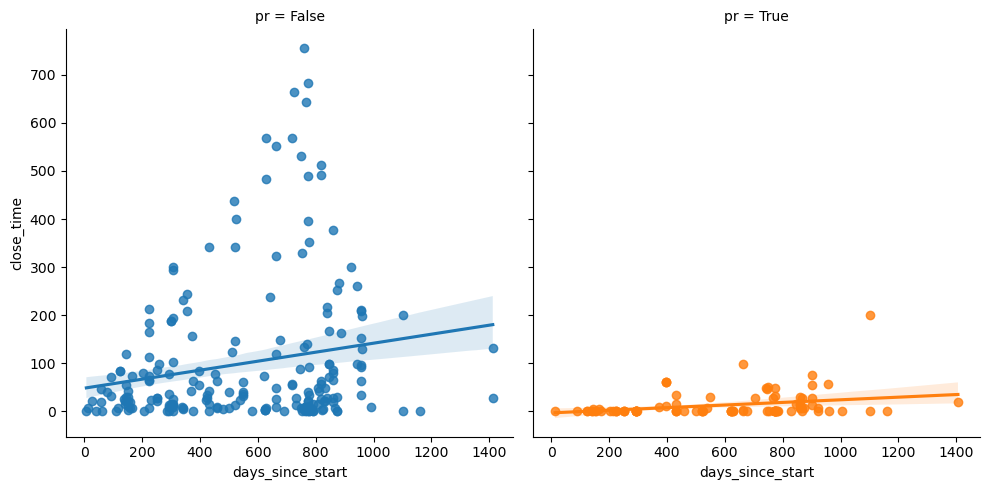

In [9]:
# regression lines with lmplot() - regression lines based on categorical variable. 
# DIFFERENT PLOTS 
sns.lmplot(x='days_since_start', y='close_time', data=closed_issues,
           hue = "pr", 
           #markers =["o", "x"], 
           #palette = "Set2"
          col='pr'
          )

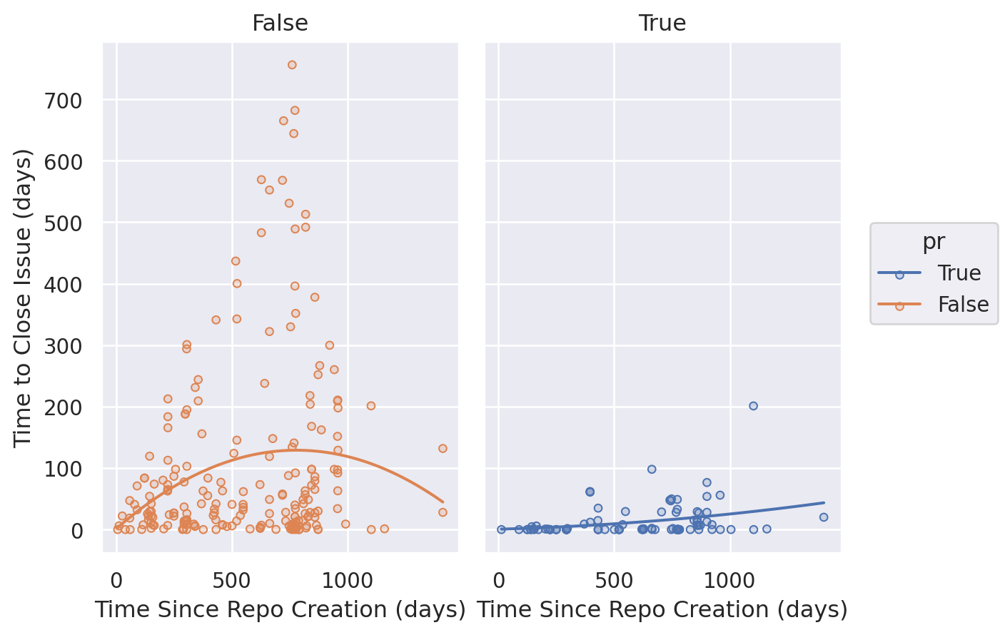

In [10]:
p = (
    so.Plot(
        closed_issues, 
        x='days_since_start', 
        y='close_time',
        color='pr'
    )  # colour based on pull request status
    .add(so.Dots(pointsize=4))
    .add(so.Line(), so.PolyFit())
    # not sure how I feel about the PolyFit lines... :s But different ones per PR status so that's cool. 
    .label(x="Time Since Repo Creation (days)", y="Time to Close Issue (days)")
)
p.facet('pr')

In [6]:
    repo_name = 'riboviz/riboviz'

    closed_issues = getallissues.get_all_pages_issues(
        repo_name=repo_name,
        config_path='../../githubanalysis/config.cfg',
        per_pg=100,
        issue_state='closed',
        verbose=True
    )  # get closed issues from all pages for given repo

    #print(closed_issues.dtypes)

    # calculate close_time for each closed issue
    closed_issues['close_time'] = closed_issues.apply(lambda x: calcclose.calc_issue_close_time(x.created_at, x.closed_at, return_in='decimal_days'), axis=1)

    # Get average close time in DF of repo issues to 3 decimal places.
    repo_issue_close_mean = round(closed_issues['close_time'].mean(), 3)

    print(f"For repo {repo_name}, average issue closure time was {repo_issue_close_mean} days")
    # 73.047... days to close (average) 314 closed issue tickets @ riboviz/riboviz

    # parse out assignee data from issues df as new column:
    closed_issues = issuedevs.get_issue_assignees(closed_issues)

    # get creation date of repo:
    repo_creation_date = createdate.get_repo_creation_date(repo_name, config_path='../../githubanalysis/config.cfg', verbose=True)

    # calculate days_since_start for each closed issue
    closed_issues['days_since_start'] = closed_issues.apply(lambda x: dayssince.calc_days_since_repo_creation(x.closed_at, x.repo_name, since_date=repo_creation_date, return_in='whole_days', config_path='githubanalysis/config.cfg'), axis=1)

    # add column with boolean for PR status
    closed_issues['pull_request_bool'] = closed_issues['pull_request'].notna()

GH link opened
Total responses: 314
Shape of data: (314, 30)
Issue state counts: closed    314
Name: state, dtype: int64
For repo riboviz/riboviz, average issue closure time was 73.474 days
Dataframe has original dimensions: (314, 32).
Dataframe has been updated with 'assigned_devs' info and now has dimensions: (314, 33).
GH link opened
Creation date of repo riboviz/riboviz is 2019 5 3.


In [7]:
# # get release dates for repo
repo_releases = getreleases.get_release_dates(repo_name, verbose=True)
print(repo_releases)

    #print(repo_releases.shape)
    #print(repo_releases.columns)
    #
    # # calculate 'days since' date equivalents for release dates.
repo_releases['release_date_since_repo_creation'] = repo_releases.apply(
    lambda x: dayssince.calc_days_since_repo_creation(
        x.published_at,
        x.repo_name,
        since_date=repo_creation_date,
        return_in='whole_days',
        config_path='githubanalysis/config.cfg'
    ), axis=1
)
    #print(repo_releases['release_date_since_repo_creation'])

repo_releases['releases_before_repo_creation'] = repo_releases['created_at'].apply(lambda x: 'True' if x < repo_creation_date else 'False')

    #print(repo_releases['releases_before_repo_creation'])

if pd.Series(repo_releases['releases_before_repo_creation']).any():
    print(f"BE AWARE: Some releases were created before the 'official' repo creation date.")

    #print(repo_releases.columns)

release_events = repo_releases['release_date_since_repo_creation']

(7, 18)
There have been 7 releases published at repo riboviz/riboviz. The last release was 2.2, released on 2021-12-17 12:50:24+00:00.
  tag_name   name  draft                created_at              published_at  \
0      2.2    2.2  False 2021-12-17 12:36:35+00:00 2021-12-17 12:50:24+00:00   
1      2.1    2.1  False 2021-07-28 17:27:41+00:00 2021-07-29 08:31:33+00:00   
2      2.0    2.0  False 2020-07-08 15:42:55+00:00 2020-07-08 16:12:23+00:00   
3    1.1.0  1.1.0  False 2019-01-31 17:29:27+00:00 2019-06-03 16:12:36+00:00   
4    1.0.0  1.0.0  False 2017-10-09 21:22:24+00:00 2021-07-29 09:23:21+00:00   
5    0.9.0  0.9.0  False 2017-07-10 14:56:31+00:00 2021-07-29 09:23:40+00:00   
6    0.8.0  0.8.0  False 2017-01-18 21:22:24+00:00 2021-07-29 09:23:53+00:00   

                                  body release_author        repo_name  
0     riboviz release 2.2 (17/12/2021)       mikej888  riboviz/riboviz  
1      RiboViz release 2.1 (29/07/21).       mikej888  riboviz/riboviz  
2    

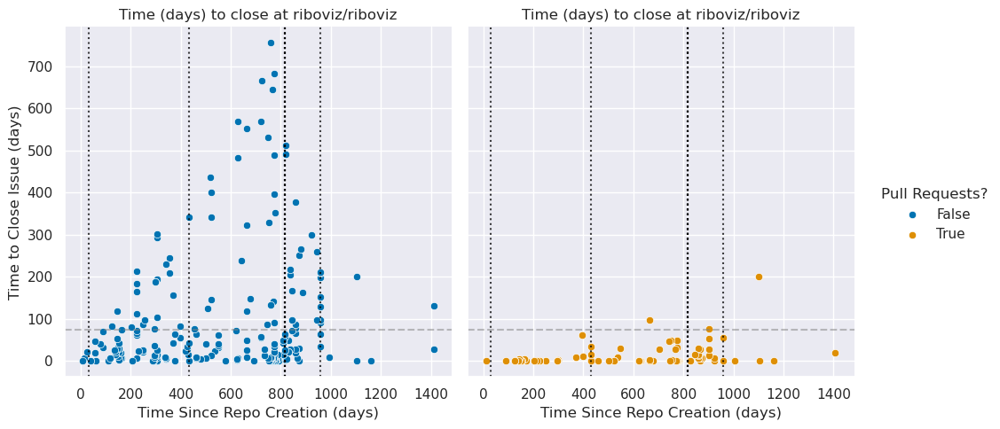

In [28]:
repo_data_df = closed_issues
add_events = release_events


sns.set_theme()
sns.set_palette('colorblind')


g = sns.FacetGrid(data=repo_data_df, col='pull_request_bool', hue='pull_request_bool', height=5)
g.map(sns.scatterplot, 'days_since_start', 'close_time')
g.set(title=f"Time (days) to close at {repo_name}") 
g.set_axis_labels("Time Since Repo Creation (days)", "Time to Close Issue (days)")
g.add_legend(title="Pull Requests?")
g.refline(y=np.mean(repo_data_df.close_time), linestyle = '--', alpha=0.5)  # add mean line w/ average close time for repo


if add_events is not False:
    for event in add_events:
        g.refline(x=event, ymin=0, ymax=1, color = 'black', linestyle=':', alpha=0.75)

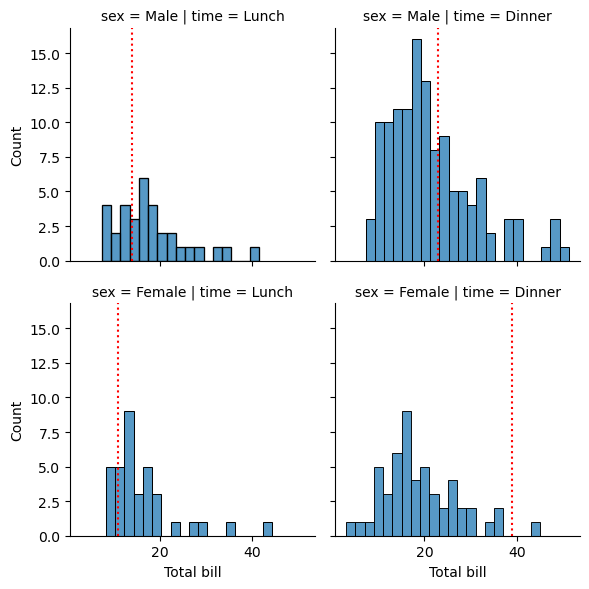

In [46]:
import matplotlib.pyplot as plt
import seaborn as sns

tips = sns.load_dataset("tips")

g = sns.FacetGrid(tips, col="time", row="sex")
g.map_dataframe(sns.histplot, x="total_bill", binwidth=2)
g.set_axis_labels("Total bill", "Count")

line_position = [14, 23, 11, 39]

for ax, pos in zip(g.axes.flat, line_position):
    ax.axvline(x=pos, color='r', linestyle=':')

plt.tight_layout()
plt.show()

In [11]:
closed_issues.explode('assigned_devs', ignore_index=True)

,url,repository_url,labels_url,comments_url,events_url,html_url,id,node_id,number,title,...,body,reactions,timeline_url,performed_via_github_app,state_reason,repo_name,close_time,assigned_devs,days_since_start,pr
0,https://api.github.com/repos/riboviz/riboviz/issues/480,https://api.github.com/repos/riboviz/riboviz,https://api.github.com/repos/riboviz/riboviz/issues/480/labels{/name},https://api.github.com/repos/riboviz/riboviz/issues/480/comments,https://api.github.com/repos/riboviz/riboviz/issues/480/events,https://github.com/riboviz/riboviz/pull/480,1589292020,PR_kwDOCwMPlM5KNw4v,480,bam-to-h5-error-479,...,"Used a third : in rhdf5::h5writeAttribute.integer as described in #477, this allowed the vignette to complete. Edits to gene_length calculation were made.","{'url': 'https://api.github.com/repos/riboviz/riboviz/issues/480/reactions', 'total_count': 0, '+1': 0, '-1': 0, 'laugh': 0, 'hooray': 0, 'confused': 0, 'heart': 0, 'rocket': 0, 'eyes': 0}",https://api.github.com/repos/riboviz/riboviz/issues/480/timeline,None,None,riboviz/riboviz,20.086875,ewallace,1406,True
1,https://api.github.com/repos/riboviz/riboviz/issues/480,https://api.github.com/repos/riboviz/riboviz,https://api.github.com/repos/riboviz/riboviz/issues/480/labels{/name},https://api.github.com/repos/riboviz/riboviz/issues/480/comments,https://api.github.com/repos/riboviz/riboviz/issues/480/events,https://github.com/riboviz/riboviz/pull/480,1589292020,PR_kwDOCwMPlM5KNw4v,480,bam-to-h5-error-479,...,"Used a third : in rhdf5::h5writeAttribute.integer as described in #477, this allowed the vignette to complete. Edits to gene_length calculation were made.","{'url': 'https://api.github.com/repos/riboviz/riboviz/issues/480/reactions', 'total_count': 0, '+1': 0, '-1': 0, 'laugh': 0, 'hooray': 0, 'confused': 0, 'heart': 0, 'rocket': 0, 'eyes': 0}",https://api.github.com/repos/riboviz/riboviz/issues/480/timeline,None,None,riboviz/riboviz,20.086875,swinterbourne,1406,True
2,https://api.github.com/repos/riboviz/riboviz/issues/479,https://api.github.com/repos/riboviz/riboviz,https://api.github.com/repos/riboviz/riboviz/issues/479/labels{/name},https://api.github.com/repos/riboviz/riboviz/issues/479/comments,https://api.github.com/repos/riboviz/riboviz/issues/479/events,https://github.com/riboviz/riboviz/issues/479,1586301544,I_kwDOCwMPlM5ejQpo,479,Fix errors in bam_to_h5.R,...,"@swinterbourne noticed errors arising in bam_to_h5.R:\r\n\r\n-`ReadsToCountMatrix` had some errors putting data in the matrix. We tracked this to a bug/error in calculation of `gene_length` from `bam_file` instead of from `gene_location`. Pull request needed.\r\n\r\n- `BamToH5` throws an error writing. It's probably a change in the functions to write data in rhdf5.\r\n```\r\nError: 'h5writeAttribute.integer' is not an exported object from 'namespace:rhdf5'\r\n```\r\nTo do: read the manual for `h5write` and see what we should change. https://rdrr.io/bioc/rhdf5/man/h5write.html\r\n\r\nHypothesis: replacing `h5writeAttribute.integer` (not exported) by `h5writeAttribute` (exported) will fix the problem.\r\n\r\n- After fixing the error, I (@ewallace) should run the integration tests to check the vignette run pretty much the same way.","{'url': 'https://api.github.com/repos/riboviz/riboviz/issues/479/reactions', 'total_count': 0, '+1': 0, '-1': 0, 'laugh': 0, 'hooray': 0, 'confused': 0, 'heart': 0, 'rocket': 0, 'eyes': 0}",https://api.github.com/repos/riboviz/riboviz/issues/479/timeline,None,completed,riboviz/riboviz,27.983484,ewallace,1412,False
3,https://api.github.com/repos/riboviz/riboviz/issues/479,https://api.github.com/repos/riboviz/riboviz,https://api.github.com/repos/riboviz/riboviz/issues/479/labels{/name},https://api.github.com/repos/riboviz/riboviz/issues/479/comments,https://api.github.com/repos/riboviz/riboviz/issues/479/events,https://github.com/riboviz/riboviz/issues/479,1586301544,I_kwDOCwMPlM5ejQpo,479,Fix errors in bam_to_h5.R,...,"@swinterbourne noticed errors arising in bam_to_h5.R:\r

mikej888         161
NaN              100
FlicAnderson      36
ewallace          24
acope3             8
shahpr             8
john-s-f           5
swinterbourne      4
3mma-mack          4
amandamok          4
canuse             2
p6t                1
XUEXUEXUE0         1
lianafaye          1
kavousan           1
Name: assigned_devs, dtype: int64


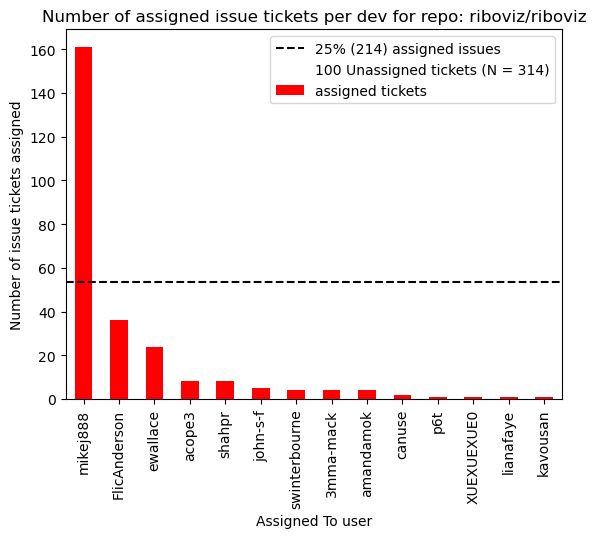

In [12]:
    exploded_devs = closed_issues.apply(pd.Series).explode(column='assigned_devs', ignore_index=True)

# calculate 25% of assigned tickets
    all_closed = len(closed_issues.index)
    total_assigned = len(closed_issues[[bool(x) for x in closed_issues.assigned_devs]])
    #non_assigned = all_closed - total_assigned
    non_assigned_text = f'{all_closed - total_assigned} Unassigned tickets (N = {all_closed})'

    print(exploded_devs['assigned_devs'].value_counts(dropna=False))  # print per-dev assignment counts

    # do actual plotting:
    exploded_devs['assigned_devs'].value_counts().plot.bar(column='assigned_devs', color='red', label='assigned tickets')

    plt.xlabel("Assigned To user")
    plt.ylabel("Number of issue tickets assigned")
    plt.title(f"Number of assigned issue tickets per dev for repo: {repo_name}")
    plt.axhline(y=(total_assigned*0.25), linestyle='--', color='black', label=f'25% ({total_assigned}) assigned issues')  # plot line at 25% of all closed assigned tickets
    plt.plot([], [], ' ', label=non_assigned_text)  # Create empty plot with blank marker containing the extra label
    plt.legend(loc='upper right')

(None, None, <seaborn.axisgrid.FacetGrid at 0x7f886668b070>)

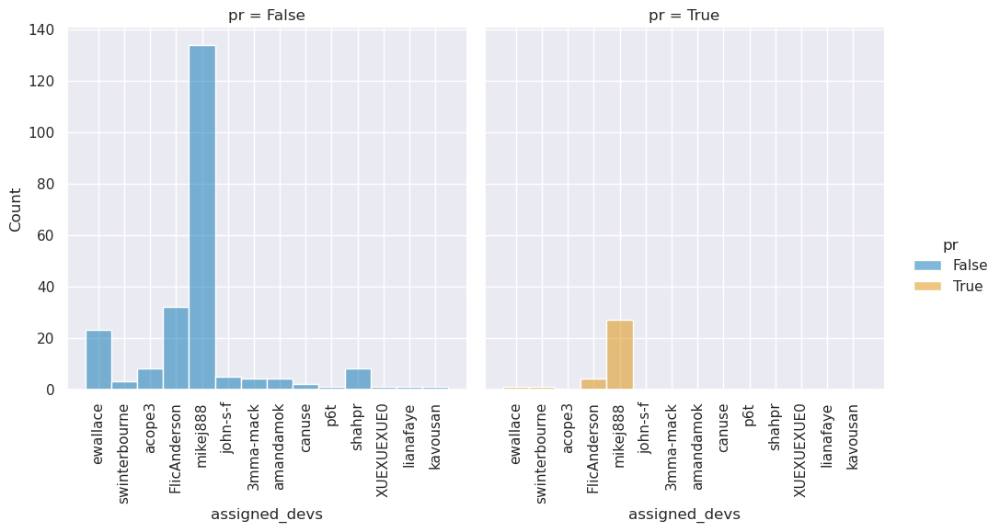

In [19]:

exploded_devs = closed_issues.apply(pd.Series).explode(column='assigned_devs', ignore_index=True)
(
    sns.set_theme(),
    sns.set_palette('colorblind'),
    sns.displot(
        data=exploded_devs,
        x='assigned_devs',
        hue='pr', #multiple='stack'  #multiple='dodge'
        col='pr' ## this plots PR vs issue ticket in separate plots
    )
    .set_xticklabels(rotation=90)
)        

(None, <seaborn.axisgrid.FacetGrid at 0x7f872b6934f0>)

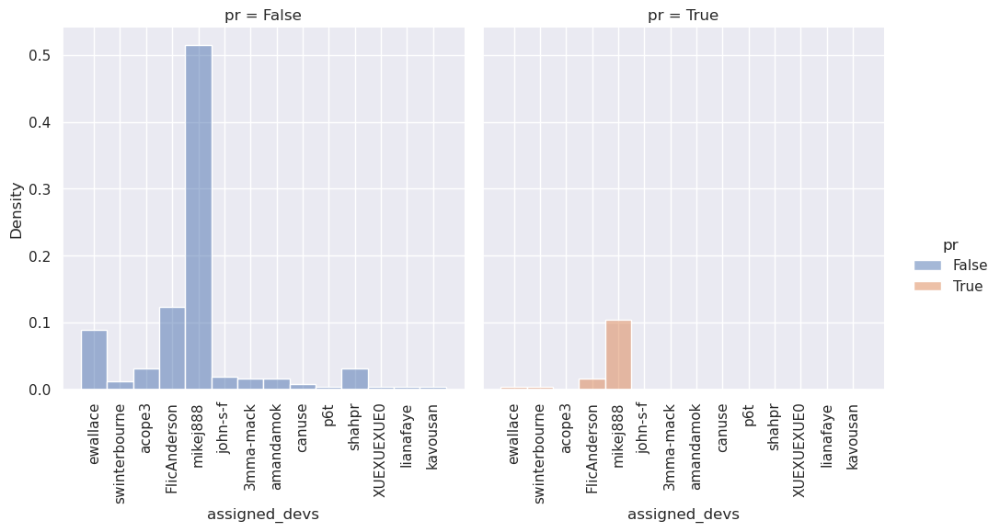

In [55]:

exploded_devs = closed_issues.apply(pd.Series).explode(column='assigned_devs', ignore_index=True)
(
    sns.set_theme(),
    sns.displot(
        data=exploded_devs,
        x='assigned_devs',
        hue='pr', 
        stat='density',
        col='pr' ## this plots PR vs issue ticket in separate plots
    )
    .set_xticklabels(rotation=90)
)    

(None, None, <seaborn.axisgrid.FacetGrid at 0x7f8856029180>)

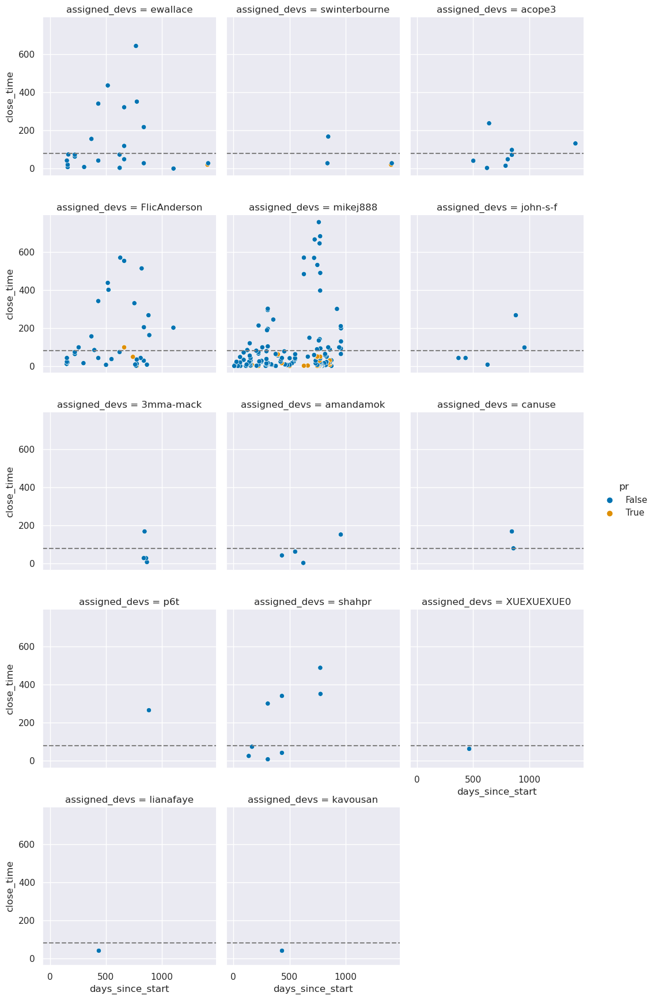

In [18]:
long_closed_issues = closed_issues.apply(pd.Series).explode(column='assigned_devs', ignore_index=True)

(
    sns.set_theme(),
    sns.set_palette('colorblind'),
    sns.relplot(
        data=long_closed_issues,
        x='days_since_start',
        y='close_time',
        col='assigned_devs', 
        hue='pr', 
        kind='scatter', 
        height=3.5,
        col_wrap=3
    )
    .refline(y=long_closed_issues['close_time'].mean())  # plots repo mean close time line.
)
    
# https://seaborn.pydata.org/generated/seaborn.relplot.html#seaborn.relplot  

In [6]:
closed_issues.keys()

Index(['url', 'repository_url', 'labels_url', 'comments_url', 'events_url',
       'html_url', 'id', 'node_id', 'number', 'title', 'user', 'labels',
       'state', 'locked', 'assignee', 'assignees', 'milestone', 'comments',
       'created_at', 'updated_at', 'closed_at', 'author_association',
       'active_lock_reason', 'draft', 'pull_request', 'body', 'reactions',
       'timeline_url', 'performed_via_github_app', 'state_reason',
       'repo_name'],
      dtype='object')

In [8]:
closed_issues['pull_request'].head

<bound method NDFrame.head of 0      {'url': 'https://api.github.com/repos/riboviz/riboviz/pulls/480', 'html_url': 'https://github.com/riboviz/riboviz/pull/480', 'diff_url': 'https://github.com/riboviz/riboviz/pull/480.diff', 'patch_url': 'https://github.com/riboviz/riboviz/pull/480.patch', 'merged_at': '2023-03-09T14:39:45Z'}
1                                                                                                                                                                                                                                                                                                      NaN
2                                                                                                                                                                                                                                                                                                      NaN
3      {'url': 'https://api.github.com/repos/riboviz/riboviz/pulls/471', 

In [9]:
dir(closed_issues['pull_request'])

['T',
 '_AXIS_LEN',
 '_AXIS_ORDERS',
 '_AXIS_TO_AXIS_NUMBER',
 '_HANDLED_TYPES',
 '__abs__',
 '__add__',
 '__and__',
 '__annotations__',
 '__array__',
 '__array_priority__',
 '__array_ufunc__',
 '__array_wrap__',
 '__bool__',
 '__class__',
 '__contains__',
 '__copy__',
 '__deepcopy__',
 '__delattr__',
 '__delitem__',
 '__dict__',
 '__dir__',
 '__divmod__',
 '__doc__',
 '__eq__',
 '__finalize__',
 '__float__',
 '__floordiv__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getitem__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__iadd__',
 '__iand__',
 '__ifloordiv__',
 '__imod__',
 '__imul__',
 '__init__',
 '__init_subclass__',
 '__int__',
 '__invert__',
 '__ior__',
 '__ipow__',
 '__isub__',
 '__iter__',
 '__itruediv__',
 '__ixor__',
 '__le__',
 '__len__',
 '__long__',
 '__lt__',
 '__matmul__',
 '__mod__',
 '__module__',
 '__mul__',
 '__ne__',
 '__neg__',
 '__new__',
 '__nonzero__',
 '__or__',
 '__pos__',
 '__pow__',
 '__radd__',
 '__rand__',
 '__rdivmod__',
 '__redu

In [10]:
closed_issues['pull_request'].isna()

0      False
1       True
2       True
3      False
4       True
       ...  
309     True
310     True
311     True
312     True
313     True
Name: pull_request, Length: 314, dtype: bool

In [11]:
closed_issues['pull_request'].notna()  # ie first item IS a pull request, so is NOT N.A.

0       True
1      False
2      False
3       True
4      False
       ...  
309    False
310    False
311    False
312    False
313    False
Name: pull_request, Length: 314, dtype: bool

In [17]:
closed_issues['pull_request'].notna().describe()  # ie first item IS a pull request, so is NOT N.A.

count       314
unique        2
top       False
freq        215
Name: pull_request, dtype: object

In [18]:
closed_issues['pull_request'].notna().sum()

99

In [35]:
closed_PRs = closed_issues.loc[closed_issues['pull_request'].notna()]
closed_PRs.shape

(99, 31)

In [5]:
repo_creation_date = createdate.get_repo_creation_date(repo_name='riboviz/riboviz', config_path='../../githubanalysis/config.cfg', verbose=True)
repo_creation_date 
# tz aware

GH link opened
Creation date of repo riboviz/riboviz is 2019 5 3.


Timestamp('2019-05-03 12:15:59+0000', tz='UTC')

In [28]:
subset_assignees = closed_issues[['number', 'created_at', 'closed_at']].head()  
subset_assignees['repo_name'] = 'riboviz/riboviz'
subset_assignees
# assignees is the one I need as it includes ALL assigned-to, rather than just 1 person

,number,created_at,closed_at,repo_name
0,480,2023-02-17 12:34:39+00:00,2023-03-09 14:39:45+00:00,riboviz/riboviz
1,479,2023-02-15 17:57:52+00:00,2023-03-15 17:34:05+00:00,riboviz/riboviz
2,477,2022-11-03 19:21:52+00:00,2023-03-15 17:36:14+00:00,riboviz/riboviz
3,471,2022-07-05 15:19:40+00:00,2022-07-06 14:21:09+00:00,riboviz/riboviz
4,470,2022-07-05 08:39:11+00:00,2022-07-06 14:36:59+00:00,riboviz/riboviz


In [29]:
subset_assignees['closed_at'][0]- repo_creation_date

Timedelta('1406 days 02:23:46')

In [30]:
days_since = subset_assignees['closed_at'][0]- repo_creation_date

type(days_since)

pandas._libs.tslibs.timedeltas.Timedelta

In [32]:
createdate.get_repo_creation_date('riboviz/riboviz', config_path='../../githubanalysis/config.cfg', verbose=True)

GH link opened
Creation date of repo riboviz/riboviz is 2019 5 3.


Timestamp('2019-05-03 12:15:59+0000', tz='UTC')

In [20]:
import githubanalysis.analysis.calc_days_since_repo_creation as dayssince

since = dayssince.calc_days_since_repo_creation(date=subset_assignees['closed_at'][0],repo_name='riboviz/riboviz', return_in='days', config_path='../../githubanalysis/config.cfg')
print(since)
type(since)

1406


int

In [34]:
subset_assignees['close_time'] = subset_assignees.apply(lambda x: calcclose.calc_issue_close_time(x.created_at, x.closed_at, return_in='decimal_days'), axis=1)
subset_assignees

,number,created_at,closed_at,repo_name,close_time
0,480,2023-02-17 12:34:39+00:00,2023-03-09 14:39:45+00:00,riboviz/riboviz,20.086875
1,479,2023-02-15 17:57:52+00:00,2023-03-15 17:34:05+00:00,riboviz/riboviz,27.983484
2,477,2022-11-03 19:21:52+00:00,2023-03-15 17:36:14+00:00,riboviz/riboviz,131.926644
3,471,2022-07-05 15:19:40+00:00,2022-07-06 14:21:09+00:00,riboviz/riboviz,0.959363
4,470,2022-07-05 08:39:11+00:00,2022-07-06 14:36:59+00:00,riboviz/riboviz,1.248472


In [35]:
subset_assignees['days_since_start'] = subset_assignees.apply(
        lambda x: dayssince.calc_days_since_repo_creation(x.closed_at, repo_name= x.repo_name, return_in='days', config_path='../../githubanalysis/config.cfg'), axis=1)

In [36]:
subset_assignees

,number,created_at,closed_at,repo_name,close_time,days_since_start
0,480,2023-02-17 12:34:39+00:00,2023-03-09 14:39:45+00:00,riboviz/riboviz,20.086875,1406
1,479,2023-02-15 17:57:52+00:00,2023-03-15 17:34:05+00:00,riboviz/riboviz,27.983484,1412
2,477,2022-11-03 19:21:52+00:00,2023-03-15 17:36:14+00:00,riboviz/riboviz,131.926644,1412
3,471,2022-07-05 15:19:40+00:00,2022-07-06 14:21:09+00:00,riboviz/riboviz,0.959363,1160
4,470,2022-07-05 08:39:11+00:00,2022-07-06 14:36:59+00:00,riboviz/riboviz,1.248472,1160


In [14]:
import githubanalysis.visualization.plot_repo_issues_data as plotissues

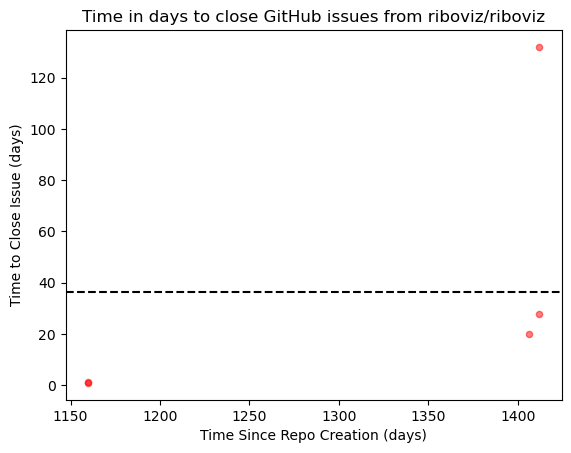

In [39]:
repo_name = subset_assignees['repo_name'][0]
subset_assignees.plot.scatter(x='days_since_start', y='close_time', alpha=0.5, color='red')
#plt.xlim(0, max_days_since_repo_creation)  # None for xmin means matplotlib calcs itself the best minimum limit
plt.xlabel("Time Since Repo Creation (days)")
plt.ylabel("Time to Close Issue (days)")
plt.title(f"Time in days to close GitHub issues from {repo_name}")
plt.axhline(y=np.mean(subset_assignees.close_time), linestyle='--', color='black')

In [41]:
subset_assignees.keys()

Index(['number', 'created_at', 'closed_at', 'repo_name', 'close_time',
       'days_since_start'],
      dtype='object')

In [18]:
plotissues.plot_repo_issues_data(subset_assignees, repo_name='riboviz/riboviz', xaxis = 'project_length', add_events=False, save_out=True, save_name='issues_data_plot', save_type='png', save_out_location='../../images/')

In [6]:
closed_issues[['number', 'closed_at']].head()

,number,closed_at
0,480,2023-03-09 14:39:45+00:00
1,479,2023-03-15 17:34:05+00:00
2,477,2023-03-15 17:36:14+00:00
3,471,2022-07-06 14:21:09+00:00
4,470,2022-07-06 14:36:59+00:00


In [8]:
print(subset_assignees['closed_at'][0])  # tz aware


2023-03-09 14:39:45+00:00


In [11]:
subset_assignees['closed_at'][0] - repo_creation_date

TypeError: Cannot subtract tz-naive and tz-aware datetime-like objects.

In [ ]:
#closed_issue_df['close_time'] = closed_issue_df.apply(lambda x: time_diff(x.closure_date, x.creation_date), axis=1)

In [24]:
subset_assignees.apply(dayssince.calc_days_since_repo_creation(
    date=subset_assignees[''], 
        repo_name='riboviz/riboviz'
    )
    axis=1, 
    raw=True
)

SyntaxError: invalid syntax. Perhaps you forgot a comma? (3468143758.py, line 2)

In [21]:
subset_assignees['days_since'] = subset_assignees.apply(
    dayssince.calc_days_since_repo_creation, 
    axis=1, 
    raw=True
)

TypeError: calc_days_since_repo_creation() missing 1 required positional argument: 'repo_name'

In [16]:
dir(jcbp.created_at)  # gives repo creation date. 
# datetime.datetime(2023, 1, 30, 15, 58, 50)

['__add__',
 '__class__',
 '__delattr__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__ne__',
 '__new__',
 '__radd__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__rsub__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__sub__',
 '__subclasshook__',
 'astimezone',
 'combine',
 'ctime',
 'date',
 'day',
 'dst',
 'fold',
 'fromisocalendar',
 'fromisoformat',
 'fromordinal',
 'fromtimestamp',
 'hour',
 'isocalendar',
 'isoformat',
 'isoweekday',
 'max',
 'microsecond',
 'min',
 'minute',
 'month',
 'now',
 'replace',
 'resolution',
 'second',
 'strftime',
 'strptime',
 'time',
 'timestamp',
 'timetuple',
 'timetz',
 'today',
 'toordinal',
 'tzinfo',
 'tzname',
 'utcfromtimestamp',
 'utcnow',
 'utcoffset',
 'utctimetuple',
 'weekday',
 'year']

In [ ]:
closed_issue_df['close_time'] = closed_issue_df.apply(
    lambda x: time_diff(x.closure_date, x.creation_date), axis=1
)

In [13]:
repo_name = 'FlicAnderson/20230215-JournalClub-BestPractices'
jcbp = ghconn.get_repo_connection(repo_name=repo_name, config_path='../../githubanalysis/config.cfg', per_pg=100)

GH link opened


In [9]:
dir(jcbp)

['CHECK_AFTER_INIT_FLAG',
 '_CompletableGithubObject__complete',
 '_CompletableGithubObject__completed',
 '_GithubObject__makeSimpleAttribute',
 '_GithubObject__makeSimpleListAttribute',
 '_GithubObject__makeTransformedAttribute',
 '_Repository__create_pull',
 '_Repository__create_pull_1',
 '_Repository__create_pull_2',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_allow_merge_commit',
 '_allow_rebase_merge',
 '_allow_squash_merge',
 '_archive_url',
 '_archived',
 '_assignees_url',
 '_blobs_url',
 '_branches_url',
 '_clone_url',
 '_collaborators_url',
 '_comments_url',
 '_commits_url',
 '_compare_url',
 '_completeIfNeeded',
 '_completeIfNotSet',
 '_contents_url',
 

In [62]:
subset_assignees.assignees[1][1].get('login')

'swinterbourne'

In [72]:
for issue in subset_assignees['assignees']:
    print(issue)

[{'login': 'ewallace', 'id': 683603, 'node_id': 'MDQ6VXNlcjY4MzYwMw==', 'avatar_url': 'https://avatars.githubusercontent.com/u/683603?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/ewallace', 'html_url': 'https://github.com/ewallace', 'followers_url': 'https://api.github.com/users/ewallace/followers', 'following_url': 'https://api.github.com/users/ewallace/following{/other_user}', 'gists_url': 'https://api.github.com/users/ewallace/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/ewallace/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/ewallace/subscriptions', 'organizations_url': 'https://api.github.com/users/ewallace/orgs', 'repos_url': 'https://api.github.com/users/ewallace/repos', 'events_url': 'https://api.github.com/users/ewallace/events{/privacy}', 'received_events_url': 'https://api.github.com/users/ewallace/received_events', 'type': 'User', 'site_admin': False}, {'login': 'swinterbourne', 'id': 73784355, 'node_id': 'MDQ6

In [91]:
for issue in subset_assignees['assignees']:
    [print(issue.get('login')) for issue in issue]

NameError: name 'x' is not defined

In [87]:
subset_assignees[['number']].applymap('issue number is {}'.format)

,number
0,issue number is 480
1,issue number is 479
2,issue number is 477
3,issue number is 471
4,issue number is 470


In [59]:
closed_issue_df['close_time'] = closed_issue_df.apply(
    lambda x: time_diff(x.closure_date, x.creation_date), axis=1
)

NameError: name 'item' is not defined

In [122]:
subset_assignees['assigned_devs'] = subset_assignees[['assignees']].applymap(
    lambda x:  [x.get('login') for x in x]
)

In [123]:
subset_assignees

,number,assignees,assigned_devs
0,480,"[{'login': 'ewallace', 'id': 683603, 'node_id': 'MDQ6VXNlcjY4MzYwMw==', 'avatar_url': 'https://avatars.githubusercontent.com/u/683603?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/ewallace', 'html_url': 'https://github.com/ewallace', 'followers_url': 'https://api.github.com/users/ewallace/followers', 'following_url': 'https://api.github.com/users/ewallace/following{/other_user}', 'gists_url': 'https://api.github.com/users/ewallace/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/ewallace/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/ewallace/subscriptions', 'organizations_url': 'https://api.github.com/users/ewallace/orgs', 'repos_url': 'https://api.github.com/users/ewallace/repos', 'events_url': 'https://api.github.com/users/ewallace/events{/privacy}', 'received_events_url': 'https://api.github.com/users/ewallace/received_events', 'type': 'User', 'site_admin': False}, {'login': 'swinterbourne', 'id': 73784355, 'node_id': '...","[ewallace, swinterbourne]"
1,479,"[{'login': 'ewallace', 'id': 683603, 'node_id': 'MDQ6VXNlcjY4MzYwMw==', 'avatar_url': 'https://avatars.githubusercontent.com/u/683603?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/ewallace', 'html_url': 'https://github.com/ewallace', 'followers_url': 'https://api.github.com/users/ewallace/followers', 'following_url': 'https://api.github.com/users/ewallace/following{/other_user}', 'gists_url': 'https://api.github.com/users/ewallace/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/ewallace/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/ewallace/subscriptions', 'organizations_url': 'https://api.github.com/users/ewallace/orgs', 'repos_url': 'https://api.github.com/users/ewallace/repos', 'events_url': 'https://api.github.com/users/ewallace/events{/privacy}', 'received_events_url': 'https://api.github.com/users/ewallace/received_events', 'type': 'User', 'site_admin': False}, {'login': 'swinterbourne', 'id': 73784355, 'node_id': '...","[ewallace, swinterbourne]"
2,477,"[{'login': 'acope3', 'id': 21202517, 'node_id': 'MDQ6VXNlcjIxMjAyNTE3', 'avatar_url': 'https://avatars.githubusercontent.com/u/21202517?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/acope3', 'html_url': 'https://github.com/acope3', 'followers_url': 'https://api.github.com/users/acope3/followers', 'following_url': 'https://api.github.com/users/acope3/following{/other_user}', 'gists_url': 'https://api.github.com/users/acope3/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/acope3/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/acope3/subscriptions', 'organizations_url': 'https://api.github.com/users/acope3/orgs', 'repos_url': 'https://api.github.com/users/acope3/repos', 'events_url': 'https://api.github.com/users/acope3/events{/privacy}', 'received_events_url': 'https://api.github.com/users/acope3/received_events', 'type': 'User', 'site_admin': False}]",[acope3]
3,471,[],[]
4,470,[],[]


In [124]:
dir(subset_assignees[['assigned_devs']])

['T',
 '_AXIS_LEN',
 '_AXIS_ORDERS',
 '_AXIS_TO_AXIS_NUMBER',
 '_HANDLED_TYPES',
 '__abs__',
 '__add__',
 '__and__',
 '__annotations__',
 '__array__',
 '__array_priority__',
 '__array_ufunc__',
 '__array_wrap__',
 '__bool__',
 '__class__',
 '__contains__',
 '__copy__',
 '__dataframe__',
 '__deepcopy__',
 '__delattr__',
 '__delitem__',
 '__dict__',
 '__dir__',
 '__divmod__',
 '__doc__',
 '__eq__',
 '__finalize__',
 '__floordiv__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getitem__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__iadd__',
 '__iand__',
 '__ifloordiv__',
 '__imod__',
 '__imul__',
 '__init__',
 '__init_subclass__',
 '__invert__',
 '__ior__',
 '__ipow__',
 '__isub__',
 '__iter__',
 '__itruediv__',
 '__ixor__',
 '__le__',
 '__len__',
 '__lt__',
 '__matmul__',
 '__mod__',
 '__module__',
 '__mul__',
 '__ne__',
 '__neg__',
 '__new__',
 '__nonzero__',
 '__or__',
 '__pos__',
 '__pow__',
 '__radd__',
 '__rand__',
 '__rdivmod__',
 '__reduce__',
 '__reduce_ex_

In [133]:
subset_assignees['assigned_devs'].value_counts()

[ewallace, swinterbourne]    2
[]                           2
[acope3]                     1
Name: assigned_devs, dtype: int64

In [111]:
subset_assignees[['assignees']].applymap(lambda x: [print(x) for x in x], result_type='', na_action='ignore')

{'login': 'ewallace', 'id': 683603, 'node_id': 'MDQ6VXNlcjY4MzYwMw==', 'avatar_url': 'https://avatars.githubusercontent.com/u/683603?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/ewallace', 'html_url': 'https://github.com/ewallace', 'followers_url': 'https://api.github.com/users/ewallace/followers', 'following_url': 'https://api.github.com/users/ewallace/following{/other_user}', 'gists_url': 'https://api.github.com/users/ewallace/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/ewallace/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/ewallace/subscriptions', 'organizations_url': 'https://api.github.com/users/ewallace/orgs', 'repos_url': 'https://api.github.com/users/ewallace/repos', 'events_url': 'https://api.github.com/users/ewallace/events{/privacy}', 'received_events_url': 'https://api.github.com/users/ewallace/received_events', 'type': 'User', 'site_admin': False}
{'login': 'swinterbourne', 'id': 73784355, 'node_id': 'MDQ6VX

,assignees
0,"[None, None]"
1,"[None, None]"
2,[None]
3,[]
4,[]


In [136]:
 # calculate close_time for each closed issue
closed_issues['close_time'] = closed_issues.apply(lambda x: calcclose.calc_issue_close_time(x.created_at, x.closed_at, return_in='decimal_days'), axis=1)

    # Get average close time in DF of repo issues to 3 decimal places.
repo_issue_close_mean = round(closed_issues['close_time'].mean(), 3)

    # todo: do something clever if average close time was < 1 day.
print(f"For repo riboviz, average issue closure time was {repo_issue_close_mean} days")
    # 73.047... days to close (average) 314 closed issue tickets @ riboviz/riboviz

For repo riboviz, average issue closure time was 73.474 days


In [138]:
import githubanalysis.processing.get_issue_assignees as issuedevs
# parse out assignee data from issues df as new column:
closed_issues = issuedevs.get_issue_assignees(closed_issues)

print(closed_issues['assigned_devs'].value_counts())

Dataframe has original dimensions: (314, 32).
Dataframe has been updated with 'assigned_devs' info and now has dimensions: (314, 33).
[mikej888]                                                                              144
[]                                                                                      100
[FlicAnderson]                                                                           17
[mikej888, FlicAnderson]                                                                  7
[acope3]                                                                                  7
[ewallace]                                                                                6
[ewallace, FlicAnderson]                                                                  5
[john-s-f]                                                                                3
[ewallace, mikej888]                                                                      2
[ewallace, shahpr]                    

In [156]:
dir(closed_issues['assigned_devs'])

['T',
 '_AXIS_LEN',
 '_AXIS_ORDERS',
 '_AXIS_TO_AXIS_NUMBER',
 '_HANDLED_TYPES',
 '__abs__',
 '__add__',
 '__and__',
 '__annotations__',
 '__array__',
 '__array_priority__',
 '__array_ufunc__',
 '__array_wrap__',
 '__bool__',
 '__class__',
 '__contains__',
 '__copy__',
 '__deepcopy__',
 '__delattr__',
 '__delitem__',
 '__dict__',
 '__dir__',
 '__divmod__',
 '__doc__',
 '__eq__',
 '__finalize__',
 '__float__',
 '__floordiv__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getitem__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__iadd__',
 '__iand__',
 '__ifloordiv__',
 '__imod__',
 '__imul__',
 '__init__',
 '__init_subclass__',
 '__int__',
 '__invert__',
 '__ior__',
 '__ipow__',
 '__isub__',
 '__iter__',
 '__itruediv__',
 '__ixor__',
 '__le__',
 '__len__',
 '__long__',
 '__lt__',
 '__matmul__',
 '__mod__',
 '__module__',
 '__mul__',
 '__ne__',
 '__neg__',
 '__new__',
 '__nonzero__',
 '__or__',
 '__pos__',
 '__pow__',
 '__radd__',
 '__rand__',
 '__rdivmod__',
 '__redu

In [162]:
type(closed_issues['assigned_devs'])

pandas.core.series.Series

In [173]:
taller = closed_issues.apply(pd.Series).explode(column='assigned_devs')
taller['assigned_devs'].unique()

array(['ewallace', 'swinterbourne', 'acope3', nan, 'FlicAnderson',
       'mikej888', 'john-s-f', '3mma-mack', 'amandamok', 'canuse', 'p6t',
       'shahpr', 'XUEXUEXUE0', 'lianafaye', 'kavousan'], dtype=object)

In [198]:
taller['assigned_devs'].head(n=10).notnull().sum()

6

In [202]:
n = 0
for item in closed_issues['assigned_devs']:
    if len(item) == 0:
        n += 1
    print(n)

0
0
0
1
2
3
3
4
5
6
7
8
9
10
11
11
11
12
13
13
13
13
14
15
15
16
16
16
17
18
19
19
19
19
20
20
20
20
20
20
21
22
22
22
22
22
22
22
22
23
23
24
24
24
25
25
25
26
27
27
28
28
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
32
33
33
33
34
35
36
36
36
36
36
37
38
38
38
39
39
39
40
40
41
42
42
43
43
44
45
45
46
46
46
46
46
47
47
47
47
47
48
49
50
51
52
53
54
54
54
54
54
54
54
54
55
55
56
56
56
56
57
58
59
60
60
60
60
60
60
61
61
61
62
62
62
63
64
64
64
65
65
66
66
66
66
66
66
66
66
66
67
67
67
67
67
68
68
69
70
71
72
73
74
75
75
75
75
75
75
75
75
75
76
76
77
78
79
79
79
79
79
79
79
79
79
79
79
80
80
80
80
81
82
83
84
84
84
84
84
84
84
84
84
84
84
85
86
86
87
87
88
89
89
89
90
91
91
91
91
91
91
91
92
93
93
93
93
94
94
95
95
95
95
95
95
95
95
95
96
96
96
97
97
97
97
98
98
98
98
98
99
99
99
100
100
100
100
100
100
100
100
100


In [204]:
len(closed_issues[[bool(x) for x in closed_issues.assigned_devs]])
#df[[bool(x) for x in df.col]]

214

<Axes: >

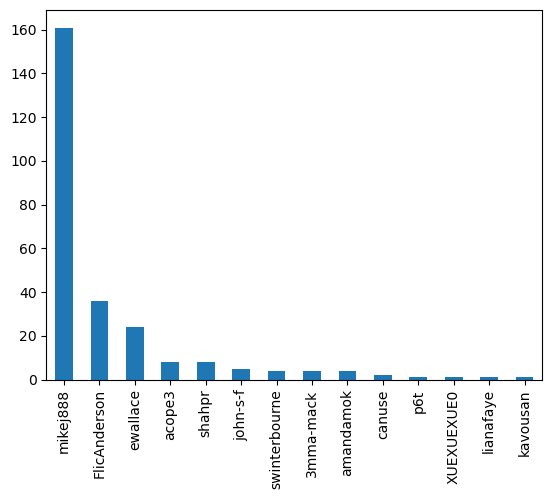

In [186]:
taller['assigned_devs'].value_counts().plot.bar(column='assigned_devs')


In [189]:
taller['assigned_devs'].value_counts().mean()

18.571428571428573

In [40]:
dir(subset_assignees.assignees[1])
    

['__add__',
 '__class__',
 '__class_getitem__',
 '__contains__',
 '__delattr__',
 '__delitem__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__iadd__',
 '__imul__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__len__',
 '__lt__',
 '__mul__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__reversed__',
 '__rmul__',
 '__setattr__',
 '__setitem__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 'append',
 'clear',
 'copy',
 'count',
 'extend',
 'index',
 'insert',
 'pop',
 'remove',
 'reverse',
 'sort']

In [4]:
closed_issues['close_time'] = closed_issues.apply(lambda x: calcclose.calc_issue_close_time(x.created_at, x.closed_at), axis=1)

NameError: name 'closed_issues' is not defined

In [6]:
 closed_issues['close_time'].head

<bound method NDFrame.head of 0       20
1       27
2      131
3        0
4        1
      ... 
309      6
310      0
311    301
312    756
313     22
Name: close_time, Length: 314, dtype: int64>

In [7]:
 closed_issues['close_time'].mean()

73.04777070063695

In [8]:
closed_issues.dtypes

url                                      object
repository_url                           object
labels_url                               object
comments_url                             object
events_url                               object
html_url                                 object
id                                        int64
node_id                                  object
number                                    int64
title                                    object
user                                     object
labels                                   object
state                                    object
locked                                     bool
assignee                                 object
assignees                                object
milestone                                object
comments                                  int64
created_at                  datetime64[ns, UTC]
updated_at                               object
closed_at                   datetime64[n

In [54]:
closed_issues['repo_name'] = 'riboviz/riboviz'
closed_issues.head

<bound method NDFrame.head of                                                          url  \
0    https://api.github.com/repos/riboviz/riboviz/issues/480   
1    https://api.github.com/repos/riboviz/riboviz/issues/479   
2    https://api.github.com/repos/riboviz/riboviz/issues/477   
3    https://api.github.com/repos/riboviz/riboviz/issues/471   
4    https://api.github.com/repos/riboviz/riboviz/issues/470   
..                                                       ...   
309    https://api.github.com/repos/riboviz/riboviz/issues/6   
310    https://api.github.com/repos/riboviz/riboviz/issues/5   
311    https://api.github.com/repos/riboviz/riboviz/issues/4   
312    https://api.github.com/repos/riboviz/riboviz/issues/3   
313    https://api.github.com/repos/riboviz/riboviz/issues/1   

                                   repository_url  \
0    https://api.github.com/repos/riboviz/riboviz   
1    https://api.github.com/repos/riboviz/riboviz   
2    https://api.github.com/repos/riboviz/

In [56]:
closed_issues.repo_name.nunique()

1

In [59]:
closed_issues[0, 'repo_name'] = "different/repo"
closed_issues.head

<bound method NDFrame.head of                                                          url  \
0    https://api.github.com/repos/riboviz/riboviz/issues/480   
1    https://api.github.com/repos/riboviz/riboviz/issues/479   
2    https://api.github.com/repos/riboviz/riboviz/issues/477   
3    https://api.github.com/repos/riboviz/riboviz/issues/471   
4    https://api.github.com/repos/riboviz/riboviz/issues/470   
..                                                       ...   
309    https://api.github.com/repos/riboviz/riboviz/issues/6   
310    https://api.github.com/repos/riboviz/riboviz/issues/5   
311    https://api.github.com/repos/riboviz/riboviz/issues/4   
312    https://api.github.com/repos/riboviz/riboviz/issues/3   
313    https://api.github.com/repos/riboviz/riboviz/issues/1   

                                   repository_url  \
0    https://api.github.com/repos/riboviz/riboviz   
1    https://api.github.com/repos/riboviz/riboviz   
2    https://api.github.com/repos/riboviz/

In [62]:
closed_issues.repo_name[0]

'riboviz/riboviz'

In [34]:
a_time = pd.Timedelta(closed_issues.closed_at[42] - closed_issues.created_at[42])
print(a_time)

2 days 17:02:02


In [48]:
type(closed_issues.closed_at[0])

pandas._libs.tslibs.timestamps.Timestamp

In [13]:
print(closed_issues.closed_at[42] - closed_issues.created_at[42])

2 days 17:02:02


In [26]:
a_time.components

Components(days=2, hours=17, minutes=2, seconds=2, milliseconds=0, microseconds=0, nanoseconds=0)

In [43]:
a_time.total_seconds() / 60 / 60 / 24

2.70974537037037

In [45]:
a_time.days

2

In [30]:
a_time.components.minutes

2

In [27]:
type(a_time)

pandas._libs.tslibs.timedeltas.Timedelta

In [16]:
dir(a_time)

['__abs__',
 '__add__',
 '__array_priority__',
 '__bool__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__divmod__',
 '__doc__',
 '__eq__',
 '__floordiv__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__mod__',
 '__module__',
 '__mul__',
 '__ne__',
 '__neg__',
 '__new__',
 '__pos__',
 '__pyx_vtable__',
 '__radd__',
 '__rdivmod__',
 '__reduce__',
 '__reduce_cython__',
 '__reduce_ex__',
 '__repr__',
 '__rfloordiv__',
 '__rmod__',
 '__rmul__',
 '__rsub__',
 '__rtruediv__',
 '__setattr__',
 '__setstate__',
 '__setstate_cython__',
 '__sizeof__',
 '__str__',
 '__sub__',
 '__subclasshook__',
 '__truediv__',
 '__weakref__',
 '_as_unit',
 '_d',
 '_from_value_and_reso',
 '_h',
 '_is_populated',
 '_m',
 '_ms',
 '_ns',
 '_repr_base',
 '_req_any_kwargs_new',
 '_reso',
 '_round',
 '_s',
 '_us',
 'asm8',
 'ceil',
 'components',
 'days',
 'delta',
 'floor',
 'freq',
 'is_populated',
 'isoformat',
 'max',

In [7]:
closed_issues.columns

Index(['url', 'repository_url', 'labels_url', 'comments_url', 'events_url',
       'html_url', 'id', 'node_id', 'number', 'title', 'user', 'labels',
       'state', 'locked', 'assignee', 'assignees', 'milestone', 'comments',
       'created_at', 'updated_at', 'closed_at', 'author_association',
       'active_lock_reason', 'draft', 'pull_request', 'body', 'reactions',
       'timeline_url', 'performed_via_github_app', 'state_reason'],
      dtype='object')

In [28]:
closed_issues.dtypes

url                         object
repository_url              object
labels_url                  object
comments_url                object
events_url                  object
html_url                    object
id                           int64
node_id                     object
number                       int64
title                       object
user                        object
labels                      object
state                       object
locked                        bool
assignee                    object
assignees                   object
milestone                   object
comments                     int64
created_at                  object
updated_at                  object
closed_at                   object
author_association          object
active_lock_reason          object
draft                       object
pull_request                object
body                        object
reactions                   object
timeline_url                object
performed_via_github

In [19]:
type(closed_issues['created_at'])

pandas.core.series.Series

In [20]:
closed_issues['created_at'].head

<bound method NDFrame.head of 0      2023-02-17T12:34:39Z
1      2023-02-15T17:57:52Z
2      2022-11-03T19:21:52Z
3      2022-07-05T15:19:40Z
4      2022-07-05T08:39:11Z
               ...         
309    2019-05-10T13:14:06Z
310    2019-05-10T13:08:14Z
311    2019-05-08T14:35:33Z
312    2019-05-08T14:27:03Z
313    2019-05-08T14:23:12Z
Name: created_at, Length: 314, dtype: object>

In [37]:
#closed_issues['created_at'] = pd.to_datetime( closed_issues['created_at'], yearfirst=True, utc=True, format='ISO8601' )  
closed_issues['created_at'] = pd.to_datetime( closed_issues['created_at'], yearfirst=True, utc=True, format='%Y-%m-%dT%H:%M:%S%Z', unit='s' )  
closed_issues['closed_at'] = pd.to_datetime( closed_issues['closed_at'], yearfirst=True, utc=True, format='%Y-%m-%dT%H:%M:%S%Z', unit='s' )  

closed_issues.dtypes
type(closed_issues['created_at'][5])

pandas._libs.tslibs.timestamps.Timestamp

In [32]:
closed_issues['close_time'] = closed_issues.apply(lambda x: calcclose.calc_issue_close_time(x.created_at, x.closed_at), axis=1)

print(closed_issues[['created_at', 'closed_at', 'close_time']].head)

<bound method NDFrame.head of                    created_at                 closed_at  close_time
0   2023-02-17 12:34:39+00:00 2023-03-09 14:39:45+00:00          20
1   2023-02-15 17:57:52+00:00 2023-03-15 17:34:05+00:00          27
2   2022-11-03 19:21:52+00:00 2023-03-15 17:36:14+00:00         131
3   2022-07-05 15:19:40+00:00 2022-07-06 14:21:09+00:00           0
4   2022-07-05 08:39:11+00:00 2022-07-06 14:36:59+00:00           1
..                        ...                       ...         ...
309 2019-05-10 13:14:06+00:00 2019-05-16 15:16:39+00:00           6
310 2019-05-10 13:08:14+00:00 2019-05-10 13:43:24+00:00           0
311 2019-05-08 14:35:33+00:00 2020-03-04 15:01:47+00:00         301
312 2019-05-08 14:27:03+00:00 2021-06-02 16:05:17+00:00         756
313 2019-05-08 14:23:12+00:00 2019-05-30 16:59:49+00:00          22

[314 rows x 3 columns]>


In [35]:
calcclose.calc_issue_close_time("2023-07-05 15:19:40", "2023-07-04 14:21:09")

TypeError: unsupported operand type(s) for -: 'str' and 'str'

In [13]:
repo_name_a = 'ropensci/dwctaxon'

urlparam = f"https://api.github.com/repos/{repo_name_a}/issues"
print(urlparam)
content = requests.get(url=urlparam)
content

https://api.github.com/repos/ropensci/dwctaxon/issues


<Response [200]>

In [5]:
repo_name_b = 'ropensci/software-review'

urlparam = f"https://api.github.com/repos/{repo_name_b}/issues"
links = requests.get(url=urlparam, params={'per_page' : 100}).links
links

{}

In [41]:
ghcon = ghconn.get_repo_connection(repo_name='ropensci/dwctaxon', config_path='../config.cfg')
ghcon.open_issues_count

GH link opened


6

In [4]:
all_issues = issuepages.get_all_pages_issues(repo_name='riboviz/riboviz', config_path='../config.cfg')
#type(all_issues.state.value_counts()['open'])

GH link opened
Total responses: 478
Shape of data: (478, 30)
Issue state counts: closed    314
open      164
Name: state, dtype: int64


In [24]:
dir(all_issues)

['T',
 '_AXIS_LEN',
 '_AXIS_ORDERS',
 '_AXIS_TO_AXIS_NUMBER',
 '_HANDLED_TYPES',
 '__abs__',
 '__add__',
 '__and__',
 '__annotations__',
 '__array__',
 '__array_priority__',
 '__array_ufunc__',
 '__array_wrap__',
 '__bool__',
 '__class__',
 '__contains__',
 '__copy__',
 '__dataframe__',
 '__deepcopy__',
 '__delattr__',
 '__delitem__',
 '__dict__',
 '__dir__',
 '__divmod__',
 '__doc__',
 '__eq__',
 '__finalize__',
 '__floordiv__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getitem__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__iadd__',
 '__iand__',
 '__ifloordiv__',
 '__imod__',
 '__imul__',
 '__init__',
 '__init_subclass__',
 '__invert__',
 '__ior__',
 '__ipow__',
 '__isub__',
 '__iter__',
 '__itruediv__',
 '__ixor__',
 '__le__',
 '__len__',
 '__lt__',
 '__matmul__',
 '__mod__',
 '__module__',
 '__mul__',
 '__ne__',
 '__neg__',
 '__new__',
 '__nonzero__',
 '__or__',
 '__pos__',
 '__pow__',
 '__radd__',
 '__rand__',
 '__rdivmod__',
 '__reduce__',
 '__reduce_ex_

In [6]:
#all_issues.info  # first and last 5 rows of all columns, with dims at end. 
#all_issues.describe  # looks same as .info
#all_issues.dtypes # data types for each field.  
#all_issues.memory_usage()  # various values per field, e.g. index 128, url 736, locked 92. 
#all_issues.shape  # (92, 30)
all_issues.info() # this is more like it!  
# Gives class, rangeIndex which is kinda len, columns, datatypes, non-null counts, memory usage etc.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 478 entries, 0 to 477
Data columns (total 30 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   url                       478 non-null    object
 1   repository_url            478 non-null    object
 2   labels_url                478 non-null    object
 3   comments_url              478 non-null    object
 4   events_url                478 non-null    object
 5   html_url                  478 non-null    object
 6   id                        478 non-null    int64 
 7   node_id                   478 non-null    object
 8   number                    478 non-null    int64 
 9   title                     478 non-null    object
 10  user                      478 non-null    object
 11  labels                    478 non-null    object
 12  state                     478 non-null    object
 13  locked                    478 non-null    bool  
 14  assignee                  

In [7]:
#read_in = pd.read_json(path_or_buf='../../data/all_issues__riboviz_riboviz.json', orient='table', typ='frame')
read_in = pd.read_json(path_or_buf='../../data/all_issues__riboviz_riboviz.json', orient='table', typ='frame', dtype=None, convert_dates='False', keep_default_dates='False', date_unit='s')
read_in.info()
# milestone, active_lock_reason and performed_via_github_app are shifted to float64 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 478 entries, 0 to 477
Data columns (total 30 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   url                       478 non-null    object 
 1   repository_url            478 non-null    object 
 2   labels_url                478 non-null    object 
 3   comments_url              478 non-null    object 
 4   events_url                478 non-null    object 
 5   html_url                  478 non-null    object 
 6   id                        478 non-null    int64  
 7   node_id                   478 non-null    object 
 8   number                    478 non-null    int64  
 9   title                     478 non-null    object 
 10  user                      478 non-null    object 
 11  labels                    478 non-null    object 
 12  state                     478 non-null    object 
 13  locked                    478 non-null    bool   
 14  assignee  

In [10]:
write_out_sample = all_issues.sample(frac=0.05, replace=False, weights=None, random_state=25, axis='index', ignore_index=True)
write_out_sample.shape

read_in_sample = read_in.sample(frac=0.05, replace=False, weights=None, random_state=25, axis='index', ignore_index=True)
read_in_sample.shape

(24, 30)

In [21]:
#write_out_sample['url'] == read_in_sample['url']
#read_in_sample['assignees'].all == write_out_sample['assignees'].all
read_in_sample['assignees']

0              [{'login': 'FlicAnderson', 'id': 5812129, 'node_id': 'MDQ6VXNlcjU4MTIxMjk=', 'avatar_url': 'https://avatars.githubusercontent.com/u/5812129?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/FlicAnderson', 'html_url': 'https://github.com/FlicAnderson', 'followers_url': 'https://api.github.com/users/FlicAnderson/followers', 'following_url': 'https://api.github.com/users/FlicAnderson/following{/other_user}', 'gists_url': 'https://api.github.com/users/FlicAnderson/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/FlicAnderson/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/FlicAnderson/subscriptions', 'organizations_url': 'https://api.github.com/users/FlicAnderson/orgs', 'repos_url': 'https://api.github.com/users/FlicAnderson/repos', 'events_url': 'https://api.github.com/users/FlicAnderson/events{/privacy}', 'received_events_url': 'https://api.github.com/users/FlicAnderson/received_events', 'type': 'User', 'site_admin': Fa

In [22]:
write_out_sample['assignees']

0              [{'login': 'FlicAnderson', 'id': 5812129, 'node_id': 'MDQ6VXNlcjU4MTIxMjk=', 'avatar_url': 'https://avatars.githubusercontent.com/u/5812129?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/FlicAnderson', 'html_url': 'https://github.com/FlicAnderson', 'followers_url': 'https://api.github.com/users/FlicAnderson/followers', 'following_url': 'https://api.github.com/users/FlicAnderson/following{/other_user}', 'gists_url': 'https://api.github.com/users/FlicAnderson/gists{/gist_id}', 'starred_url': 'https://api.github.com/users/FlicAnderson/starred{/owner}{/repo}', 'subscriptions_url': 'https://api.github.com/users/FlicAnderson/subscriptions', 'organizations_url': 'https://api.github.com/users/FlicAnderson/orgs', 'repos_url': 'https://api.github.com/users/FlicAnderson/repos', 'events_url': 'https://api.github.com/users/FlicAnderson/events{/privacy}', 'received_events_url': 'https://api.github.com/users/FlicAnderson/received_events', 'type': 'User', 'site_admin': Fa

In [22]:
all_issues.shape == read_in.shape

True

In [19]:
# write out issues data to file and return/save filename and path to write_out object
write_out = writeout.write_out_repo_data(
    repo_data_df=all_issues,
    repo_name='riboviz/riboviz',
    filename='all_issues',
    write_out_as='json',
    write_out_location='../../data/',
    write_orientation='table',
    verbose=True)

type(write_out)
print(write_out)

from pathlib import Path

Path(write_out).is_file()

all_issues__riboviz_riboviz
file saved out as: all_issues__riboviz_riboviz.json at ../../data/
../../data/all_issues__riboviz_riboviz.json


True

In [14]:
read_in = pd.read_json(
    path_or_buf=write_out, orient='table', typ='frame', dtype=None, convert_dates='False', keep_default_dates='False', precise_float=False, date_unit='s')

type(read_in)

pandas.core.frame.DataFrame

In [51]:
repo_name_a = 'ropensci/dwctaxon'

urlparam = f"https://api.github.com/repos/{repo_name_a}/issues"
content = requests.get(url=urlparam)
dir(content)

['__attrs__',
 '__bool__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__enter__',
 '__eq__',
 '__exit__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__nonzero__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_content',
 '_content_consumed',
 '_next',
 'apparent_encoding',
 'close',
 'connection',
 'content',
 'cookies',
 'elapsed',
 'encoding',
 'headers',
 'history',
 'is_permanent_redirect',
 'is_redirect',
 'iter_content',
 'iter_lines',
 'json',
 'links',
 'next',
 'ok',
 'raise_for_status',
 'raw',
 'reason',
 'request',
 'status_code',
 'text',
 'url']

In [ ]:
GET https://api.github.com/repos/:owner/:repo 

In [12]:
all_issues.columns

Index(['url', 'repository_url', 'labels_url', 'comments_url', 'events_url',
       'html_url', 'id', 'node_id', 'number', 'title', 'user', 'labels',
       'state', 'locked', 'assignee', 'assignees', 'milestone', 'comments',
       'created_at', 'updated_at', 'closed_at', 'author_association',
       'active_lock_reason', 'body', 'reactions', 'timeline_url',
       'performed_via_github_app', 'state_reason', 'draft', 'pull_request'],
      dtype='object')

In [21]:
all_issues_cols = all_issues.columns
wanted_cols = ['url', 'repository_url', 'labels', 'number', 'title', 'state',
                   'assignee', 'assignees', 'created_at', 'closed_at', 'pull_request']
unwanted_cols = ['fake_url_column', 'cat', 'should not get this far']

In [17]:
all(item in all_issues_cols for item in unwanted_cols)

False

In [25]:
if all(item in all_issues.columns for item in wanted_cols):
    print('all columns match wanted')
else:
    print('not all columns match wanted')

if not all(item in all_issues.columns for item in wanted_cols):
    print('not all columns match wanted')
else:
    print('all columns match wanted')
    
    
if all(item in all_issues.columns for item in wanted_cols) is False:
    raise AssertionError('lol oops')
else:
    print('all columns match wanted')


all columns match wanted
all columns match wanted
all columns match wanted


In [38]:
assert all(item in all_issues.columns for item in unwanted_cols), 'Missing at least one important column for issues data.'

AssertionError: Missing at least one important column for issues data.

In [29]:
all(item in all_issues.columns for item in unwanted_cols)

False

In [ ]:
all_issues = issuepages.get_all_pages_issues(repo_name=repo_name_a)
    all_issues_cols = all_issues.columns

    wanted_cols = ['url', 'number', 'assignee', 'created_at', 'closed_at']

    all(item in all_issues_cols for item in wanted_cols)

In [81]:
headers = {
    'Authorization': 'token' config['ACCESS']['token'],
}

SyntaxError: invalid syntax. Perhaps you forgot a comma? (2726024271.py, line 2)

In [80]:
#response = requests.get('https://api.github.com/rate_limit', headers)
#reset: return the time remaining in the current window, specified in seconds
print(response.reason)

OK


In [75]:
dir(response)

['__attrs__',
 '__bool__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__enter__',
 '__eq__',
 '__exit__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__nonzero__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_content',
 '_content_consumed',
 '_next',
 'apparent_encoding',
 'close',
 'connection',
 'content',
 'cookies',
 'elapsed',
 'encoding',
 'headers',
 'history',
 'is_permanent_redirect',
 'is_redirect',
 'iter_content',
 'iter_lines',
 'json',
 'links',
 'next',
 'ok',
 'raise_for_status',
 'raw',
 'reason',
 'request',
 'status_code',
 'text',
 'url']

In [3]:
path.exists('../config.cfg')

True

In [20]:
g.__format__

<function Github.__format__(format_spec, /)>

In [4]:
type(g)

github.MainClass.Github

In [5]:
dir(g)

['FIX_REPO_GET_GIT_REF',
 '_Github__requester',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'create_from_raw_data',
 'dump',
 'get_app',
 'get_emojis',
 'get_events',
 'get_gist',
 'get_gists',
 'get_gitignore_template',
 'get_gitignore_templates',
 'get_hook',
 'get_hooks',
 'get_license',
 'get_licenses',
 'get_oauth_application',
 'get_organization',
 'get_organizations',
 'get_project',
 'get_project_column',
 'get_rate_limit',
 'get_repo',
 'get_repos',
 'get_user',
 'get_user_by_id',
 'get_users',
 'load',
 'oauth_scopes',
 'per_page',
 'rate_limiting',
 'rate_limiting_resettime',
 'render_markdown',
 'search_code',
 'search_commits',
 'search_issues',
 'sear

In [14]:
g = Github(access_token, per_page=100) 
g.per_page

100

In [81]:
import pathlib

configfilepath = '../config.cfg'

type(pathlib.Path(configfilepath))


pathlib.PosixPath

In [33]:
a = pathlib.Path(configfilepath)
if a.exists: 
    print('true')

true


In [37]:
if pathlib.Path("test").exists:
    print ('true')

true


In [2]:
import githubanalysis.processing.setup_github_auth as ghauth

In [4]:
ghauth.setup_github_auth('../config.cfg')

link opened


In [80]:
place = "../config.cfg"

In [70]:
from pathlib import Path
pathchecker = Path(place)
print(pathchecker)
print(not pathchecker.exists())

../config.cfg
False


In [78]:
from pathlib import Path
pathchecker = Path(place)
print(pathchecker)
if pathchecker.exists() == False:
    print("boo")
else: 
    print("yay")

../folder/config.cfg
boo


In [57]:
from pathlib import Path
my_file = Path("../folder/config.cfg")
if my_file.exists():
    print("yes")
    # file exists
else: 
    print("no")

no


In [61]:
from pathlib import Path
my_file = Path(place)
if my_file.exists():
    print("yes")
    # file exists
else: 
    print("no")

yes


In [55]:
help(Github())

Help on Github in module github.MainClass object:

class Github(builtins.object)
 |  Github(login_or_token=None, password=None, jwt=None, base_url='https://api.github.com', timeout=15, user_agent='PyGithub/Python', per_page=30, verify=True, retry=None, pool_size=None)
 |  
 |  This is the main class you instantiate to access the Github API v3. Optional parameters allow different authentication methods.
 |  
 |  Methods defined here:
 |  
 |  __init__(self, login_or_token=None, password=None, jwt=None, base_url='https://api.github.com', timeout=15, user_agent='PyGithub/Python', per_page=30, verify=True, retry=None, pool_size=None)
 |      :param login_or_token: string
 |      :param password: string
 |      :param base_url: string
 |      :param timeout: integer
 |      :param user_agent: string
 |      :param per_page: int
 |      :param verify: boolean or string
 |      :param retry: int or urllib3.util.retry.Retry object
 |      :param pool_size: int
 |  
 |  create_from_raw_data(sel

In [3]:
# PARSE GITHUB REPO URL INTO USERNAME AND REPO NAME

 # via @karacolada 
def parse_github_repo_url(url):  
    """ Take github URL and split into username or organisation ('username') and repo name ('repo_name'). 
    Return username and repo name. 
    URL must start with 'https://' to split correctly.
    
    Examples: 
    >>> parse_github_repo_url("https://github.com/riboviz/riboviz")
    ('riboviz', 'riboviz')

    >>> parse_github_repo_url("https://github.com/FlicAnderson/20230215-JournalClub-BestPractices")
    ('FlicAnderson', '20230215-JournalClub-BestPractices')
    """
    assert isinstance(url, str), 'Ensure input url is a string' 
    
    try:
        _,_,_,username,repo_name = url.split('/')
    except ValueError:
        print(f"Could not unpack URL {url} into 5 segments. Confirm input is correct (and starts 'https://github.com/') or refactor function parse_github_repo_url.")
    
    return username, repo_name

In [4]:
parse_github_repo_url("https://github.com/riboviz/riboviz")
#parse_github_repo_url("https://github.com/FlicAnderson/20230215-JournalClub-BestPractices")  # extra example
#parse_github_repo_url(123)  # this correctly triggers assertion error.

('riboviz', 'riboviz')

In [5]:
# GET REPO JSON DATA 

def get_repo_json(username, repo_name):
    
    """ Gets json data for a github repository when given a valid username and repository name. 
    Returns 'json_repo_content', a dict. 
        
    Examples: 
    
    >>> get_repo_json('FlicAnderson', '20230215-JournalClub-BestPractices')
    {'id': 595202904,
     'node_id': 'R_kgDOI3oTWA',
     'name': '20230215-JournalClub-BestPractices',
     'full_name': 'FlicAnderson/20230215-JournalClub-BestPractices',
     'private': False,
     'owner': {'login 
     ... lots more content...
    
    # To list all fields load 'json' module and use keys(), e.g. 
    >>> content = get_repo_json('riboviz', 'riboviz')
    >>> content.keys()
    >>> ... list of fields returned for the dict. 
    
    # To access the value for a given key, save output to a variable and index the key name: 
    >>> content = get_repo_json('FlicAnderson', '20230215-JournalClub-BestPractices')
    >>> content['has_issues'] 
    True
    """
    assert isinstance(username, str), 'Ensure input username is a string' 
    assert isinstance(repo_name, str), 'Ensure input repo_name is a string' 
        
    json_repo_content = requests.get(f'https://api.github.com/repos/{username}/{repo_name}').json() 
                
    return json_repo_content

In [6]:
get_repo_json('riboviz', 'riboviz')

{'id': 184749972,
 'node_id': 'MDEwOlJlcG9zaXRvcnkxODQ3NDk5NzI=',
 'name': 'riboviz',
 'full_name': 'riboviz/riboviz',
 'private': False,
 'owner': {'login': 'riboviz',
  'id': 50236323,
  'node_id': 'MDEyOk9yZ2FuaXphdGlvbjUwMjM2MzIz',
  'avatar_url': 'https://avatars.githubusercontent.com/u/50236323?v=4',
  'gravatar_id': '',
  'url': 'https://api.github.com/users/riboviz',
  'html_url': 'https://github.com/riboviz',
  'followers_url': 'https://api.github.com/users/riboviz/followers',
  'following_url': 'https://api.github.com/users/riboviz/following{/other_user}',
  'gists_url': 'https://api.github.com/users/riboviz/gists{/gist_id}',
  'starred_url': 'https://api.github.com/users/riboviz/starred{/owner}{/repo}',
  'subscriptions_url': 'https://api.github.com/users/riboviz/subscriptions',
  'organizations_url': 'https://api.github.com/users/riboviz/orgs',
  'repos_url': 'https://api.github.com/users/riboviz/repos',
  'events_url': 'https://api.github.com/users/riboviz/events{/privacy}

In [7]:
content = get_repo_json('riboviz', 'riboviz')
#content['open_issues'] # check how many open issues  

In [12]:
# REPO CONNECTION FUNCTION 
# set up access token separately (see above!)

def get_repo_connection(username, repo_name): 
     """Create connection to github repository and get details 
     when given 'username' and 'repo_name' repository name. 
     repo_connection is type: github.Repository.Repository.  
     
     NOTE: Requires access_token setup with Github package. 
     
     Examples: 
     >>> get_repo_connection('riboviz', 'riboviz')
     Repository(full_name="riboviz/riboviz")
     
     """
     #g = Github(access_token)  # this access token setup line is required, plus extra setup code elsewhere above. 

     assert isinstance(username, str), 'Ensure input username is a string'  
     assert isinstance(repo_name, str), 'Ensure input repo_name is a string'  
    
     repo_connection = g.get_repo(f'{username}/{repo_name}')
    
     return repo_connection

In [14]:
rib_con = get_repo_connection('riboviz', 'riboviz')

In [6]:
repo_con = get_repo_connection('riboviz', 'riboviz')
type(repo_con)

github.Repository.Repository

In [21]:
iss = repo_con.get_issues()
dir(iss)

['_PaginatedListBase__elements',
 '_PaginatedListBase__fetchToIndex',
 '_PaginatedList__contentClass',
 '_PaginatedList__firstParams',
 '_PaginatedList__firstUrl',
 '_PaginatedList__headers',
 '_PaginatedList__list_item',
 '_PaginatedList__nextParams',
 '_PaginatedList__nextUrl',
 '_PaginatedList__parseLinkHeader',
 '_PaginatedList__requester',
 '_PaginatedList__reverse',
 '_PaginatedList__totalCount',
 '_Slice',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_couldGrow',
 '_fetchNextPage',
 '_getLastPageUrl',
 '_grow',
 '_isBiggerThan',
 '_reversed',
 'get_page',
 'reversed',
 'totalCount']

In [8]:
iss = repo_con.get_issues() 
iss[0].raw_data  # get the json content

{'url': 'https://api.github.com/repos/riboviz/riboviz/issues/481',
 'repository_url': 'https://api.github.com/repos/riboviz/riboviz',
 'labels_url': 'https://api.github.com/repos/riboviz/riboviz/issues/481/labels{/name}',
 'comments_url': 'https://api.github.com/repos/riboviz/riboviz/issues/481/comments',
 'events_url': 'https://api.github.com/repos/riboviz/riboviz/issues/481/events',
 'html_url': 'https://github.com/riboviz/riboviz/pull/481',
 'id': 1649028927,
 'node_id': 'PR_kwDOCwMPlM5NVbwM',
 'number': 481,
 'title': 'Updated riboviz documentation',
 'user': {'login': 'HannahMaroof',
  'id': 123739479,
  'node_id': 'U_kgDOB2AdVw',
  'avatar_url': 'https://avatars.githubusercontent.com/u/123739479?v=4',
  'gravatar_id': '',
  'url': 'https://api.github.com/users/HannahMaroof',
  'html_url': 'https://github.com/HannahMaroof',
  'followers_url': 'https://api.github.com/users/HannahMaroof/followers',
  'following_url': 'https://api.github.com/users/HannahMaroof/following{/other_user}'

In [12]:
iss = repo_con.get_issues() 
a = iss[0]._rawData # gives the json issue content 
type(iss)
type(a)

dict

In [16]:
store_pgs = []

for page in repo_con.get_issues(): 
        store_pgs.append(page._rawData)

len(store_pgs)

164

In [19]:
store_pgs[0]['url']


'https://api.github.com/repos/riboviz/riboviz/issues/481'

### per_page argument working: 

In [71]:
# in requests package: get function:  
  # requests.get(url, params={key: value}, args)  
    # e.g. requests.get(url, timeout=2.50)
  # via https://www.w3schools.com/python/ref_requests_get.asp  

username = "riboviz"  
repo_name = "riboviz"

#print(requests.get(url = f'https://api.github.com/repos/{username}/{repo_name}/issues', params = {'per_page':5}))
# gives: 
#<Response [200]>

a = requests.get(url = f'https://api.github.com/repos/{username}/{repo_name}/issues', params = {'per_page':5}).json()
print(pd.DataFrame(a))
# per_page working here to reduce output to 5 issues  

                                                       url  \
0  https://api.github.com/repos/riboviz/riboviz/issues/481   
1  https://api.github.com/repos/riboviz/riboviz/issues/478   
2  https://api.github.com/repos/riboviz/riboviz/issues/476   
3  https://api.github.com/repos/riboviz/riboviz/issues/475   
4  https://api.github.com/repos/riboviz/riboviz/issues/474   

                                 repository_url  \
0  https://api.github.com/repos/riboviz/riboviz   
1  https://api.github.com/repos/riboviz/riboviz   
2  https://api.github.com/repos/riboviz/riboviz   
3  https://api.github.com/repos/riboviz/riboviz   
4  https://api.github.com/repos/riboviz/riboviz   

                                                              labels_url  \
0  https://api.github.com/repos/riboviz/riboviz/issues/481/labels{/name}   
1  https://api.github.com/repos/riboviz/riboviz/issues/478/labels{/name}   
2  https://api.github.com/repos/riboviz/riboviz/issues/476/labels{/name}   
3  https://api.g

In [97]:
a = requests.get(url = f'https://api.github.com/repos/{username}/{repo_name}/issues', params = {'per_page':5}).json()
print(json.dumps(a, indent=4, separators=(". ", " = "))) # slightly easier to read json printing with json.dumps()

[
    {
        "url" = "https://api.github.com/repos/riboviz/riboviz/issues/481". 
        "repository_url" = "https://api.github.com/repos/riboviz/riboviz". 
        "labels_url" = "https://api.github.com/repos/riboviz/riboviz/issues/481/labels{/name}". 
        "comments_url" = "https://api.github.com/repos/riboviz/riboviz/issues/481/comments". 
        "events_url" = "https://api.github.com/repos/riboviz/riboviz/issues/481/events". 
        "html_url" = "https://github.com/riboviz/riboviz/pull/481". 
        "id" = 1649028927. 
        "node_id" = "PR_kwDOCwMPlM5NVbwM". 
        "number" = 481. 
        "title" = "Updated riboviz documentation". 
        "user" = {
            "login" = "HannahMaroof". 
            "id" = 123739479. 
            "node_id" = "U_kgDOB2AdVw". 
            "avatar_url" = "https://avatars.githubusercontent.com/u/123739479?v=4". 
            "gravatar_id" = "". 
            "url" = "https://api.github.com/users/HannahMaroof". 
            "html_url" = "h

In [111]:
a = requests.get(url = f'https://api.github.com/repos/{username}/{repo_name}/issues', params = {'per_page':5}).json()
a[0]
a[0].get('title')

'Updated riboviz documentation'

### use repo url from list of repo urls

In [142]:
repo_list = ["https://github.com/riboviz/riboviz/", "https://github.com/FlicAnderson/20230215-JournalClub-BestPractices"]

for repo_i in repo_list: 
    print(repo_i)

https://github.com/riboviz/riboviz/
https://github.com/FlicAnderson/20230215-JournalClub-BestPractices


In [161]:
# check the string.rstrip() logic

repo_list = ["test", "test/", "test/test", "test/test/", "test/test//", "https://github.com/test/test", "https://github.com/test/test/"]

for item in repo_list:
    clean_item = item.rstrip("/")
    print(clean_item)

test
test
test/test
test/test
test/test
https://github.com/test/test
https://github.com/test/test


In [158]:
# uses string.split() and string.rstrip()

repo_list = ["https://github.com/riboviz/riboviz", "https://github.com/FlicAnderson/20230215-JournalClub-BestPractices"]

## pygithub.get_repo() does NOT handle input with trailing slash (e.g. "riboviz/riboviz/") 
# to get the break, run following loop with THIS input vvv
#repo_list = ["https://github.com/riboviz/riboviz/", "https://github.com/FlicAnderson/20230215-JournalClub-BestPractices"]

for repo_i in repo_list: 
    repo_name = (repo_i.split("https://github.com/"))[1]
    repo_name_clean = (repo_name.rstrip("/"))
    #repo = g.get_repo(repo_name)
    print(repo_name)
    print(g.get_repo(repo_name_clean))  
    
    # OK. THIS WORKS. 
    # THIS LOOP WILL PULL REPO URL FROM LIST, CLEAN IT, AND OPEN A REPO CONNECTION FOR IT. 
    

riboviz/riboviz
Repository(full_name="riboviz/riboviz")
FlicAnderson/20230215-JournalClub-BestPractices
Repository(full_name="FlicAnderson/20230215-JournalClub-BestPractices")


### repo_name_clean(repo_url) function:

In [17]:
def repo_name_clean (repo_url): 
    """Remove trailing slashes and github url root from string repo names.
    :param repo_url: repository names in url format or as 'username/repo_name' format.
    :type str:
    :returns: `repo_name` string without github url root or trailing slashes.  
    :type str:
    
    Examples: 
    ----------  
    
    >>> repo_name_clean("https://github.com/riboviz/riboviz")
    'riboviz/riboviz' 
    
    >>> repo_name_clean("https://github.com/FlicAnderson/20230215-JournalClub-BestPractices/")
    'FlicAnderson/20230215-JournalClub-BestPractices'
    
    """

    try:
        isinstance(repo_url, list)
        
    except TypeError:
                  
        print('Ensure input url is a string. If list of repos, use list comprension e.g. `[repo_name_clean(x) for x in repo_list]`.') 
   
    
    try: 
        ',' not in repo_url

    except ValueError:
        print('Input contains commas - ensure input is string of ONE repo only.')
           
        
    try: 
        ';' not in repo_url
            
    except ValueError: 
        print('Input contains semicolons - ensure input is string of ONE repo only.')
    
    if isinstance(repo_url, str): 
                        
        try:
            repo_url = (repo_url.split("https://github.com/"))[1] # take second part of input if url
            repo_name = (repo_url.rstrip("/")) # remove trailing slashes
        
        except ValueError:
            print(f"Could not clean repo_url into username/repo_name format. Confirm input is correct (and if url is given that it starts 'https://github.com/').")
        
        return repo_name
    

In [18]:
repo_name_clean("https://github.com/riboviz/riboviz")

'riboviz/riboviz'

In [19]:
repo_name_clean("https://github.com/FlicAnderson/20230215-JournalClub-BestPractices/")

'FlicAnderson/20230215-JournalClub-BestPractices'

In [20]:
repo_list = ["https://github.com/riboviz/riboviz/", "https://github.com/FlicAnderson/20230215-JournalClub-BestPractices"]

In [21]:
repo_name_clean(repo_list)

In [22]:
help(repo_name_clean)

Help on function repo_name_clean in module __main__:

repo_name_clean(repo_url)
    Remove trailing slashes and github url root from string repo names.
    :param repo_url: repository names in url format or as 'username/repo_name' format.
    :type str:
    :returns: `repo_name` string without github url root or trailing slashes.  
    :type str:
    
    Examples: 
    ----------  
    
    >>> repo_name_clean("https://github.com/riboviz/riboviz")
    'riboviz/riboviz' 
    
    >>> repo_name_clean("https://github.com/FlicAnderson/20230215-JournalClub-BestPractices/")
    'FlicAnderson/20230215-JournalClub-BestPractices'



In [23]:
repo_name_clean("https://github.com/riboviz/riboviz/, https://github.com/FlicAnderson/20230215-JournalClub-BestPractices")

'riboviz/riboviz/, '

In [1]:
per_pg = 100
repo_name = 'riboviz/riboviz'

#print(f"url = 'https://api.github.com/repos/{repo_name}/issues', {{params='per_page':{per_page}}}")

In [47]:
(url = f'https://api.github.com/repos/{repo_name}/issues', params={f'per_page:{per_page}'})
#a = requests.get(url = f'https://api.github.com/repos/{repo_name}/issues', params={f'per_page:{per_page}'})
#a

SyntaxError: invalid syntax. Maybe you meant '==' or ':=' instead of '='? (873347352.py, line 1)

In [63]:
urlparam = f"https://api.github.com/repos/{repo_name}/issues"
pageparam = "{" + f"params=per_page:{per_page}" + "}"

#print(urlparam)
#print(pageparam)

print(f"{urlparam},{pageparam}")

a = requests.get(f"{urlparam},{pageparam}")
print(a)


https://api.github.com/repos/riboviz/riboviz/issues
{params=per_page:100}
https://api.github.com/repos/riboviz/riboviz/issues,{params=per_page:100}
<Response [404]>


In [16]:
repo_name = 'riboviz/riboviz'
repo_name_a = 'ropensci/dwctaxon'
repo_name_b = 'ropensci/software-review'

In [22]:
def get_all_pages_issues(repo_name, per_pg=100):
    urlparam = f"https://api.github.com/repos/{repo_name}/issues"

    links = requests.get(url=urlparam, params={'per_page' : per_pg, 'state':'all'}).links

    print(links)
    return links

In [34]:
content = get_all_pages_issues(repo_name_b)

{'next': {'url': 'https://api.github.com/repositories/31985196/issues?per_page=100&state=all&page=2', 'rel': 'next'}, 'last': {'url': 'https://api.github.com/repositories/31985196/issues?per_page=100&state=all&page=6', 'rel': 'last'}}


In [45]:
content = issuepages.get_all_pages_issues(repo_name=repo_name_a, config_path='../config.cfg')

GH link opened
Total responses: 92
Shape of data: (92, 30)
Issue state counts: closed    86
open       6
Name: state, dtype: int64


In [168]:
base_commits_url = f"https://api.github.com/repos/{repo_name}/commits?per_page=1"
api_response = requests.get(base_commits_url)
commit_links = api_response.links

DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): api.github.com:443
DEBUG:urllib3.connectionpool:https://api.github.com:443 "GET /repos/gbif/ipt/commits?per_page=1 HTTP/1.1" 200 826


In [169]:
commit_links

{'next': {'url': 'https://api.github.com/repositories/35240026/commits?per_page=1&page=2',
  'rel': 'next'},
 'last': {'url': 'https://api.github.com/repositories/35240026/commits?per_page=1&page=7787',
  'rel': 'last'}}

In [172]:
int(commit_links['last']['url'].split("&page=")[1]) # get part after '&page' ie total number of pages w/ 1 commit per pg

7787

In [36]:
#dict = {1: 'Geeks', 2: 'for', 3: 'geeks'}
#keysList = [key for key in dict]
keys_list = [key for key in content]
print(keys_list)

['next', 'last']


In [37]:
'last' in keys_list

True

In [50]:
links = get_all_pages_issues(repo_name)

{'next': {'url': 'https://api.github.com/repositories/184749972/issues?per_page=100&page=2', 'rel': 'next'}, 'last': {'url': 'https://api.github.com/repositories/184749972/issues?per_page=100&page=2', 'rel': 'last'}}


In [51]:
last_pg = links['last']['url']
last_pg

'https://api.github.com/repositories/184749972/issues?per_page=100&page=2'

In [52]:
type(links['last']['url'].split("&page=")[1])

str

In [54]:
pg_url = links['last']['url'].split("&page=")[0]
pg_url

'https://api.github.com/repositories/184749972/issues?per_page=100'

In [62]:
i = 1
f"{pg_url}&page={i}"

'https://api.github.com/repositories/184749972/issues?per_page=100&page=1'

In [63]:
requests.get(f"{pg_url}&page={i}").json()

[{'url': 'https://api.github.com/repos/riboviz/riboviz/issues/481',
  'repository_url': 'https://api.github.com/repos/riboviz/riboviz',
  'labels_url': 'https://api.github.com/repos/riboviz/riboviz/issues/481/labels{/name}',
  'comments_url': 'https://api.github.com/repos/riboviz/riboviz/issues/481/comments',
  'events_url': 'https://api.github.com/repos/riboviz/riboviz/issues/481/events',
  'html_url': 'https://github.com/riboviz/riboviz/pull/481',
  'id': 1649028927,
  'node_id': 'PR_kwDOCwMPlM5NVbwM',
  'number': 481,
  'title': 'Updated riboviz documentation',
  'user': {'login': 'HannahMaroof',
   'id': 123739479,
   'node_id': 'U_kgDOB2AdVw',
   'avatar_url': 'https://avatars.githubusercontent.com/u/123739479?v=4',
   'gravatar_id': '',
   'url': 'https://api.github.com/users/HannahMaroof',
   'html_url': 'https://github.com/HannahMaroof',
   'followers_url': 'https://api.github.com/users/HannahMaroof/followers',
   'following_url': 'https://api.github.com/users/HannahMaroof/foll

In [67]:
last_pg = links['last']['url'].split("&page=")[1]
last_pg

'2'

In [70]:
for i in range(int(last_pg)):
    print(i+1)

1
2


In [79]:
store_pgs = []

In [80]:
tmp_pg_results = requests.get(f"{pg_url}&page={(i+1)}").json()
tmp_pg_results

[{'url': 'https://api.github.com/repos/riboviz/riboviz/issues/232',
  'repository_url': 'https://api.github.com/repos/riboviz/riboviz',
  'labels_url': 'https://api.github.com/repos/riboviz/riboviz/issues/232/labels{/name}',
  'comments_url': 'https://api.github.com/repos/riboviz/riboviz/issues/232/comments',
  'events_url': 'https://api.github.com/repos/riboviz/riboviz/issues/232/events',
  'html_url': 'https://github.com/riboviz/riboviz/issues/232',
  'id': 737562904,
  'node_id': 'MDU6SXNzdWU3Mzc1NjI5MDQ=',
  'number': 232,
  'title': 'Make a nextflow config file on Eddie',
  'user': {'login': 'ewallace',
   'id': 683603,
   'node_id': 'MDQ6VXNlcjY4MzYwMw==',
   'avatar_url': 'https://avatars.githubusercontent.com/u/683603?v=4',
   'gravatar_id': '',
   'url': 'https://api.github.com/users/ewallace',
   'html_url': 'https://github.com/ewallace',
   'followers_url': 'https://api.github.com/users/ewallace/followers',
   'following_url': 'https://api.github.com/users/ewallace/following

In [84]:
store_pgs = store_pgs.extend(tmp_pg_results) 

In [77]:
type(store_pgs)

list

In [85]:
len(store_pgs)

TypeError: object of type 'NoneType' has no len()

In [100]:
a = [1, 2, 3]
b = [4, 5, 6]
c = a.extend(b)
print(c)

None


In [94]:
import json
tmp_pg = requests.get(next_pg)


NameError: name 'urlparam' is not defined

In [4]:
def get_all_pages_issues(repo_name, per_pg=100):
    """
    Obtains all fields of data from all pages for a given github repo `repo_name`.
    :param ???: cleaned `repo_name` string without github url root or trailing slashes.
    :type str:
    :returns: `issues_data` dataframe(?or github object?)
    :type ???:

    Examples:
    ----------
    TODO.
    """

    # use requests.get().links to find number of last page:

    # ?loop through making request for each page with link e.g. for i in maxpgs: requests.get(f'...{repo_name}...page={i}')
        # save out each set of json
        # un-nest/flatten json parts w/ json_normalize?
    # merge the jsons into ONE json (? https://pypi.org/project/jsonmerge/)
    # ensure it returns out as all_issues

    # checking/testing:
        # validate json returned?
        # check json input contains content?
        # check for specific fields being there?
        # check merged json doesn't contain duplicated content (e.g. set i repeated if iterator not reset etc.)


    # # use requests.get().links to find number of last page:

    urlparam = f"https://api.github.com/repos/{repo_name}/issues"

    links = requests.get(url=urlparam, params={'per_page' : per_pg}).links

    # ERROR if there's no 'last'.
    # figure out how many pages there are.
    last_pg = links['last']['url'].split("&page=")[1] # pull off the number of last page
    # last_pg should be number (convert from returned string I guess?)

    # pull json for ALL pages
    pg_url = links['last']['url'].split("&page=")[0] # pull out the part before pagenumber

    store_pgs = [] 
    
    for i in range(int(last_pg)):  # starts at 0
        url_num = i+1
        #print(i+1) # 1, 2 for i in range(last_pg = 2)
        tmp_pg_results = requests.get(f"{pg_url}&page={url_num}").json()
        #counter = i
        if i == 0: 
            print("first run", url_num, ":", len(tmp_pg_results), type(tmp_pg_results))
            store_pgs.extend(tmp_pg_results)  # for first set, create store_pgs
        else: 
            print("subsequent", url_num, ":", len(tmp_pg_results), type(tmp_pg_results))
            store_pgs.extend(tmp_pg_results)   # for subsequent sets, extend (add to) store_pgs
        #    counter += 1
        #print(len(tmp_pg_results))
        #store_pgs = store_pgs.append(tmp_pg_results)
    
    print("Total responses:", len(store_pgs))
    return(store_pgs)
    

In [5]:
get_all_pages_issues('riboviz/riboviz')

first run 1 : 100 <class 'list'>
subsequent 2 : 64 <class 'list'>
Total responses: 164


[{'url': 'https://api.github.com/repos/riboviz/riboviz/issues/481',
  'repository_url': 'https://api.github.com/repos/riboviz/riboviz',
  'labels_url': 'https://api.github.com/repos/riboviz/riboviz/issues/481/labels{/name}',
  'comments_url': 'https://api.github.com/repos/riboviz/riboviz/issues/481/comments',
  'events_url': 'https://api.github.com/repos/riboviz/riboviz/issues/481/events',
  'html_url': 'https://github.com/riboviz/riboviz/pull/481',
  'id': 1649028927,
  'node_id': 'PR_kwDOCwMPlM5NVbwM',
  'number': 481,
  'title': 'Updated riboviz documentation',
  'user': {'login': 'HannahMaroof',
   'id': 123739479,
   'node_id': 'U_kgDOB2AdVw',
   'avatar_url': 'https://avatars.githubusercontent.com/u/123739479?v=4',
   'gravatar_id': '',
   'url': 'https://api.github.com/users/HannahMaroof',
   'html_url': 'https://github.com/HannahMaroof',
   'followers_url': 'https://api.github.com/users/HannahMaroof/followers',
   'following_url': 'https://api.github.com/users/HannahMaroof/foll

In [114]:
#https://github.com/octokit/octokit.rb/issues
output = get_all_pages_issues('ropensci/fishbaseapi')  # hmm, doesn't seem to have any links???
  #  is this because there's only 52 issues OPEN? 

#  ropensci/fishbaseapi only 17 open.     
    
    dir(output)

KeyError: 'last'

In [113]:
testurl = 'octokit/octokit.rb'
per_pg = 100
urlparam = f"https://api.github.com/repos/{testurl}/issues"
#print(urlparam)
#links = requests.get(url=urlparam, params={'per_page' : per_pg}).links
requests.get(url=urlparam, params={'per_page' : per_pg}).links
#links

{}

In [ ]:
get_all_pages_issues('octokit/octokit.rb')

In [83]:
smidge = pd.DataFrame(output)
smidge.head

<bound method NDFrame.head of                                                          url  \
0    https://api.github.com/repos/riboviz/riboviz/issues/481   
1    https://api.github.com/repos/riboviz/riboviz/issues/478   
2    https://api.github.com/repos/riboviz/riboviz/issues/476   
3    https://api.github.com/repos/riboviz/riboviz/issues/475   
4    https://api.github.com/repos/riboviz/riboviz/issues/474   
..                                                       ...   
159   https://api.github.com/repos/riboviz/riboviz/issues/23   
160   https://api.github.com/repos/riboviz/riboviz/issues/21   
161   https://api.github.com/repos/riboviz/riboviz/issues/20   
162   https://api.github.com/repos/riboviz/riboviz/issues/13   
163    https://api.github.com/repos/riboviz/riboviz/issues/2   

                                   repository_url  \
0    https://api.github.com/repos/riboviz/riboviz   
1    https://api.github.com/repos/riboviz/riboviz   
2    https://api.github.com/repos/riboviz/

In [84]:
dir(smidge)

['T',
 '_AXIS_LEN',
 '_AXIS_ORDERS',
 '_AXIS_TO_AXIS_NUMBER',
 '_HANDLED_TYPES',
 '__abs__',
 '__add__',
 '__and__',
 '__annotations__',
 '__array__',
 '__array_priority__',
 '__array_ufunc__',
 '__array_wrap__',
 '__bool__',
 '__class__',
 '__contains__',
 '__copy__',
 '__dataframe__',
 '__deepcopy__',
 '__delattr__',
 '__delitem__',
 '__dict__',
 '__dir__',
 '__divmod__',
 '__doc__',
 '__eq__',
 '__finalize__',
 '__floordiv__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getitem__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__iadd__',
 '__iand__',
 '__ifloordiv__',
 '__imod__',
 '__imul__',
 '__init__',
 '__init_subclass__',
 '__invert__',
 '__ior__',
 '__ipow__',
 '__isub__',
 '__iter__',
 '__itruediv__',
 '__ixor__',
 '__le__',
 '__len__',
 '__lt__',
 '__matmul__',
 '__mod__',
 '__module__',
 '__mul__',
 '__ne__',
 '__neg__',
 '__new__',
 '__nonzero__',
 '__or__',
 '__pos__',
 '__pow__',
 '__radd__',
 '__rand__',
 '__rdivmod__',
 '__reduce__',
 '__reduce_ex_

In [101]:
smidge.url.head()

0    https://api.github.com/repos/riboviz/riboviz/issues/481
1    https://api.github.com/repos/riboviz/riboviz/issues/478
2    https://api.github.com/repos/riboviz/riboviz/issues/476
3    https://api.github.com/repos/riboviz/riboviz/issues/475
4    https://api.github.com/repos/riboviz/riboviz/issues/474
Name: url, dtype: object

In [65]:
flat_list = []
for sublist in output: 
    for item in sublist: 
        flat_list.append(item)

In [66]:
flat_list

['url',
 'repository_url',
 'labels_url',
 'comments_url',
 'events_url',
 'html_url',
 'id',
 'node_id',
 'number',
 'title',
 'user',
 'labels',
 'state',
 'locked',
 'assignee',
 'assignees',
 'milestone',
 'comments',
 'created_at',
 'updated_at',
 'closed_at',
 'author_association',
 'active_lock_reason',
 'draft',
 'pull_request',
 'body',
 'reactions',
 'timeline_url',
 'performed_via_github_app',
 'state_reason',
 'url',
 'repository_url',
 'labels_url',
 'comments_url',
 'events_url',
 'html_url',
 'id',
 'node_id',
 'number',
 'title',
 'user',
 'labels',
 'state',
 'locked',
 'assignee',
 'assignees',
 'milestone',
 'comments',
 'created_at',
 'updated_at',
 'closed_at',
 'author_association',
 'active_lock_reason',
 'body',
 'reactions',
 'timeline_url',
 'performed_via_github_app',
 'state_reason',
 'url',
 'repository_url',
 'labels_url',
 'comments_url',
 'events_url',
 'html_url',
 'id',
 'node_id',
 'number',
 'title',
 'user',
 'labels',
 'state',
 'locked',
 'assigne

In [70]:
flat_list[:5]

['url', 'repository_url', 'labels_url', 'comments_url', 'events_url']

In [50]:
smidge = output[0]
dir(smidge)
#smidge.items()
#for k, v in smidge.items(): 
#    print(k, v)
#smidge.pop('url')  # REMOVES 'url' from smidge
smidge_dict = dict(smidge)
#dir(smidge_dict)
smidge_dict['created_at']
dict(output)

ValueError: dictionary update sequence element #0 has length 29; 2 is required

In [51]:
?dict

In [174]:
type(repo_list)

list

In [8]:
import githubanalysis.processing.get_repo_connection as ghconnect
import githubanalysis.processing.repo_name_clean as name_clean
import githubanalysis.processing.get_all_pages_issues as getallissues
import githubanalysis.processing.write_out_repo_data as writeout

repo_name = "https://github.com/riboviz/riboviz/"

In [9]:
repo_name = name_clean.repo_name_clean(repo_name)


riboviz/riboviz
riboviz/riboviz


In [15]:
rib_con 

#all_issues = getallissues.get_all_pages_issues(repo_name) 



Repository(full_name="riboviz/riboviz")

In [175]:
type(repo_list[0])

str

In [177]:
[repo_name_clean(x) for x in repo_list] # list comprehension! 

['riboviz/riboviz', 'FlicAnderson/20230215-JournalClub-BestPractices']

### pagination 

In [65]:
a = requests.get(url = f'https://api.github.com/repos/riboviz/riboviz/issues', params = {'per_page':100}).links
#dir(a)
print(a)

{'next': {'url': 'https://api.github.com/repositories/184749972/issues?per_page=100&page=2', 'rel': 'next'}, 'last': {'url': 'https://api.github.com/repositories/184749972/issues?per_page=100&page=2', 'rel': 'last'}}


Using link headers
When a response is paginated, the response headers will include a link header. The link header will be omitted if the endpoint does not support pagination or if all results fit on a single page. The link header contains URLs that you can used to fetch additional pages of results. To see the response headers if you are using curl or GitHub CLI, pass the `--include` flag with your request. To see the response headers if you are using a library to make requests, follow the documentation for that library. For example:

```bash
curl --include --request GET \
--url "https://api.github.com/repos/octocat/Spoon-Knife/issues" \
--header "Accept: application/vnd.github+json"
```

If the response is paginated, the link header will look something like this:
```bash
link: <https://api.github.com/repositories/1300192/issues?page=2>; rel="prev", <https://api.github.com/repositories/1300192/issues?page=4>; rel="next", <https://api.github.com/repositories/1300192/issues?page=515>; rel="last", <https://api.github.com/repositories/1300192/issues?page=1>; rel="first"
```

The link header provides the URL for the previous, next, first, and last page of results:

The link header provides the URL for the previous, next, first, and last page of results:

The URL for the previous page is followed by `rel="prev"`.  
The URL for the next page is followed by `rel="next"`.  
The URL for the last page is followed by `rel="last"`.  
The URL for the first page is followed by `rel="first"`.  

In some cases, only a subset of these links are available. For example, the link to the previous page won't be included if you are on the first page of results, and the link to the last page won't be included if it can't be calculated.

You can use the URLs from the link header to request another page of results. For example, to request the last page of results based on the previous example:

### Get json issue data with requests.get(...).json()

In [64]:
# GET  REPO ISSUES DATA 

def get_json_repo_issues(username, repo_name):
    
    """ Gets LIST of json format issues data for a github repository when given a valid username and repository name. 
    Returns 'issues_content', a list of json elements. 
    Number of elements in list will be limited by the github per_page limit (30 by default). 

    TODO: write alternative function taking repo url input. 

    Examples: 
    get_json_repo_issues('riboviz', 'riboviz')
    TODO 
    """
    
    assert isinstance(username, str), 'Ensure input username is a string' 
    assert isinstance(repo_name, str), 'Ensure input repo_name is a string'
    
    issues_content = requests.get(f'https://api.github.com/repos/{username}/{repo_name}/issues').json()          
    return issues_content
    
    #repo_info = g.get_repo(f'{username}/{repo_name}')

In [65]:
issues_content = get_json_repo_issues('riboviz', 'riboviz')
# per_page
  
type(issues_content) # it's a LIST of json bits. 

list

In [66]:
type(issues_content[0]) # get type of 1 item in issues_content - it's a dict (json-y)

dict

In [67]:
df = pd.DataFrame(issues_content)
df.head() # will display first 5 rows  
df.keys() # will give column names  

Index(['url', 'repository_url', 'labels_url', 'comments_url', 'events_url',
       'html_url', 'id', 'node_id', 'number', 'title', 'user', 'labels',
       'state', 'locked', 'assignee', 'assignees', 'milestone', 'comments',
       'created_at', 'updated_at', 'closed_at', 'author_association',
       'active_lock_reason', 'draft', 'pull_request', 'body', 'reactions',
       'timeline_url', 'performed_via_github_app', 'state_reason'],
      dtype='object')

In [68]:
df[['title', 'number', 'state', 'created_at', 'closed_at']].head()  # need to pass a LIST of column names to use them for indexing multiple columns 

,title,number,state,created_at,closed_at
0,Updated riboviz documentation,481,open,2023-03-31T09:32:56Z,None
1,Display figshare doi,478,open,2023-01-10T11:47:25Z,None
2,Generic column name into CollateTpms,476,open,2022-10-07T05:47:03Z,None
3,Make collateTPMS code flexible to collate other variables,475,open,2022-10-07T05:35:27Z,None
4,Hisat2 and Bowtie installation issue. Nextflow example issue.,474,open,2022-08-30T06:17:41Z,None


In [19]:
#df.count() # shows we've got a per_page limit of 30 records... 
len(df)

30

### Get issue titles & numbers with pygithub.get_issues(...) 

In [20]:
repo_con = get_repo_connection('riboviz', 'riboviz')

all_issues = repo_con.get_issues(state='all') 

print(all_issues[0])

Issue(title="Updated riboviz documentation", number=481)


In [82]:
print(all_issues.totalCount) # don't trust totalCount - it's definitely wrong. 
print(repo_con.get_issues(state='all').totalCount) # THIS is the correct use of totalCount. 

164
478


In [83]:
dir(repo_con.get_issues(state='all') )

['_PaginatedListBase__elements',
 '_PaginatedListBase__fetchToIndex',
 '_PaginatedList__contentClass',
 '_PaginatedList__firstParams',
 '_PaginatedList__firstUrl',
 '_PaginatedList__headers',
 '_PaginatedList__list_item',
 '_PaginatedList__nextParams',
 '_PaginatedList__nextUrl',
 '_PaginatedList__parseLinkHeader',
 '_PaginatedList__requester',
 '_PaginatedList__reverse',
 '_PaginatedList__totalCount',
 '_Slice',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_couldGrow',
 '_fetchNextPage',
 '_getLastPageUrl',
 '_grow',
 '_isBiggerThan',
 '_reversed',
 'get_page',
 'reversed',
 'totalCount']

In [88]:
a = repo_con.get_issues(state='all')._getLastPageUrl()
a

'https://api.github.com/repositories/184749972/issues?state=all&per_page=100&page=5'

In [90]:
requests.get(a).json() # shows everything on the last page in json format. 

[{'url': 'https://api.github.com/repos/riboviz/riboviz/issues/79',
  'repository_url': 'https://api.github.com/repos/riboviz/riboviz',
  'labels_url': 'https://api.github.com/repos/riboviz/riboviz/issues/79/labels{/name}',
  'comments_url': 'https://api.github.com/repos/riboviz/riboviz/issues/79/comments',
  'events_url': 'https://api.github.com/repos/riboviz/riboviz/issues/79/events',
  'html_url': 'https://github.com/riboviz/riboviz/issues/79',
  'id': 500749326,
  'node_id': 'MDU6SXNzdWU1MDA3NDkzMjY=',
  'number': 79,
  'title': 'Investigate fastp for adaptor trimming and UMI extraction',
  'user': {'login': 'mikej888',
   'id': 2621549,
   'node_id': 'MDQ6VXNlcjI2MjE1NDk=',
   'avatar_url': 'https://avatars.githubusercontent.com/u/2621549?v=4',
   'gravatar_id': '',
   'url': 'https://api.github.com/users/mikej888',
   'html_url': 'https://github.com/mikej888',
   'followers_url': 'https://api.github.com/users/mikej888/followers',
   'following_url': 'https://api.github.com/users/m

In [22]:
df = pd.DataFrame(all_issues)
len(df) # this gives 478 issues, which is more like it. 

478

In [23]:
count = 0

for issue in repo_con.get_issues(state='all'): 
    count += 1
    print(f"{issue.title} - {count}")
    # prints 478 issues, matches the dataframe equivalent. 

Updated riboviz documentation - 1
bam-to-h5-error-479 - 2
Fix errors in bam_to_h5.R - 3
Display figshare doi - 4
Issue with `rhdf5::h5writeAttribute.integer` in `bam_to_h5_functions.R` - 5
Generic column name into CollateTpms - 6
Make collateTPMS code flexible to collate other variables - 7
Hisat2 and Bowtie installation issue. Nextflow example issue. - 8
Problems with the Rlibrary in the Wallace group space - 9
generateStatsFigs on human ribose data is taking too long and then terminated with an error "Error in 2:end_reads_pos_subset : argument of length 0" - 10
Full file output 470 - 11
Edit the code in codon_feature_analysis.R to give the whole window size not only position 0 - 12
Ensure CDS features only are used in Codon (pair) counting - 13
Analysing Inhibitory Codon Pairs (ICP) for new species - 14
Upgrade Nextflow version to enable dsl1 flag - 15
Flag for nextflow dsl 1 - 16
Upgrade riboviz output files and figures documentation,2022 edition - 17
document num_processes better -

Fix `bam_to_h5.R` bug if `is_riboviz_gff` is `FALSE` - 201
Add total number of features & genes to check_fasta_gff? - 202
Add UMI example to documentation - 203
Creating riboviz-friendly fasta and gff files - 204
Error from generate_stats_figs during test run of Weinberg dataset  - 205
Plots to go in interactive visualization - 206
Create helper script to run visualization with parameters from riboviz run - 207
Add support for use of environment variable names in YAML configuration file paths - 208
Explain gff and fasta choices for users - 209
Fixing small documentation typo in read_count_functions.R - 210
Check whether riboviz can be set up with Ubuntu LTS 20.04 & update install documentation - 211
Merge gff-spec-74 - 212
Remove use of IRanges R package functions from R analysis code - 213
hisat2rRNA --no-unal, fixes #250 - 214
Make hisat2ORF options flexible for multi-mapping etc. - 215
3nt periodicity small orf issue 243 acope3 - 216
Validating issue with 3nt periodicity plot is han

Investigate fastp for adaptor trimming and UMI extraction - 401
Replace NULL with NA in bam_to_h5.R make_option calls - 402
Write prep_riboviz.py configuration for simulated fastq records - 403
Handle missing features file 66 - 404
Create examples repository - 405
Define gff3 specification - 406
cmd_file default to run_riboviz_vignette.sh - 407
Check for None values when constructing R command-line invocations - 408
Output bash 63 - 409
Prep riboviz log files 55 - 410
Check count matrix is an integer - 411
Implement ribogrid-style plot - 412
Migrate "calculate features" RMarkdown file into an R script - 413
generate_stats_fig.R doesn't handle missing yeast_features.tsv  - 414
Refactor prep riboviz 34 - 415
Refactor prep riboviz 34 - 416
Option to just output bash commands? - 417
Write R helper functions to validate output files - 418
Refactor bam_to_h5.R - 419
Explore running run RiboViz on Eleanor - 420
Explore running RiboViz on Eddie - 421
Extend RiboViz to use UMI-tools for dedupli

In [24]:
df = pd.DataFrame(repo_con.get_issues(state='all')) 
#len(df) # gives 478, nice. 
#len(df.columns) # gives 1. This is unexpected... Turns out it returns title and number for each issue as 1 item.

#df.head()

#0
#0	Issue(title="Updated riboviz documentation", number=481)
#1	Issue(title="bam-to-h5-error-479", number=480)
#2	Issue(title="Fix errors in bam_to_h5.R", number=479)
#3	Issue(title="Display figshare doi", number=478)
#4	Issue(title="Issue with `rhdf5::h5writeAttribute.integer` in `bam_to_h5_functions.R`", number=477)

In [25]:
df.axes

[RangeIndex(start=0, stop=478, step=1), RangeIndex(start=0, stop=1, step=1)]

In [26]:
df.columns

RangeIndex(start=0, stop=1, step=1)

In [27]:
df.index

RangeIndex(start=0, stop=478, step=1)

In [29]:
df.size

478

In [30]:
df.shape

(478, 1)

In [31]:
df.ndim

2

In [32]:
df.empty

False

In [33]:
df.transpose

<bound method DataFrame.transpose of                                                                                                              0
0                                                     Issue(title="Updated riboviz documentation", number=481)
1                                                               Issue(title="bam-to-h5-error-479", number=480)
2                                                         Issue(title="Fix errors in bam_to_h5.R", number=479)
3                                                              Issue(title="Display figshare doi", number=478)
4           Issue(title="Issue with `rhdf5::h5writeAttribute.integer` in `bam_to_h5_functions.R`", number=477)
..                                                                                                         ...
473                                                   Issue(title="Fix TypeError in prepRiboviz.py", number=5)
474                           Issue(title="Document how to deploy and run R

In [34]:
df.values

array([[Issue(title="Updated riboviz documentation", number=481)],
       [Issue(title="bam-to-h5-error-479", number=480)],
       [Issue(title="Fix errors in bam_to_h5.R", number=479)],
       [Issue(title="Display figshare doi", number=478)],
       [Issue(title="Issue with `rhdf5::h5writeAttribute.integer` in `bam_to_h5_functions.R`", number=477)],
       [Issue(title="Generic column name into CollateTpms", number=476)],
       [Issue(title="Make collateTPMS code flexible to collate other variables", number=475)],
       [Issue(title="Hisat2 and Bowtie installation issue. Nextflow example issue.", number=474)],
       [Issue(title="Problems with the Rlibrary in the Wallace group space", number=473)],
       [Issue(title="generateStatsFigs on human ribose data is taking too long and then terminated with an error "Error in 2:end_reads_pos_subset : argument of length 0"", number=472)],
       [Issue(title="Full file output 470", number=471)],
       [Issue(title="Edit the code in codon

### Calculate issue close time given issue_number, with pygithub.get_issue()

In [35]:
# CALCULATE ISSUE CLOSURE TIME 

def calc_issue_closure_days(repo_connection, issue_number):
    
    """
    Calculates time in days for a github issue to be marked as closed for a given repository 
    when given a valid 'repo_connection' and issue number for that repo. 

    Returns 'time_diff.days'. 
    
    Examples: 
    calc_issue_closure_days(repo_con, 481) 
    # does nothing as issue still open 
    
    calc_issue_closure_days(repo_con, 100)
    1
    
    calc_issue_closure_days(repo_con, 477)
    131
    """
    
    assert isinstance(issue_number, int), 'Ensure input repo_name is an integer'
    
    if repo_connection.get_issue(number=issue_number).closed_at: # only calc time_diff if issue's definitely closed.
               
        # get & print the difference between open and closure of issue.  
        time_diff = repo_connection.get_issue(number=issue_number).closed_at - repo_connection.get_issue(number=issue_number).created_at  
        return time_diff.days 
    
    else: 
        
        return None
        #pass # do nothing if it's still open. 
        #print(f"ERROR: This issue (#{issue_number}) is NOT closed, so cannot calculate time to closure.")

In [36]:
calc_issue_closure_days(repo_con, 481)

In [37]:
calc_issue_closure_days(repo_con, 100)

1

In [38]:
calc_issue_closure_days(repo_con, 477) 

131

In [39]:
type(repo_con)

github.Repository.Repository

In [40]:
calc_issue_closure_days(repo_con, 480)

20

In [41]:
calc_issue_closure_days(repo_con, 470)

1

In [42]:
calc_issue_closure_days(repo_con, 42) # returns nothing, as this is still open. 

### Get lists of issue dates data via loops with pygithub.get_issues(...)

In [43]:
# GET FIRST 100 CLOSED ISSUE NUMBERS 

closed_issue_nums = []

for issue in repo_con.get_issues(state='closed')[:100]: 
    closed_issue_nums.append(issue.number)
    
len(closed_issue_nums) # 100 
print(closed_issue_nums)

[480, 479, 477, 471, 470, 462, 461, 454, 453, 452, 450, 449, 447, 446, 445, 444, 443, 442, 440, 439, 438, 435, 434, 432, 430, 428, 426, 425, 424, 423, 422, 421, 419, 418, 417, 416, 411, 408, 407, 406, 405, 404, 401, 399, 395, 394, 392, 389, 387, 386, 384, 383, 382, 380, 379, 378, 376, 374, 373, 372, 371, 370, 369, 368, 367, 366, 365, 364, 363, 362, 361, 359, 358, 356, 355, 351, 349, 348, 347, 346, 345, 344, 343, 341, 338, 337, 336, 335, 334, 333, 332, 331, 330, 329, 328, 327, 326, 324, 323, 321]


In [44]:
# CALC FIRST 100 CLOSED ISSUE TIMES IN DAYS

closed_issue_closetimes = []

for issue in repo_con.get_issues(state='closed')[:100]: 
    closed_issue_closetimes.append( calc_issue_closure_days(repo_con, issue_number = issue.number ))
    
len(closed_issue_closetimes) # 100
print(closed_issue_closetimes)

[20, 27, 131, 0, 1, 0, 0, 0, 8, 0, 0, 34, 7, 55, 201, 201, 63, 12, 28, 0, 0, 91, 0, 7, 97, 6, 6, 7, 7, 53, 12, 98, 16, 30, 27, 20, 27, 129, 29, 15, 0, 76, 2, 5, 27, 21, 20, 151, 14, 65, 0, 26, 0, 48, 0, 5, 79, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 14, 0, 72, 86, 0, 0, 42, 7, 12, 0, 6, 1, 56, 197, 48, 6, 7, 4, 7, 7, 7, 8, 63, 7, 0, 8, 1, 20, 20, 209, 210, 97]


In [45]:
# GET FIRST 100 CLOSED ISSUE CREATION DATES


closed_issue_created_at = []

for issue in repo_con.get_issues(state='closed')[:100]: 
    closed_issue_created_at.append( issue.created_at )
    
#len(closed_issue_created_at) # 100 
print(closed_issue_created_at)

[datetime.datetime(2023, 2, 17, 12, 34, 39), datetime.datetime(2023, 2, 15, 17, 57, 52), datetime.datetime(2022, 11, 3, 19, 21, 52), datetime.datetime(2022, 7, 5, 15, 19, 40), datetime.datetime(2022, 7, 5, 8, 39, 11), datetime.datetime(2022, 5, 10, 14, 25, 3), datetime.datetime(2022, 5, 10, 14, 18), datetime.datetime(2022, 2, 1, 13, 24, 22), datetime.datetime(2022, 1, 10, 17, 4, 25), datetime.datetime(2021, 12, 17, 12, 36, 28), datetime.datetime(2021, 11, 11, 14, 56, 2), datetime.datetime(2021, 11, 11, 14, 51, 12), datetime.datetime(2021, 11, 3, 16, 37, 46), datetime.datetime(2021, 10, 21, 15, 58, 29), datetime.datetime(2021, 10, 20, 17, 52), datetime.datetime(2021, 10, 20, 14, 36, 53), datetime.datetime(2021, 10, 14, 15, 6, 16), datetime.datetime(2021, 10, 8, 15, 10, 6), datetime.datetime(2021, 9, 22, 14, 17, 53), datetime.datetime(2021, 9, 22, 10, 6, 6), datetime.datetime(2021, 9, 22, 10, 6, 4), datetime.datetime(2021, 9, 15, 16, 7, 5), datetime.datetime(2021, 9, 15, 15, 37, 35), dat

In [46]:
# GET FIRST 100 CLOSED ISSUE CLOSURE DATES


closed_issue_closed_at = []

for issue in repo_con.get_issues(state='closed')[:100]: 
    closed_issue_closed_at.append( issue.closed_at )
    
#len(closed_issue_closed_at) # 100 
print(closed_issue_closed_at)

[datetime.datetime(2023, 3, 9, 14, 39, 45), datetime.datetime(2023, 3, 15, 17, 34, 5), datetime.datetime(2023, 3, 15, 17, 36, 14), datetime.datetime(2022, 7, 6, 14, 21, 9), datetime.datetime(2022, 7, 6, 14, 36, 59), datetime.datetime(2022, 5, 10, 14, 25, 17), datetime.datetime(2022, 5, 10, 14, 23, 38), datetime.datetime(2022, 2, 1, 14, 47, 5), datetime.datetime(2022, 1, 19, 15, 41, 16), datetime.datetime(2021, 12, 17, 12, 36, 35), datetime.datetime(2021, 11, 11, 17, 23, 38), datetime.datetime(2021, 12, 15, 16, 33, 3), datetime.datetime(2021, 11, 11, 16, 29, 47), datetime.datetime(2021, 12, 16, 15, 13, 27), datetime.datetime(2022, 5, 9, 21, 38, 36), datetime.datetime(2022, 5, 9, 22, 6, 23), datetime.datetime(2021, 12, 16, 17, 6, 14), datetime.datetime(2021, 10, 21, 10, 42, 48), datetime.datetime(2021, 10, 20, 15, 34, 3), datetime.datetime(2021, 9, 22, 15, 39, 48), datetime.datetime(2021, 9, 22, 15, 40, 29), datetime.datetime(2021, 12, 16, 15, 13, 58), datetime.datetime(2021, 9, 15, 15, 

### Create dataframe of lists of issue date data usign pd.DataFrame(...)

In [47]:
closed_issue_cols = {'issue_number': closed_issue_nums, 'creation_date' : closed_issue_created_at, 'closure_date' : closed_issue_closed_at}

closed_issue_df = pd.DataFrame(closed_issue_cols)

closed_issue_df


,issue_number,creation_date,closure_date
0,480,2023-02-17 12:34:39,2023-03-09 14:39:45
1,479,2023-02-15 17:57:52,2023-03-15 17:34:05
2,477,2022-11-03 19:21:52,2023-03-15 17:36:14
3,471,2022-07-05 15:19:40,2022-07-06 14:21:09
4,470,2022-07-05 08:39:11,2022-07-06 14:36:59
...,...,...,...
95,327,2021-05-24 16:05:55,2021-06-14 14:11:17
96,326,2021-05-24 16:04:09,2021-06-14 14:11:14
97,324,2021-05-20 09:19:46,2021-12-15 16:25:09
98,323,2021-05-19 21:45:04,2021-12-16 13:52:23


### Calculate issue close times on issue date dataframe using apply(...)

In [33]:
# calculate close time from DF rather than in loop. 
# This function needs more detail and probably isn't very robust just now. 

def time_diff (closed_at, created_at):
    time_diff = closed_at - created_at
    return time_diff

In [34]:
time_diff(closed_issues.closure_date[0], closed_issue_df.creation_date[0])  # test simple time_diff function

NameError: name 'closed_issue_df' is not defined

In [50]:
# calculate close time from DF rather than in loop. 
 # lambda function equivalent to anonymous function in R I think. 

closed_issue_df['close_time'] = closed_issue_df.apply(lambda x: time_diff(x.closure_date, x.creation_date), axis=1)

closed_issue_df

,issue_number,creation_date,closure_date,close_time
0,480,2023-02-17 12:34:39,2023-03-09 14:39:45,20
1,479,2023-02-15 17:57:52,2023-03-15 17:34:05,27
2,477,2022-11-03 19:21:52,2023-03-15 17:36:14,131
3,471,2022-07-05 15:19:40,2022-07-06 14:21:09,0
4,470,2022-07-05 08:39:11,2022-07-06 14:36:59,1
...,...,...,...,...
95,327,2021-05-24 16:05:55,2021-06-14 14:11:17,20
96,326,2021-05-24 16:04:09,2021-06-14 14:11:14,20
97,324,2021-05-20 09:19:46,2021-12-15 16:25:09,209
98,323,2021-05-19 21:45:04,2021-12-16 13:52:23,210


In [51]:
# Get average close time in DF of repo issues.

closed_issue_df['close_time'].mean()
# 32.28 days to close on average of first 100 issue tickets. 

32.28

### plot issue closing time data using plot.scatter(...)

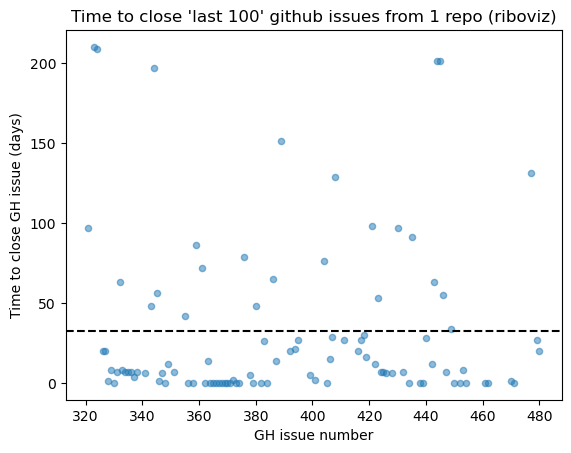

In [52]:
# plot  

closed_issue_df.plot.scatter(x='issue_number', y='close_time', alpha=0.5)
plt.xlabel("GH issue number")
plt.ylabel("Time to close GH issue (days)")
plt.title("Time to close 'last 100' github issues from 1 repo (riboviz)")
plt.axhline(y=np.mean(closed_issue_df.close_time), linestyle='--', color='black')  # add mean line with average close time for this set of issues
plt.show()


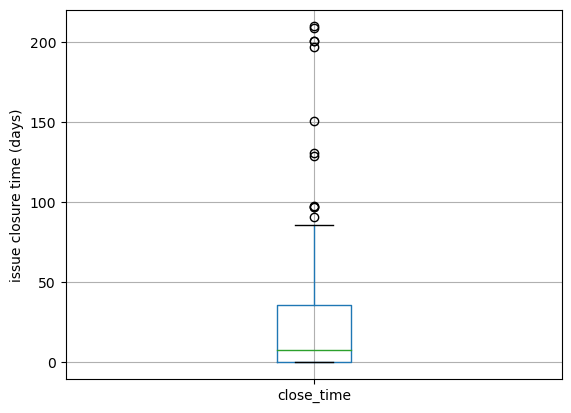

In [53]:
closed_issue_df.boxplot(column='close_time', grid=True) 
plt.ylabel("issue closure time (days)")# could use 'by=column' to groupby() eg. issue labels? 
plt.show()

ISSUE TICKETS TODO:   
 - PLOT times/dates of close time ALL issue tickets for this one repo.  
 - Plot issues with different colours per issue label types? (e.g. 'first issue' vs 'bug' vs other user defined labels?) 
 - Plot close times of assigned issues vs unassigned issues? 
 
 - adapt functions to take repo URL / LIST of repo URLS to be able to analyse more than one repo. 
 
 - create function which pulls data from github repo URL, calcs close times, plots repo issues (make optional) and returns dataframe for further analysis. 
  
 - write function which gets ALL issue ticket information from 1 repo into ONE df (e.g avoids PAGING issues from get_json_repo_issues(), pulls ALL creation/closure info etc, not just the title/ticket number as get_issues() does...)

 - address which issues are PRs (omit these from the issue tic calcs, they're generated separately)    
 - calc time to close PRs? Is this diff from issue timings?   
 
 - is it worth trying to sample amongst issue tickets to reduce run time? there's the DataFrame.sample() function that does this I think?  
 
 
 
 
DEFENSIVE PROGRAMMING TODO:    
 - all of it. :D  
  - Find whether a sample of ROpenSci R package repos on github use assertions?   
   - use of {testthat} package (but test for it as requirement, and then check if it's used and implemented AS INTENDED);   
   - avoidance of require() to import packages  
   - asserts present by some means    
   - message() / custom error messages used,   
   - stop(),   
   - tryCatch(),   
   - ... etc.   
 - Think about other parts of defensive programming I can look for - read more from below.    
 
 
 Reading:  
 [{testthat} R package info](https://testthat.r-lib.org/)
 [Hadley Wickham's Exceptions & Debugging advice from 'Advanced R'](http://adv-r.had.co.nz/Exceptions-Debugging.html)  
 [defensive programming in R](https://www.geeksforgeeks.org/defensive-programming-in-r/)
 [10 rules of defensive programming in R](https://www.r-bloggers.com/2018/07/the-ten-rules-of-defensive-programming-in-r/)